# GATE SIMULATION
###                              data preprocessing
                                                 made by Yangsuseong and Hongyonggi
                                                 
변수 선언 및 실행 함수는 아래 있음.

In [1]:
import os, glob, csv, codecs
import shutil
import re
import itertools
import math
import numpy as np
import matplotlib.pyplot as plt
import tqdm

In [2]:
# 리스트 청크 함수 (리스트, 원하는 길이)
# 이거 하고나면 차원이 하나가 더 생겨서 언패킹함수를 사용하여 차원축소를 해야함
# dat_list.append(list(chunks(dat_list_pre, 3)))
def chunks(l, n):
    n = max(1, n)
    return (l[i:i+n] for i in range(0, len(l), n))

In [3]:
# 차원 축소 함수
# dat_list = list(itertools.chain(*dat_list))
def chain(*iterables):
    # chain('ABC', 'DEF') --> ['A', 'B', 'C', 'D', 'E', 'F']
    for it in iterables:
        for element in it:
            yield element


#실제 데이터를 알맞는 form으로 바꾸는 함수
def make_form(dat_list_xyz, dat_len):
    for i in range(dat_len):
        for j in range(2):
            for k in range(3):
                if(str(dat_list_xyz[i][j][k][-4:]) == "e-06"):
                    dat_list_xyz[i][j][k] = str(float(dat_list_xyz[i][j][k][:-4]) * (10**-6) * 0.1)
                    #print("e-06 complete")
                if(str(dat_list_xyz[i][j][k][-4:]) == "e-05"):
                    dat_list_xyz[i][j][k] = str(float(dat_list_xyz[i][j][k][:-4]) * (10**-5)* 0.1)
                    #print("e-05 complete")
                if(str(dat_list_xyz[i][j][k][-4:]) == "e-04"):
                    dat_list_xyz[i][j][k] = str(float(dat_list_xyz[i][j][k][:-4]) * (10**-4)* 0.1)
                    #print("e-04 complete")
                if(str(dat_list_xyz[i][j][k][-4:]) == "e-03"):
                    dat_list_xyz[i][j][k] = str(float(dat_list_xyz[i][j][k][:-4]) * (10**-3)* 0.1)
                    #print("e-03 complete")
                if(str(dat_list_xyz[i][j][k][-4:]) == "e-02"):
                    dat_list_xyz[i][j][k] = str(float(dat_list_xyz[i][j][k][:-4]) * (10**-2)* 0.1)
                    #print("e-02 complete")
                if(str(dat_list_xyz[i][j][k][-4:]) == "e-01"):
                    dat_list_xyz[i][j][k] = str(float(dat_list_xyz[i][j][k][:-4]) * (10**-1)* 0.1)
                    #print("e-01 complete")
                if(str(dat_list_xyz[i][j][k][-4:]) == "e+00"):
                    dat_list_xyz[i][j][k] = str(float(dat_list_xyz[i][j][k][:-4])* 0.1)
                    #print("e+00 complete")
                if(str(dat_list_xyz[i][j][k][-4:]) == "e+01"):
                    dat_list_xyz[i][j][k] = str(float(dat_list_xyz[i][j][k][:-4]) * (10)* 0.1)
                    #print("e+01 complete")
                if(str(dat_list_xyz[i][j][k][-4:]) == "e+02"):
                    dat_list_xyz[i][j][k] = str(float(dat_list_xyz[i][j][k][:-4]) * (10**2)* 0.1)
                    #print("e+02 complete")
                if(str(dat_list_xyz[i][j][k][-4:]) == "e+03"):
                    dat_list_xyz[i][j][k] = str(float(dat_list_xyz[i][j][k][:-4]) * (10**3)* 0.1)
                    #print("e+03 complete")
    #print("Complete") 
    #print("=================")
    return dat_list_xyz

In [4]:
#실제 데이터를 알맞는 form으로 바꾸는 함수
def make_form(dat_list_xyz, dat_len):
    for i in range(dat_len):
        for j in range(2):
            for k in range(3):
                for l in range(20):
                    if(l < 10):
                        if(str(dat_list_xyz[i][j][k][-4:]) == ("e+0"+str(l))):
                            dat_list_xyz[i][j][k] = str(float(dat_list_xyz[i][j][k][:-4]) * (10 ** int(l)) * 0.1)
                            #print(dat_list_xyz[i][j][k])
                        if(str(dat_list_xyz[i][j][k][-4:]) == ("e-0"+str(l))):
                            dat_list_xyz[i][j][k] = str(float(dat_list_xyz[i][j][k][:-4]) * (10 ** -int(l)) * 0.1)
                    elif(l >= 10):
                        if(str(dat_list_xyz[i][j][k][-4:]) == ("e+"+str(l))):
                            dat_list_xyz[i][j][k] = str(float(dat_list_xyz[i][j][k][:-4]) * (10 ** int(l)) * 0.1)
                        if(str(dat_list_xyz[i][j][k][-4:]) == ("e-"+str(l))):
                            dat_list_xyz[i][j][k] = str(float(dat_list_xyz[i][j][k][:-4]) * (10 ** -int(l)) * 0.1)
                        
                
               
    return dat_list_xyz

In [5]:
# 각 크리스탈의 중심값을 얻어내기위한 함수 (3x3)
# find_xyz_center(디텍터 갯수, 크리스탈의 x축 갯수, 크리스탈의 y축 갯수, 크리스탈의 z축 갯수, 원점으로부터의 거리, 크리스탈의 x축 길이, 크리스탈의 y축 길이, 크리스탈의 z축 길이)
def YSS_find_xyz_center(detector_amount, crystal_x_amount, crystal_y_amount, crystal_z_amount, r, x_len, y_len, z_len):
    crystal_x_num = int((int(crystal_x_amount)/2))
    r = r-(x_len/2)
    
    
    result = []
    for i in range(int(detector_amount)):
        detector = []
        crystal = []
        crystal_z_num = int((int(crystal_z_amount)/2))
        for j in range(int(crystal_z_amount)):
            
            crystal_y_num = int((int(crystal_y_amount)/2))
            for k in range(int(crystal_y_amount)):
                crystal.append([r + (x_len/2), (y_len * crystal_y_num), (z_len * -crystal_z_num)])
                crystal_y_num = crystal_y_num - 1
            crystal_z_num = crystal_z_num - 1
        detector.append(crystal)
        result.append(detector)
    result = list(itertools.chain(*result))
    detector_rot = result
    result = []
    
    detector_num = 0
    for i in range(int(detector_amount)):
        det_rot = []
        for j in range(len(detector_rot[i])):
            det_rot.append([format((detector_rot[i][j][0]*math.cos(((360/detector_amount)*detector_num)*math.pi/180)) - (detector_rot[i][j][1]*math.sin(((360/detector_amount)*detector_num)*math.pi/180)),".3f"),\
                           format((detector_rot[i][j][0]*math.sin(((360/detector_amount)*detector_num)*math.pi/180)) + (detector_rot[i][j][1]*math.cos(((360/detector_amount)*detector_num)*math.pi/180)),".3f"),\
                           format(detector_rot[i][j][2],".3f")])
        detector_num += 1
        result.append(det_rot)
    
            
    
    return result

In [6]:
# 각 디텍터의 중심값을 받아와 크리스탈의 모서리의 좌표를 구하는 함수
def find_crystal_edge(x, y, z, x_len, y_len, z_len):
    x = float(x)
    y = float(y)
    z = float(z)
    x_len = float(x_len)
    y_len = float(y_len)
    z_len = float(z_len)
    edge_a1 = [x-(x_len/2), y+(y_len/2), z-(z_len/2)]
    edge_b1 = [x-(x_len/2), y+(y_len/2), z+(z_len/2)]
    edge_c1 = [x-(x_len/2), y-(y_len/2), z-(z_len/2)]
    edge_d1 = [x-(x_len/2), y-(y_len/2), z+(z_len/2)]
    edge_a2 = [x+(x_len/2), y+(y_len/2), z-(z_len/2)]
    edge_b2 = [x+(x_len/2), y+(y_len/2), z+(z_len/2)]
    edge_c2 = [x+(x_len/2), y-(y_len/2), z-(z_len/2)]
    edge_d2 = [x+(x_len/2), y-(y_len/2), z+(z_len/2)]
    
    
    crystal_edge = [edge_a1, edge_b1, edge_c1, edge_d1, edge_a2, edge_b2, edge_c2, edge_d2]
    #print(crystal_edge)
    return crystal_edge

In [7]:
def rotate_edge(crystal_edge, detector_num):
    rotate_crystal_edge_1 = []
    rad = math.pi/180 
    for i in range(detector_num):
        for j in range(len(crystal_edge)):
            for k in range(len(crystal_edge[j])):
                rotate_crystal_edge_1.append([(crystal_edge[j][k][0]*math.cos((((360/detector_num))*i)*rad)) - (crystal_edge[j][k][1]*math.sin((((360/detector_num))*i)*rad)),\
                                               (crystal_edge[j][k][0]*math.sin((((360/detector_num))*i)*rad)) + (crystal_edge[j][k][1]*math.cos((((360/detector_num))*i)*rad)),\
                                                crystal_edge[j][k][2]])
            
    return rotate_crystal_edge_1

In [8]:
def rotate_edge_yss(x, y, z, angle):
    rotate_crystal_edge_1 = []
    x = float(x)
    y = float(y)
    z = float(z)
    rad = math.pi/180 * angle
    rotate_crystal_edge_1.append([(x*math.cos(rad)) - (y*math.sin(rad)),\
                               (x*math.sin(rad)) + (y*math.cos(rad)),\
                                z])
    return rotate_crystal_edge_1


# 데이터 범위를 디텍터 갯수에 맞게 미리 나누어내는 방법
# find_detector(원본 데이터, 모서리값, 디텍터 갯수)


def find_detector(dat_list, rotate_crystal_edge_chunks):
    detector_number = []
    global det_mat
    det_mat = []
    idx = 0
    
    
    
    # l = coincidence 갯수
    for l in tqdm.tqdm(range(len(dat_list))):
        
        detector_num = []
        sort_data_1 = []
        test=0
        # m = 2 (single 갯수)
        for m in range(len(dat_list[l])):
            # 여기까지 데이터 읽어오기
            
            for i in range(len(rotate_crystal_edge_chunks)):
                # 디텍터 헤드 갯수
                
                x_max = -1000
                x_min = 1000
                y_max = -1000
                y_min = 1000
                z_max = -1000
                z_min = 1000
                for j in range(len(rotate_crystal_edge_chunks[i])):
                    # 크리스탈 갯수
                    for k in range(len(rotate_crystal_edge_chunks[i][j])):
                        # 모서리 갯수
                        if(float(rotate_crystal_edge_chunks[i][j][k][0]) > x_max):
                            x_max = rotate_crystal_edge_chunks[i][j][k][0]
                        if(float(rotate_crystal_edge_chunks[i][j][k][0]) < x_min):
                            x_min = rotate_crystal_edge_chunks[i][j][k][0]
                        if(float(rotate_crystal_edge_chunks[i][j][k][1]) > y_max):
                            y_max = rotate_crystal_edge_chunks[i][j][k][1]
                        if(float(rotate_crystal_edge_chunks[i][j][k][1]) < y_min):
                            y_min = rotate_crystal_edge_chunks[i][j][k][1]
                        if(float(rotate_crystal_edge_chunks[i][j][k][2]) > z_max):
                            z_max = rotate_crystal_edge_chunks[i][j][k][2]
                        if(float(rotate_crystal_edge_chunks[i][j][k][2]) < z_min):
                            z_min = rotate_crystal_edge_chunks[i][j][k][2]
                    else:

                        # 이 범위가 뭔가 이상하다
                        
                        
                        if(float(dat_list[l][m][0])>=x_min and float(dat_list[l][m][0])<x_max):
                            if(float(dat_list[l][m][1])>=y_min and float(dat_list[l][m][1])<y_max):    
                                if(float(dat_list[l][m][2])>=z_min and float(dat_list[l][m][2])<z_max):
                                    idx = i
                                    test += 1
                                    #print(idx)
                                    det_mat.append(idx)
                                    detector_num.append(i)
                                    sort_data_1.append(dat_list[l][m])

                                    #if(i!=test):
                                        #print(i)
                                    break
                                    
        print("test:",test)

        
    # 버려지는 데이터들이 있어서 쌍이 있는 데이터들만 남기겠다.
    # 여기서 엄청많이 버려진다 데이터가....
    # 2019.03.20 --> detector_num 의 갯수가 2개가 아니여서 이상하게 나오는거였다!!
        #if(len(detector_num)==2):
        sort_data.append(sort_data_1)
        detector_number.append(detector_num)

    print("idx:", idx)
    print("detector_number:",len(detector_number))
    return detector_number

In [9]:
# 데이터 범위를 디텍터 갯수에 맞게 미리 나누어내는 방법
# find_detector(원본 데이터, 모서리값, 디텍터 갯수)


def find_detector(dat_list, rotate_crystal_edge_chunks):
    detector_number = []
    global det_mat
    det_mat = []
    
    
    
    # l = coincidence 갯수
    for l in tqdm.tqdm(range(len(dat_list))):
        
        detector_num = []
        sort_data_1 = []
        test=0
        # m = 2 (single 갯수)
        for m in range(len(dat_list[l])):
            # 여기까지 데이터 읽어오기
            
            for i in range(len(rotate_crystal_edge_chunks)):
                # 디텍터 헤드 갯수
                
                x_max = -1000
                x_min = 1000
                y_max = -1000
                y_min = 1000
                z_max = -1000
                z_min = 1000
                for j in range(len(rotate_crystal_edge_chunks[i])):
                    # 크리스탈 갯수
                    for k in range(len(rotate_crystal_edge_chunks[i][j])):
                        # 모서리 갯수
                        if(float(rotate_crystal_edge_chunks[i][j][k][0]) > x_max):
                            x_max = rotate_crystal_edge_chunks[i][j][k][0]
                        if(float(rotate_crystal_edge_chunks[i][j][k][0]) < x_min):
                            x_min = rotate_crystal_edge_chunks[i][j][k][0]
                        if(float(rotate_crystal_edge_chunks[i][j][k][1]) > y_max):
                            y_max = rotate_crystal_edge_chunks[i][j][k][1]
                        if(float(rotate_crystal_edge_chunks[i][j][k][1]) < y_min):
                            y_min = rotate_crystal_edge_chunks[i][j][k][1]
                        if(float(rotate_crystal_edge_chunks[i][j][k][2]) > z_max):
                            z_max = rotate_crystal_edge_chunks[i][j][k][2]
                        if(float(rotate_crystal_edge_chunks[i][j][k][2]) < z_min):
                            z_min = rotate_crystal_edge_chunks[i][j][k][2]
                    else:
                        
                        if(l==0 and m==0):
                            print("=====",i,"=====")
                            print(x_min,"<=x<",x_max)
                            print(y_min,"<=y<",y_max)
                            print(z_min,"<=z<",z_max)
                            print("============")

                        # 이 범위가 뭔가 이상하다
                        
                        
                        if(float(dat_list[l][m][0])>=x_min and float(dat_list[l][m][0])<x_max and float(dat_list[l][m][1])>=y_min and float(dat_list[l][m][1])<y_max and float(dat_list[l][m][2])>=z_min and float(dat_list[l][m][2])<z_max):
                            
                            test += 1
                            detector_num.append(i)
                            sort_data_1.append(dat_list[l][m])

                            #if(i!=test):
                                #print(i)
                            break
                                    
    #    print("test:",test)

        
    # 버려지는 데이터들이 있어서 쌍이 있는 데이터들만 남기겠다.
    # 여기서 엄청많이 버려진다 데이터가....
    # 2019.03.20 --> detector_num 의 갯수가 2개가 아니여서 이상하게 나오는거였다!!
        #if(len(detector_num)==2):
        sort_data.append(sort_data_1)
        detector_number.append(detector_num)

    
    print("detector_number:",len(detector_number))
    return detector_number

In [10]:
# 정렬된 데이터와 디텍터 번호를 받아와 티텍터의 회전각만큼 회전변환을 통해 중심값으로 변경시키는 함수
# rotate_detector(정렬된 데이터, 디텍터 번호가 적힌 리스트, 디텍터 갯수)
def rotate_detector(sort_dat, detector_number_list, detector_num):
    a = 0
    b = 0
    c = 0
    global t_data
    global w_data
    t_data = []
    w_data = []
    
    final_dat = []
    angle = float(360/int(detector_num))
    print("angle:",angle)
    for idx,detector_n in enumerate(detector_number_list):
        #print(detector_n)
        #print(idx)
        # 먼저 x축과 평행한 디텍터로 옮기는 작업(회전변환)
        
        #data = rotate_edge_yss(sort_dat[idx][0],sort_dat[idx][1],sort_dat[idx][2],detector_num-(angle*float(detector_n)))
        data = rotate_edge_yss(sort_dat[idx][0],sort_dat[idx][1],sort_dat[idx][2],-(angle*detector_n))
        #print(data)
        #if(idx % 100 == 0):
            #print(idx)
            #print(data)
        #for j in range(len(sort_dat)):
            # 데이터를 읽은 후에 xyz범위를 찾아야지
        for i in range(len(origin_crystal_edge)):
            
            x_min = float(origin_crystal_edge[i][0][0])
            x_max = float(origin_crystal_edge[i][4][0])
            y_min = float(origin_crystal_edge[i][2][1])
            y_max = float(origin_crystal_edge[i][0][1])
            z_min = float(origin_crystal_edge[i][2][2])
            z_max = float(origin_crystal_edge[i][3][2])
            
            if(c == 0):
                print("=====",i,"=====")
                print(x_min,"<=x<",x_max)
                print(y_min,"<=y<",y_max)
                print(z_min,"<=z<",z_max)
                print("============")
            

            if(float(data[0][0])>=x_min and float(data[0][0])<x_max):
                if(float(data[0][1])>=y_min and float(data[0][1])<y_max):
                    if(float(data[0][2])>=z_min and float(data[0][2])<z_max):
                        after_data = rotate_edge_yss(crystal_location[0][i][0],crystal_location[0][i][1],crystal_location[0][i][2],angle*detector_n)
        
           
                        a = a+1
                        final_dat.append(after_data)
                        t_data.append([detector_n,data])
                    else:
                        b += 1
                        w_data.append([detector_n,data])
                else:
                    b += 1
                    w_data.append([detector_n,data])
            else:
                b += 1
                w_data.append([detector_n,data])
                
        c = c+1
    print("전체 데이터:",len(sort_dat))
    print("범위 내의 값:",a)                    
    print("범위 밖의 값:",b)
    print("=================")

    return final_dat
                

In [11]:
def start_preprocessing(detector_head_num, crystal_x_num, crystal_y_num, crystal_z_num, zero_to_head_len, crystal_x_len, crystal_y_len, crystal_z_len):
    dat_list_all = []
    dat_list_pre = []
    dat_list = []
    dat_list_xyz_1 = []
    global sort_data
    global detector_num
    global origin_crystal_edge
    global crystal_location


    #print("--------------" + dat_file_list[i]) + "----------------")
    print(str(len(dat_file_list)) + "개의 파일을 변환합니다.")
    for i in range(len(dat_file_list)):
        idx = 0
        print(str(i+1) + "번째 파일")
        txt_data = open(dat_dir+dat_file_list[i],'r')
        for j in txt_data:
            j = " ".join(j.split())
            j = j.split(" ")
            dat_list_all.append(j)
            #print(dat_list_all)

    print("=================")
    
    dat_len = len(dat_list_all) - 1
    
    for i in range(len(dat_list_all) -1):
        #print(i)
        dat_list_pre.append(dat_list_all[i][8])
        dat_list_pre.append(dat_list_all[i][9])
        dat_list_pre.append(dat_list_all[i][10])
        dat_list_pre.append(dat_list_all[i][31])
        dat_list_pre.append(dat_list_all[i][32])
        dat_list_pre.append(dat_list_all[i][33])

    dat_list.append(list(chunks(dat_list_pre, 3)))
    dat_list = list(itertools.chain(*dat_list))
    dat_list_xyz_1.append(list(chunks(dat_list,2)))
    dat_list_xyz_1 = list(itertools.chain(*dat_list_xyz_1))

    print("좌표 가져오기 완료!")
    print("=================")
    txt_data.close()
    
    # 실제 데이터를 form에 맞게 수정
    global dat_list_xyz
    dat_list_xyz = make_form(dat_list_xyz_1, dat_len)
    
    #print(dat_list_xyz)
    
    # 각 크리스탈의 중심값 찾기 (detector_num, crystal_x_amount, crystal_y_amount, crystal_z_amount, r길이(원점으로부터 헤드까지 거리), 크리스탈의 x_len(cm), y_len(cm), z_len(cm))

    crystal_location = YSS_find_xyz_center(detector_head_num, crystal_x_num, crystal_y_num, crystal_z_num, zero_to_head_len, crystal_x_len, crystal_y_len, crystal_z_len)
    print("0번 디텍터 크리스탈 중심값:",crystal_location[0])
    print("중간지점 디텍터 인덱스:",int(detector_head_num)/2)
    print("중간지점 디텍터 중심값:", crystal_location[int(detector_head_num/2)])
    # 각 크리스탈의 모서리 값 구하기
    origin_crystal_edge = []
    for j in range(len(crystal_location[0])):
        # find_crystal_edge(크리스탈 중점 x좌표, 크리스탈 중점 y좌표, 크리스탈 중점 z좌표, 크리스탈의 x_len, y_len z_len)
        origin_crystal_edge.append(find_crystal_edge(crystal_location[0][j][0],\
                              crystal_location[0][j][1],\
                              crystal_location[0][j][2],\
                              crystal_x_len, crystal_y_len, crystal_z_len))  
    
    # 모서리 회전변환
    # rotate_edge(0번 디텍터 크리스탈 엣지, 디텍터 헤드 갯수)
    rotate_crystal_edge = rotate_edge(origin_crystal_edge, detector_head_num)

    # 모서리 좌표 리스트를 차원을 늘려서 디텍터별로 나누자
    rotate_crystal_edge_chunks_1 = []
    global rotate_crystal_edge_chunks
    rotate_crystal_edge_chunks = []
    rotate_crystal_edge_chunks_1.append(list(chunks(rotate_crystal_edge, 8)))
    rotate_crystal_edge_chunks_1 = list(itertools.chain(*rotate_crystal_edge_chunks_1))
    rotate_crystal_edge_chunks.append(list(chunks(rotate_crystal_edge_chunks_1, crystal_x_num*crystal_y_num*crystal_z_num)))
    rotate_crystal_edge_chunks = list(itertools.chain(*rotate_crystal_edge_chunks))
    
    # 함수 실행
    global sort_data
    sort_data = []
    global detector_number
    global detector_num
    # find_detector(원본 데이터, 각 크리스탈의 모서리값)
    detector_number = find_detector(dat_list_xyz, rotate_crystal_edge_chunks)
    #detector_number = list(itertools.chain(*detector_number))
    #sort_data = list(itertools.chain(*sort_data)
    
    # 차원 축소 작업
    detector_num = detector_number
    detector_num = list(itertools.chain(*detector_num))
    sort_dat = sort_data
    sort_dat = list(itertools.chain(*sort_dat))
    #sort_dat = list(itertools.chain(*sort_dat))
    
    # ============================================
    print("sort_dat_len:",len(sort_dat))
    print("detector_num_len:",len(detector_num))
    # ============================================
    
    # 함수 돌리기
    # rotate_detector(차원이 변경된 원본데이터, 각 coincidence가 감지된 디텍터 헤드 번호, 디텍터 헤드 갯수)
    final_output = rotate_detector(sort_dat, detector_num, detector_head_num)
    #print(final_output)
    # 차원 축소 작업
    final_data = final_output

    final_data = list(itertools.chain(*final_data))

    final_dat = []
    for i in range(len(final_data)):
        final_dat.append([float(final_data[i][0]), float(final_data[i][1]), float(final_data[i][2])])

    final_data_1=[]
    final_data_1.append(list(chunks(final_dat, 2)))
    final_data_1 = list(itertools.chain(*final_data_1))
    
    print("preprocessing complete!")
    
    return final_data_1

## R Phi Theta를 구하는 함수 


In [12]:
def cal_angle (det1,det2):
    
    det_x1 = det1[0]
    det_y1 = det1[1]
    det_z1 = det1[2]
    det_x2 = det2[0]
    det_y2 = det2[1]
    det_z2 = det2[2]
    det_x1 = float(det_x1)
    det_y1 = float(det_y1)
    det_z1 = float(det_z1)
    det_x2 = float(det_x2)
    det_y2 = float(det_y2)
    det_z2 = float(det_z2)
    a = det_x1 - det_x2
    b = det_y1 - det_y2
    c = det_x2 - det_x1
    d = det_y2 - det_y1
    distance = float(zero_to_head_len + crystal_x_len/2 ) *2  #  float(zero_to_head_len + crystal_x_len/2 )  디텍터 반지름
    theta = math.atan( ( det_z1 - det_z2 )/ distance)
    
    if b == 0 :
        phi = 90*math.pi/180
        radius = det_y1
        
    elif d == 0:
        phi = 90*math.pi/180
        radius = det_y1
        
    else:
        phi = math.atan(- a / b)
        
        if a == 0:
            phi = 0
            radius = det_x1
        else:
            radius = -(b / a) * det_x1 * math.sin(phi) + det_y1 * math.sin(phi)
    
    result = [radius, phi, theta]
    return  result

## def Phi_ angle : angle_flag가 True 이면 degree로 sinogram 

## final_data_1 데이터를 받아 R, Theta, Phi 로 바꾼 Numpy리스트 : numpyrecord를 만듬

## Theta 구하는 공식 적용해서 indirect plane과 direct plane 합치기

In [35]:


def drawSinogram (size_x = 91, size_y = 180):
    final_data_2=np.array(final_data_1)
    record = []
    record1 = []
    for i in range(0,len(final_data_1)-1):
        record.append(cal_angle(final_data_2[i][0],final_data_2[i][1]))
    numpyrecord = np.array(record)
    #앞에서 정의하였던 cal_angle 함수를 이용하여 record 함수를 만든다.
    
    Theta = math.atan(crystal_z_len/( float(zero_to_head_len + crystal_x_len/2 ) *2))
    # Theta 범위를 지정해주기 위한 값 
    # indirect plane 값
    
    for i in range (0,len(numpyrecord)):
        if (numpyrecord[:][i][2]>= -Theta) or (numpyrecord[:][i][2]<= Theta):
            record1.append(numpyrecord[:][i][:])
    # Theta 범위 안에 있는 값들만 뽑아서 record1에 더해주었다.
    
    
    Phi = [] # R Phi Theta 값 중에서 Phi 값 만을 뽑기 위해 만든 리스트
    Phi_degree = []
    Phi_degree1 = []
    Phi_degree2 = []
    R = []  #R Phi Theta 값 중에서 R 값 만을 뽑기 위해 만든 리스트
    
    for i in range(0,len(record1)):
        Phi.append(record1[:][i][1])
        
    for i in range(0,len(record1)):
        R.append(record1[:][i][0])
    R1 = np.array(R) 
    R2 = (R1+float(zero_to_head_len +crystal_x_len/2)) # 음수 값을 없애주기 위해서 반지름을 더함
    R3 = np.array(R2)   
    R4 = (R1*(-1)+float(zero_to_head_len +crystal_x_len/2))   
   
    
   
    for j in range (0,len(record1)):
        Phi_degree.append(math.degrees(Phi[j]))
    Phi_degrees = np.array(Phi_degree)
    Phi_degrees[Phi_degrees < 0 ] = Phi_degrees[Phi_degrees < 0 ] + 180 # 음수인 각도들을 180도를 더해줘서 바꿔준다.
    for i in range(0,len(Phi_degrees)):
        Phi_degree1.append(round(Phi_degrees[i]))
    Phi_degree2 = np.array(Phi_degree1)
    Phi_degree3 = Phi_degree2 
        
    for i in range(0,len(R2)):
        if (Phi_degree1[i]> 90 ):
            R3[i] = R4[i]
        
    trans_degree = size_y *Phi_degree3/180
    trans_radius = size_x *R3/int(( float(zero_to_head_len + crystal_x_len/2 ) *2))
    
    
    image = np.zeros((size_x,size_y),dtype =np.float64) 
        # Sinogram 이미지를 만들기위해서 빈 이미지를 만들어준다.
        
    for i in range(0, len(trans_degree)):
            image[int(trans_radius[i])-1][int(trans_degree[i])-1] = image[int(trans_radius[i])-1][int(trans_degree[i]) - 1] + 1
        # image를 Phi_degree1의 값과 R2의 값에 따라 픽셀의 값을 올려준다, 
        
    image1 = image.T   
    
       
    fig, (ax1) = plt.subplots(1, 1, figsize = (16,16))
    ax1.set_title("Sinogram")
    ax1.set_xlabel("Projection position ")
    ax1.set_ylabel("Projection angle ( deg)")
    plt.imshow(image1, cmap=plt.cm.Greys_r )
    
    print("image 모양")
    print(image.shape)
    print("coincidence 개수")
    print(trans_degree.shape)
    print(trans_radius.shape)
    print("trans_degree 최대 최소값")
    print(trans_degree.max())
    print(trans_degree.min())
    print("trans_radius 최대 최소값")
    print(trans_radius.max())
    print(trans_radius.min())

---

---

---

---

---

# 실행 부분
## 변수 값만 변경할것
## 데이터 경로 설정에서 각 파일 명에 대한 슬라이싱 범위 체크할것

In [24]:
import glob
# 데이터 경로 설정
dat_dir = "./data/"
dat_file_list = glob.glob(dat_dir + '/*.dat')
dat_file_list.sort()
print(dat_file_list)
print(dat_file_list[15][-34:])

# 파일명 슬라이싱
dat_file_list = [dat_file_list[15][-34:]]

['./data/gate_data_0000_2019.03.18_0001.dat', './data/gate_data_0000_2019.03.18_0002.dat', './data/gate_data_0001_2019.03.18_0001.dat', './data/gate_data_0001_2019.03.18_0002.dat', './data/gate_data_0001_2019.03.18_0003.dat', './data/gate_data_0001_2019.03.18_0004.dat', './data/gate_data_0001_2019.03.18_0005.dat', './data/gate_data_0001_2019.03.18_0006.dat', './data/gate_data_0001_2019.03.18_0007.dat', './data/gate_data_0001_2019.03.18_0008.dat', './data/gate_data_2019.03.11_0001.dat', './data/gate_data_2019.03.11_0002.dat', './data/gate_data_2019.03.11_0003.dat', './data/gate_data_2019.03.11_0004.dat', './data/gate_data_test_2019.03.20_0001.dat', './data/gate_data_test_2019.03.20_0002.dat']
gate_data_test_2019.03.20_0002.dat


In [25]:
# 변수 정의

#디텍터 헤드 갯수
detector_head_num =  64

# 크리스탈 각 축의 갯수
ctystal_x_num = 1
ctystal_y_num = 1
ctystal_z_num = 1

# 단위 = cm
zero_to_head_len = 7
crystal_x_len = 3
crystal_y_len = 0.2
crystal_z_len = 1.8



In [26]:
final_data_1 =start_preprocessing(detector_head_num, ctystal_x_num, ctystal_y_num, ctystal_z_num, zero_to_head_len, crystal_x_len, crystal_y_len, crystal_z_len)


        
    

1개의 파일을 변환합니다.
1번째 파일
좌표 가져오기 완료!


  0%|          | 102/27918 [00:00<01:00, 462.93it/s]

0번 디텍터 크리스탈 중심값: [['7.000', '0.000', '0.000']]
중간지점 디텍터 인덱스: 32.0
중간지점 디텍터 중심값: [['-7.000', '0.000', '0.000']]
===== 0 =====
5.5 <=x< 8.5
-0.1 <=y< 0.1
-0.9 <=z< 0.9
===== 1 =====
5.463714282664127 <=x< 8.46887189074663
0.4395757991453636 <=y< 0.9326641654684849
-0.9 <=z< 0.9
===== 2 =====
5.374810010016154 <=x< 8.356183915629073
0.9749182430483824 <=y< 1.7563462651774133
-0.9 <=z< 0.9
===== 3 =====
5.234143378801702 <=x< 8.163021321449222
1.500871691326322 <=y< 2.5631137902361507
-0.9 <=z< 0.9
===== 4 =====
5.043069085575568 <=x< 7.891244369582446
2.012370924756865 <=y< 3.3451971283543918
-0.9 <=z< 0.9
===== 5 =====
4.803427280233353 <=x< 7.543470420643618
2.504489926108152 <=y< 4.095064389455815
-0.9 <=z< 0.9
===== 6 =====
4.517525844362039 <=x< 7.123048727873595
2.9724893203775573 <=y< 4.805493941896873
-0.9 <=z< 0.9
===== 7 =====
4.18811816507869 <=x< 6.6340281819996285
3.4118620175637764 <=y< 5.46964396072726
-0.9 <=z< 0.9
===== 8 =====
3.818376618407357 <=x< 6.081118318204309
3.8

100%|██████████| 27918/27918 [00:52<00:00, 534.52it/s]


detector_number: 27918
sort_dat_len: 104396
detector_num_len: 104396
angle: 5.625
===== 0 =====
5.5 <=x< 8.5
-0.1 <=y< 0.1
-0.9 <=z< 0.9
전체 데이터: 104396
범위 내의 값: 55795
범위 밖의 값: 48601
preprocessing complete!


# detector_number 를 구하는 과정에서 오류가 발생하는것으로 예상됨.
# sort_dat 과 detector_num 의 매칭이 잘 이루어 지지 않음

In [32]:
len(detector_number)

27918

In [33]:
len(sort_data)

27918

#  #1 세팅에서 매칭이 잘 되고있는지 확인해보자

In [29]:
test_1 = []
for i in range(len(sort_data)):
    for j in range(len(sort_data[i])):
        test_1.append([detector_number[i][j], sort_data[i][j]])

In [30]:
test_1[2][1]

['3.8420000000000005', '-4.627', '-0.0020410000000000003']

In [31]:
a = 0
b = 0
for i in range(len(test_1)):
    test_data = rotate_edge_yss(test_1[i][1][0], test_1[i][1][1], test_1[i][1][2],-(2.8125*test_1[i][0]))
    
    if(float(test_data[0][0])>=5.5 and float(test_data[0][0])<8.5):
        if(float(test_data[0][1])>=-0.1 and float(test_data[0][1])<0.1):
            if(float(test_data[0][2])>=-0.9 and float(test_data[0][2])<0.9):
                
                a += 1
            else:
                print("=======================")
                print("original:",test_1[i])
                print("after:",test_data)
                print("=======================")
                b += 1
        else:
            print("=======================")
            print("original:",test_1[i])
            print("after:",test_data)
            print("=======================")
            b+=1
    else:
        print("=======================")
        print("original:",test_1[i])
        print("after:",test_data)
        print("=======================")
        b+=1
        
print("범위 내의 값:",a)
print("범위 밖의 값:",b)
        
        

original: [13, ['1.596', '8.111000000000002', '-3.024000000000004e-20']]
after: [[6.113636278981238, 5.564080197869589, -3.024000000000004e-20]]
original: [14, ['1.596', '8.111000000000002', '-3.024000000000004e-20']]
after: [[6.379288611418258, 5.257396105699983, -3.024000000000004e-20]]
original: [54, ['3.8420000000000005', '-4.627', '-0.0020410000000000003']]
after: [[-5.569494198920272, 2.269543427254354, -0.0020410000000000003]]
original: [55, ['3.8420000000000005', '-4.627', '-0.0020410000000000003']]
after: [[-5.4514242814821845, 2.5400917903230282, -0.0020410000000000003]]
original: [56, ['3.8420000000000005', '-4.627', '-0.0020410000000000003']]
after: [[-5.320221405461635, 2.8045208497830485, -0.0020410000000000003]]
original: [30, ['-5.713000000000001', '1.215', '-3.231000000000003e-20']]
after: [[0.6491775202039398, 5.804581168978679, -3.231000000000003e-20]]
original: [63, ['7.993000000000001', '-0.7229000000000001', '0.12090000000000001']]
after: [[-8.018843103219234, 0.3

after: [[-6.152853810100716, 1.439772201262795, 1.3580000000000017e-20]]
original: [51, ['2.397', '-5.654', '-0.31120000000000003']]
after: [[-5.293372320559325, 3.113444150123203, -0.31120000000000003]]
original: [52, ['2.397', '-5.654', '-0.31120000000000003']]
after: [[-5.134226758182032, 3.3694273394106053, -0.31120000000000003]]
original: [9, ['3.473', '4.321', '1.5970000000000016e-20']]
after: [[4.987020373729967, 2.421238896103029, 1.5970000000000016e-20]]
original: [61, ['7.904', '-1.6030000000000002', '-0.01353']]
after: [[-8.053660085313574, 0.4258922753783645, -0.01353]]
original: [62, ['7.904', '-1.6030000000000002', '-0.01353']]
after: [[-8.023061555565329, 0.8205536396906828, -0.01353]]
original: [27, ['-5.007', '2.639', '3.097000000000004e-20']]
after: [[1.3433107164047584, 5.498171179509795, 3.097000000000004e-20]]
original: [22, ['-4.663', '4.688', '-3.3000000000000036e-20']]
after: [[1.9363239034454618, 6.322306757896657, -3.3000000000000036e-20]]
original: [23, ['-4.

original: [53, ['3.861', '-5.9', '2.1900000000000017e-20']]
after: [[-6.344896353951059, 3.0756481036715755, 2.1900000000000017e-20]]
original: [54, ['3.861', '-5.9', '2.1900000000000017e-20']]
after: [[-6.186338748922386, 3.3832726587701165, 2.1900000000000017e-20]]
original: [55, ['3.861', '-5.9', '2.1900000000000017e-20']]
after: [[-6.0128777119882795, 3.682746613693997, 2.1900000000000017e-20]]
original: [56, ['3.861', '-5.9', '2.1900000000000017e-20']]
after: [[-5.824931125980109, 3.9733485094549796, 2.1900000000000017e-20]]
original: [39, ['-4.404', '-5.297000000000001', '-0.3951']]
after: [[-3.5036959989351253, 5.931065616484613, -0.3951]]
original: [40, ['-4.404', '-5.297000000000001', '-0.3951']]
after: [[-3.208452047576431, 6.095839602417588, -0.3951]]
original: [41, ['-4.404', '-5.297000000000001', '-0.3951']]
after: [[-2.905478654207919, 6.245928176815848, -0.3951]]
original: [42, ['-4.404', '-5.297000000000001', '-0.3951']]
after: [[-2.5955057082715434, 6.380969763157466, 

original: [6, ['5.485', '3.668', '-1.627000000000002e-20']]
after: [[6.313581937660534, 1.917845696725016, -1.627000000000002e-20]]
original: [7, ['5.485', '3.668', '-1.627000000000002e-20']]
after: [[6.400081179771533, 1.6057427852349935, -1.627000000000002e-20]]
original: [45, ['-2.478', '-8.085', '3.587000000000003e-20']]
after: [[-5.017790015488766, 6.806577139830363, 3.587000000000003e-20]]
original: [5, ['5.546', '3.641', '-1.6320000000000022e-20']]
after: [[6.264484165244725, 2.184315715137833, -1.6320000000000022e-20]]
original: [6, ['5.546', '3.641', '-1.6320000000000022e-20']]
after: [[6.3641176118543274, 1.8743009423477244, -1.6320000000000022e-20]]
original: [7, ['5.546', '3.641', '-1.6320000000000022e-20']]
after: [[6.448419341706106, 1.5597708144181264, -1.6320000000000022e-20]]
original: [44, ['-2.203', '-7.441', '3.3350000000000024e-20']]
after: [[-4.963044161801054, 5.965725659801367, 3.3350000000000024e-20]]
original: [45, ['-2.203', '-7.441', '3.3350000000000024e-20'

after: [[-6.075282723677745, 2.1327423255946143, -0.020950000000000003]]
original: [18, ['-1.375', '6.575', '2.901000000000004e-20']]
after: [[4.210252965134983, 5.234025216749733, 2.901000000000004e-20]]
original: [17, ['-0.5938', '6.174', '-2.6240000000000024e-20']]
after: [[4.175860540553359, 4.586181765461267, -2.6240000000000024e-20]]
original: [56, ['5.675000000000001', '-4.595', '1.9530000000000013e-20']]
after: [[-7.001446718719141, 2.0734979732174765, 1.9530000000000013e-20]]
original: [57, ['5.675000000000001', '-4.595', '1.9530000000000013e-20']]
after: [[-6.891271446250894, 2.414545061515132, 1.9530000000000013e-20]]
original: [58, ['5.675000000000001', '-4.595', '1.9530000000000013e-20']]
after: [[-6.76449449726454, 2.749775299270425, 1.9530000000000013e-20]]
original: [16, ['0.06367', '8.223', '-3.207000000000002e-20']]
after: [[5.859560550455127, 5.769517572938835, -3.207000000000002e-20]]
original: [57, ['4.297', '-3.632', '1.416000000000001e-20']]
after: [[-5.269398795

original: [1, ['5.873000000000001', '0.5956', '-1.0780000000000008e-20']]
after: [[5.895150421122389, 0.30670812239087464, -1.0780000000000008e-20]]
original: [35, ['-5.727', '-1.8100000000000003', '-0.02171']]
after: [[-0.9500840558303977, 5.930596031332506, -0.02171]]
original: [50, ['1.574', '-7.456', '-0.12470000000000002']]
after: [[-5.9467547803170895, 4.7650309109989895, -0.12470000000000002]]
original: [51, ['1.574', '-7.456', '-0.12470000000000002']]
after: [[-5.705782668846119, 5.051084649448598, -0.12470000000000002]]
original: [8, ['3.9590000000000005', '4.897', '1.833000000000002e-20']]
after: [[5.531639837504029, 3.009194361974381, 1.833000000000002e-20]]
original: [9, ['3.9590000000000005', '4.897', '1.833000000000002e-20']]
after: [[5.672630904003804, 2.734144953535015, 1.833000000000002e-20]]
original: [10, ['3.9590000000000005', '4.897', '1.833000000000002e-20']]
after: [[5.799956105792049, 2.4525087504197702, 1.833000000000002e-20]]
original: [11, ['3.959000000000000

after: [[7.097334776458859, 1.0891281241744204, 1.6770000000000016e-20]]
original: [52, ['2.912', '-5.405000000000001', '0.09365000000000001']]
after: [[-5.424096620495963, 2.8762727359421776, 0.09365000000000001]]
original: [53, ['2.912', '-5.405000000000001', '0.09365000000000001']]
after: [[-5.276431044685156, 3.1389559459608094, 0.09365000000000001]]
original: [10, ['3.2430000000000003', '6.031', '2.2170000000000023e-20']]
after: [[5.703064380079308, 3.7901275277582185, 2.2170000000000023e-20]]
original: [11, ['3.2430000000000003', '6.031', '2.2170000000000023e-20']]
after: [[5.882167532460203, 3.505726047493022, 2.2170000000000023e-20]]
original: [12, ['3.2430000000000003', '6.031', '2.2170000000000023e-20']]
after: [[6.0471000280383755, 3.21287896611408, 2.2170000000000023e-20]]
original: [59, ['5.285', '-2.828', '-0.025660000000000002']]
after: [[-5.813763121899596, 1.4590981332454196, -0.025660000000000002]]
original: [60, ['5.285', '-2.828', '-0.025660000000000002']]
after: [[

original: [8, ['4.361', '5.4190000000000005', '-0.1936']]
after: [[6.102800161268142, 3.3376207381345067, -0.1936]]
original: [9, ['4.361', '5.4190000000000005', '-0.1936']]
after: [[6.259218358610035, 3.03415021698648, -0.1936]]
original: [10, ['4.361', '5.4190000000000005', '-0.1936']]
after: [[6.400557550683258, 2.7233701622055606, -0.1936]]
original: [60, ['5.125', '-2.131', '0.1925']]
after: [[-5.442262038282926, 1.090215532206627, 0.1925]]
original: [19, ['-2.134', '5.261', '2.700000000000003e-20']]
after: [[2.954452507332821, 4.848018913114388, 2.700000000000003e-20]]
original: [20, ['-2.134', '5.261', '2.700000000000003e-20']]
after: [[3.1887747530598594, 4.697211148569759, 2.700000000000003e-20]]
original: [62, ['7.065000000000001', '-1.375', '-1.5760000000000013e-20']]
after: [[-7.165753661892218, 0.6758879027459231, -1.5760000000000013e-20]]
original: [27, ['-5.501000000000001', '2.875', '3.296000000000001e-20']]
after: [[1.4522058832864586, 6.0347099410450715, 3.29600000000

after: [[-5.574906791413049, 3.618244915294798, 0.07637000000000001]]
original: [37, ['-6.800000000000001', '-3.665', '-3.8430000000000014e-20']]
after: [[-1.9028993196158095, 7.486734881068362, -3.8430000000000014e-20]]
original: [38, ['-6.800000000000001', '-3.665', '-3.8430000000000014e-20']]
after: [[-1.533250525128201, 7.5710876251166255, -3.8430000000000014e-20]]
original: [2, ['6.944', '1.475', '1.5470000000000012e-20']]
after: [[7.055138023997837, 0.7872664493930217, 1.5470000000000012e-20]]
original: [24, ['-4.132', '4.054000000000001', '-3.013000000000003e-20']]
after: [[2.164159682268206, 5.368868863144711, -3.013000000000003e-20]]
original: [61, ['6.22', '-1.83', '1.3610000000000014e-20']]
after: [[-6.42119466023425, 0.8975294621231988, 1.3610000000000014e-20]]
original: [58, ['4.819', '-3.2030000000000003', '0.08547000000000002']]
after: [[-5.541277299139558, 1.6661980356610107, 0.08547000000000002]]
original: [59, ['4.819', '-3.2030000000000003', '0.08547000000000002']]
a

original: [41, ['-4.63', '-4.53', '3.259000000000001e-20']]
after: [[-2.115491415266994, 6.12229500040072, 3.259000000000001e-20]]
original: [42, ['-4.63', '-4.53', '3.259000000000001e-20']]
after: [[-1.812536435993679, 6.218722671754653, 3.259000000000001e-20]]
original: [8, ['4.718', '5.805', '-0.07791000000000002']]
after: [[6.5803409592675965, 3.557620252329526, -0.07791000000000002]]
original: [9, ['4.718', '5.805', '-0.07791000000000002']]
after: [[6.746978802319193, 3.2304529157775175, -0.07791000000000002]]
original: [10, ['4.718', '5.805', '-0.07791000000000002']]
after: [[6.897362582470455, 2.8955031351971443, -0.07791000000000002]]
original: [49, ['0.7943', '-7.463', '2.859000000000005e-20']]
after: [[-5.6003819588927435, 4.996298970689072, 2.859000000000005e-20]]
original: [9, ['3.654', '4.329', '-1.6080000000000016e-20']]
after: [[5.154062876532753, 2.3510833385371352, -1.6080000000000016e-20]]
original: [51, ['2.0210000000000004', '-6.481000000000001', '2.4080000000000016

original: [20, ['-2.394', '5.91', '2.939000000000002e-20']]
after: [[3.583950270859115, 5.273958328998143, 2.939000000000002e-20]]
original: [1, ['5.504', '0.5147', '-9.390000000000004e-20']]
after: [[5.52262532292959, 0.2440115418106935, -9.390000000000004e-20]]
original: [35, ['-5.322', '-1.711', '3.121000000000004e-20']]
after: [[-0.9115814234983057, 5.515453227825689, 3.121000000000004e-20]]
original: [19, ['-2.137', '7.119', '-3.225000000000002e-20']]
after: [[4.4450250029103815, 5.957237843455772, -3.225000000000002e-20]]
original: [20, ['-2.137', '7.119', '-3.225000000000002e-20']]
after: [[4.73197858201893, 5.7319550503570875, -3.225000000000002e-20]]
original: [59, ['4.924', '-2.667', '1.2080000000000024e-20']]
after: [[-5.424462030531941, 1.3906389464261761, 1.2080000000000024e-20]]
original: [47, ['-0.718', '-7.798000000000001', '-3.1730000000000027e-20']]
after: [[-5.2957575459378115, 5.768819637901911, -3.1730000000000027e-20]]
original: [7, ['5.606000000000001', '5.465', 

after: [[3.3893486668357817, 5.180010387501024, -0.06927]]
original: [58, ['6.318', '-3.29', '0.2988']]
after: [[-7.000985629323276, 1.314315113665274, 0.2988]]
original: [59, ['6.318', '-3.29', '0.2988']]
after: [[-6.928062249564867, 1.6562540463812272, 0.2988]]
original: [60, ['6.318', '-3.29', '0.2988']]
after: [[-6.838448561020671, 1.9942029180287304, 0.2988]]
original: [10, ['3.251', '6.075', '-0.05556']]
after: [[5.730861206614438, 3.8251608894949394, -0.05556]]
original: [11, ['3.251', '6.075', '-0.05556']]
after: [[5.911649882084706, 3.539353284379489, -0.05556]]
original: [12, ['3.251', '6.075', '-0.05556']]
after: [[6.078196875189658, 3.2450190671912362, -0.05556]]
original: [52, ['2.7780000000000005', '-5.324', '1.9570000000000015e-20']]
after: [[-5.267678503572833, 2.8833701085702965, 1.9570000000000015e-20]]
original: [53, ['2.7780000000000005', '-5.324', '1.9570000000000015e-20']]
after: [[-5.119853088665469, 3.1383696962726777, 1.9570000000000015e-20]]
original: [56, ['5

original: [37, ['-5.296', '-2.799', '0.2519']]
after: [[-1.4282944449238428, 5.8173870404675405, 0.2519]]
original: [7, ['5.941', '4.981000000000001', '-0.5123000000000001']]
after: [[7.271761650998974, 2.688368369673448, -0.5123000000000001]]
original: [8, ['5.941', '4.981000000000001', '-0.5123000000000001']]
after: [[7.394914479260067, 2.328321679757722, -0.5123000000000001]]
original: [45, ['-1.602', '-8.036', '3.401000000000004e-20']]
after: [[-5.500265437181584, 6.073778076333188, 3.401000000000004e-20]]
original: [46, ['-1.602', '-8.036', '3.401000000000004e-20']]
after: [[-5.1956139619927955, 6.336347177826159, 3.401000000000004e-20]]
original: [4, ['6.715000000000001', '2.879', '0.06443']]
after: [[7.147638194992126, 1.513649309942599, 0.06443]]
original: [5, ['6.715000000000001', '2.879', '0.06443']]
after: [[7.21329980314286, 1.1611080698966751, 0.06443]]
original: [42, ['-3.2670000000000003', '-4.86', '2.9130000000000037e-20']]
after: [[-2.7460842055224712, 5.17222491160042

original: [38, ['-6.505', '-4.43', '-0.15600000000000003']]
after: [[-2.350943861753407, 7.510858004175287, -0.15600000000000003]]
original: [39, ['-6.505', '-4.43', '-0.15600000000000003']]
after: [[-1.979571712444391, 7.617166194543085, -0.15600000000000003]]
original: [2, ['5.473', '1.165', '1.004000000000001e-20']]
after: [[5.560835977560871, 0.6229423975494243, 1.004000000000001e-20]]
original: [46, ['-1.2720000000000002', '-6.542000000000001', '-2.870000000000003e-20']]
after: [[-4.250086128442869, 5.13347016167597, -2.870000000000003e-20]]
original: [5, ['5.172000000000001', '3.349', '0.028560000000000002']]
after: [[5.8307422640182125, 1.991941176488847, 0.028560000000000002]]
original: [6, ['5.172000000000001', '3.349', '0.028560000000000002']]
after: [[5.921458800532179, 1.7034408336070883, 0.028560000000000002]]
original: [32, ['-7.746000000000001', '-0.08497', '0.0004977000000000001']]
after: [[-0.08497000000000048, 7.746000000000001, 0.0004977000000000001]]
original: [22, 

after: [[-1.4804563520935297, 7.014809119965127, 3.638000000000002e-20]]
original: [39, ['-6.283000000000001', '-3.4530000000000003', '3.638000000000002e-20']]
after: [[-1.1344727082136528, 7.079002025308256, 3.638000000000002e-20]]
original: [21, ['-3.4310000000000005', '5.314', '-3.0640000000000013e-20']]
after: [[2.7940833182145024, 5.6748088435537145, -3.0640000000000013e-20]]
original: [22, ['-3.4310000000000005', '5.314', '-3.0640000000000013e-20']]
after: [[3.0691673946971605, 5.530874117472558, -3.0640000000000013e-20]]
original: [23, ['-3.4310000000000005', '5.314', '-3.0640000000000013e-20']]
after: [[3.3368575780986793, 5.373615031195055, -3.0640000000000013e-20]]
original: [60, ['5.906', '-2.401', '1.385000000000001e-20']]
after: [[-6.260929729222203, 1.2026620164209032, 1.385000000000001e-20]]
original: [61, ['5.906', '-2.401', '1.385000000000001e-20']]
after: [[-6.19437633701932, 1.5084226182920724, 1.385000000000001e-20]]
original: [53, ['3.9950000000000006', '-5.8500000

after: [[3.199323626282485, 4.953216463502347, -0.005196]]
original: [39, ['-4.499', '-3.6470000000000002', '-3.0630000000000026e-20']]
after: [[-1.9181437553108798, 5.4646440445798365, -3.0630000000000026e-20]]
original: [2, ['5.491', '1.186', '-0.2235']]
after: [[5.580807662587892, 0.6420769682836083, -0.2235]]
original: [23, ['-5.198', '4.368000000000001', '-3.412000000000002e-20']]
after: [[1.7261938567125945, 6.566496993759132, -3.412000000000002e-20]]
original: [24, ['-5.198', '4.368000000000001', '-3.412000000000002e-20']]
after: [[2.046317316575565, 6.473887042564382, -3.412000000000002e-20]]
original: [25, ['-5.198', '4.368000000000001', '-3.412000000000002e-20']]
after: [[2.3615110187866764, 6.36568093043856, -3.412000000000002e-20]]
original: [26, ['-5.198', '4.368000000000001', '-3.412000000000002e-20']]
after: [[2.6710156341095943, 6.242139335383514, -3.412000000000002e-20]]
original: [60, ['6.814', '-2.032', '1.5870000000000025e-20']]
after: [[-7.079494435004385, 0.663610

original: [5, ['5.458', '2.8640000000000003', '0.005509000000000001']]
after: [[5.990325815178769, 1.4519836872371599, 0.005509000000000001]]
original: [43, ['-2.6750000000000003', '-6.637', '3.2080000000000026e-20']]
after: [[-4.317519943854938, 5.706523944961139, 3.2080000000000026e-20]]
original: [44, ['-2.6750000000000003', '-6.637', '3.2080000000000026e-20']]
after: [[-4.032313443524556, 5.911500849460409, 3.2080000000000026e-20]]
original: [5, ['6.324', '3.3980000000000006', '-0.0102']]
after: [[6.9601242965135866, 1.7595595406468205, -0.0102]]
original: [6, ['6.324', '3.3980000000000006', '-0.0102']]
after: [[7.038078016481152, 1.4159229618608264, -0.0102]]
original: [44, ['-2.067', '-5.152000000000001', '0.011410000000000002']]
after: [[-3.135367770931195, 4.580945529146352, 0.011410000000000002]]
original: [29, ['-8.009', '2.4280000000000004', '-0.09191000000000002']]
after: [[1.2265561962814964, 8.27857626028555, -0.09191000000000002]]
original: [63, ['5.734000000000001', '-0

original: [62, ['5.811', '-1.2560000000000002', '0.10189999999999999']]
after: [[-5.906127974946064, 0.6803744142452014, 0.10189999999999999]]
original: [25, ['-6.184000000000001', '4.234000000000001', '-0.020230000000000005']]
after: [[1.9031707186074218, 7.248900138354461, -0.020230000000000005]]
original: [26, ['-6.184000000000001', '4.234000000000001', '-0.020230000000000005']]
after: [[2.2565649373485783, 7.146784359663375, -0.020230000000000005]]
original: [60, ['5.813', '-2.397', '-0.01636']]
after: [[-6.168936336856637, 1.21688227524679, -0.01636]]
original: [61, ['5.813', '-2.397', '-0.01636']]
after: [[-6.101795999694774, 1.518111846376562, -0.01636]]
original: [22, ['-4.226', '6.439', '0.01293']]
after: [[3.6865684113123924, 6.762322851558747, 0.01293]]
original: [23, ['-4.226', '6.439', '0.01293']]
after: [[4.013939233585479, 6.5732859993372585, 0.01293]]
original: [15, ['0.6519', '6.353000000000001', '-0.007883']]
after: [[4.749440078762007, 4.2694732167152845, -0.007883]]

original: [57, ['4.752', '-4.656', '0.005191']]
after: [[-6.04277655514389, 2.782928584172316, 0.005191]]
original: [58, ['4.752', '-4.656', '0.005191']]
after: [[-5.898945932696233, 3.076081416855959, 0.005191]]
original: [7, ['5.482', '5.4', '-2.1830000000000014e-20']]
after: [[6.980749773651308, 3.2375077756921624, -2.1830000000000014e-20]]
original: [8, ['5.482', '5.4', '-2.1830000000000014e-20']]
after: [[7.131198131998359, 2.8910788993355263, -2.1830000000000014e-20]]
original: [49, ['0.6083000000000001', '-6.245000000000001', '0.5169']]
after: [[-4.644606242573054, 4.218730465608278, 0.5169]]
original: [59, ['7.309000000000001', '-3.973', '-0.2014']]
after: [[-8.05531868435459, 2.0779920340289655, -0.2014]]
original: [22, ['-4.617', '7.005', '0.0001158']]
after: [[4.001419722834596, 7.373964618962469, 0.0001158]]
original: [40, ['-4.164000000000001', '-5.16', '0.1251']]
after: [[-3.173724575390006, 5.821680884380862, 0.1251]]
original: [41, ['-4.164000000000001', '-5.16', '0.125

original: [5, ['5.002', '3.9980000000000007', '1.642000000000002e-20']]
after: [[5.823531087732357, 2.6627980903956616, 1.642000000000002e-20]]
original: [6, ['5.002', '3.9980000000000007', '1.642000000000002e-20']]
after: [[5.947173698995849, 2.3738435066305508, 1.642000000000002e-20]]
original: [7, ['5.002', '3.9980000000000007', '1.642000000000002e-20']]
after: [[6.056489047907565, 2.079170125933833, 1.642000000000002e-20]]
original: [8, ['5.002', '3.9980000000000007', '1.642000000000002e-20']]
after: [[6.151213784217085, 1.7794878422899458, 1.642000000000002e-20]]
original: [51, ['2.197', '-7.473000000000001', '0.03785000000000001']]
after: [[-6.216307849134932, 4.693618510784983, 0.03785000000000001]]
original: [52, ['2.197', '-7.473000000000001', '0.03785000000000001']]
after: [[-5.97851508958418, 4.992984610792856, 0.03785000000000001]]
original: [8, ['3.881', '5.891', '0.17190000000000003']]
after: [[5.839964565739048, 3.9573799250150774, 0.17190000000000003]]
original: [9, ['3

original: [6, ['5.688', '3.761', '1.6980000000000015e-20']]
after: [[6.534837300798836, 1.9479133584654558, 1.6980000000000015e-20]]
original: [7, ['5.688', '3.761', '1.6980000000000015e-20']]
after: [[6.622545381369162, 1.6249177430583936, 1.6980000000000015e-20]]
original: [12, ['2.073', '5.251000000000001', '-1.9590000000000023e-20']]
after: [[4.6409357998891085, 3.214349841151031, -1.9590000000000023e-20]]
original: [13, ['2.073', '5.251000000000001', '-1.9590000000000023e-20']]
after: [[4.793066260649145, 2.9827580895920534, -1.9590000000000023e-20]]
original: [54, ['3.759', '-4.52', '-0.03246']]
after: [[-5.445855283138976, 2.214303781125638, -0.03246]]
original: [55, ['3.759', '-4.52', '-0.03246']]
after: [[-5.330644775155898, 2.4788520087135337, -0.03246]]
original: [28, ['-7.207', '2.1780000000000004', '0.10260000000000001']]
after: [[0.7301343899479993, 7.493426237217209, 0.10260000000000001]]
original: [29, ['-7.207', '2.1780000000000004', '0.10260000000000001']]
after: [[1.

original: [55, ['4.099', '-4.931000000000001', '-1.8560000000000013e-20']]
after: [[-5.8137262782177155, 2.7050228764209736, -1.8560000000000013e-20]]
original: [56, ['4.099', '-4.931000000000001', '-1.8560000000000013e-20']]
after: [[-5.673994208756023, 2.987030585548652, -1.8560000000000013e-20]]
original: [13, ['1.772', '5.508', '2.0730000000000007e-20']]
after: [[4.704395514928025, 3.368487915834801, 2.0730000000000007e-20]]
original: [4, ['7.635', '3.1950000000000003', '-2.0680000000000024e-20']]
after: [[8.111609194720195, 1.6440943622951822, -2.0680000000000024e-20]]
original: [40, ['-4.002', '-4.822', '0.017200000000000003']]
after: [[-2.923448009444336, 5.5426653999746325, 0.017200000000000003]]
original: [41, ['-4.002', '-4.822', '0.017200000000000003']]
after: [[-2.6479608875332565, 5.67943581160084, 0.017200000000000003]]
original: [42, ['-4.002', '-4.822', '0.017200000000000003']]
after: [[-2.3660945959101256, 5.802523964897078, 0.017200000000000003]]
original: [43, ['-4.0

original: [14, ['1.484', '7.145', '0.03135']]
after: [[5.679887528139549, 4.581720055577906, 0.03135]]
original: [54, ['4.541', '-6.63', '2.5000000000000017e-20']]
after: [[-7.130164826562245, 3.7065254007027364, 2.5000000000000017e-20]]
original: [55, ['4.541', '-6.63', '2.5000000000000017e-20']]
after: [[-6.939705649516327, 4.051921334141518, 2.5000000000000017e-20]]
original: [56, ['5.636', '-5.513', '-2.2450000000000023e-20']]
after: [[-7.316718807862353, 2.9365440379250765, -2.2450000000000023e-20]]
original: [17, ['-0.6976', '7.734000000000001', '3.149000000000004e-20']]
after: [[5.262036476593974, 5.7107244618344595, 3.149000000000004e-20]]
original: [1, ['6.008', '0.6287', '-1.1290000000000009e-20']]
after: [[6.031611947730323, 0.3331441159570645, -1.1290000000000009e-20]]
original: [35, ['-7.304000000000001', '-2.171', '-0.012660000000000003']]
after: [[-1.075782817711578, 7.543497088825352, -0.012660000000000003]]
original: [36, ['-7.304000000000001', '-2.171', '-0.0126600000

original: [7, ['4.277', '3.6090000000000004', '1.4060000000000023e-20']]
after: [[5.2428194476803025, 1.9571546282869972, 1.4060000000000023e-20]]
original: [35, ['-6.591', '-2.005', '-0.031490000000000004']]
after: [[-1.0161983453440975, 6.813856978460872, -0.031490000000000004]]
original: [1, ['5.918', '0.6438', '0.021740000000000002']]
after: [[5.942461278554203, 0.35264201803523026, 0.021740000000000002]]
original: [63, ['7.001000000000001', '-0.5894', '-1.4860000000000023e-20']]
after: [[-7.021487476140994, 0.2451672539210754, -1.4860000000000023e-20]]
original: [29, ['-8.121', '1.638', '4.1290000000000006e-20']]
after: [[0.42867294027031844, 8.27344695458187, 4.1290000000000006e-20]]
original: [30, ['-8.121', '1.638', '4.1290000000000006e-20']]
after: [[0.8341153856726973, 8.242447241164733, 4.1290000000000006e-20]]
original: [5, ['6.532', '3.4890000000000003', '-1.8240000000000035e-20']]
after: [[7.1840019935492485, 1.7972925072676447, -1.8240000000000035e-20]]
original: [6, ['6

original: [10, ['4.381', '6.5', '-0.0027740000000000004']]
after: [[6.927775848479128, 3.6672991142296123, -0.0027740000000000004]]
original: [59, ['6.491', '-2.655', '0.2049']]
after: [[-6.941585242128951, 0.998248629479427, 0.2049]]
original: [60, ['6.491', '-2.655', '0.2049']]
after: [[-6.884242060050188, 1.3376536392638887, 0.2049]]
original: [23, ['-5.407', '6.464', '0.00032740000000000004']]
after: [[3.5315964005724023, 7.651586231851803, 0.00032740000000000004]]
original: [8, ['3.941', '5.724', '-2.1310000000000002e-20']]
after: [[5.831489204484755, 3.780131037143787, -2.1310000000000002e-20]]
original: [9, ['3.941', '5.724', '-2.1310000000000002e-20']]
after: [[6.009947158994425, 3.489440090629848, -2.1310000000000002e-20]]
original: [10, ['3.941', '5.724', '-2.1310000000000002e-20']]
after: [[6.173926624388878, 3.1903427772987283, -2.1310000000000002e-20]]
original: [11, ['3.941', '5.724', '-2.1310000000000002e-20']]
after: [[6.323032559773074, 2.8835596487760697, -2.131000000

after: [[-1.109548903968542, 5.782599608281921, 3.235000000000004e-20]]
original: [35, ['-5.646000000000001', '-1.6710000000000003', '3.235000000000004e-20']]
after: [[-0.8244736893761773, 5.830077198076063, 3.235000000000004e-20]]
original: [27, ['-4.998000000000001', '2.638', '-3.0940000000000023e-20']]
after: [[1.3445275067706932, 5.489197918051142, -3.0940000000000023e-20]]
original: [61, ['7.844', '-1.598', '1.8740000000000024e-20']]
after: [[-7.993575842343411, 0.42975022129586216, 1.8740000000000024e-20]]
original: [62, ['7.844', '-1.598', '1.8740000000000024e-20']]
after: [[-7.96286038626335, 0.8214587444770954, 1.8740000000000024e-20]]
original: [55, ['4.995000000000001', '-5.091000000000001', '0.01593']]
after: [[-6.6921094998051665, 2.466571799607192, 0.01593]]
original: [56, ['4.995000000000001', '-5.091000000000001', '0.01593']]
after: [[-6.563019619064551, 2.791966955351337, 0.01593]]
original: [57, ['4.995000000000001', '-5.091000000000001', '0.01593']]
after: [[-6.41811

original: [7, ['5.3500000000000005', '5.3500000000000005', '-0.008121000000000001']]
after: [[6.839621464377539, 3.234900033080785, -0.008121000000000001]]
original: [8, ['5.3500000000000005', '5.3500000000000005', '-0.008121000000000001']]
after: [[6.9901118620886145, 2.8953991357821542, -0.008121000000000001]]
original: [9, ['5.3500000000000005', '5.3500000000000005', '-0.008121000000000001']]
after: [[7.123762468062431, 2.5489229683584127, -0.008121000000000001]]
original: [36, ['-5.153', '-2.7680000000000002', '-3.1630000000000005e-20']]
after: [[-1.7095132268070337, 5.593996561258488, -3.1630000000000005e-20]]
original: [37, ['-5.153', '-2.7680000000000002', '-3.1630000000000005e-20']]
after: [[-1.4329696418009792, 5.671140185683719, -3.1630000000000005e-20]]
original: [2, ['7.003', '1.356', '-0.1319']]
after: [[7.102189883172279, 0.6630564556395863, -0.1319]]
original: [50, ['1.177', '-6.26', '0.09547000000000001']]
after: [[-4.8811352624723625, 4.092364542590122, 0.0954700000000

original: [9, ['3.9590000000000005', '4.845', '-0.04215']]
after: [[5.650398039145429, 2.6871375102925956, -0.04215]]
original: [10, ['3.9590000000000005', '4.845', '-0.04215']]
after: [[5.775443475477097, 2.4066488446736547, -0.04215]]
original: [11, ['3.9590000000000005', '4.845', '-0.04215']]
after: [[5.886575362607237, 2.1203623511903524, -0.04215]]
original: [59, ['7.394', '-3.9870000000000005', '-0.1986']]
after: [[-8.141173063394772, 2.0709191562819127, -0.1986]]
original: [20, ['-3.0410000000000004', '5.765000000000001', '3.0670000000000035e-20']]
after: [[3.103933236311563, 5.731361484370048, 3.0670000000000035e-20]]
original: [21, ['-3.0410000000000004', '5.765000000000001', '3.0670000000000035e-20']]
after: [[3.3814189915599826, 5.5721550232847505, 3.0670000000000035e-20]]
original: [22, ['-3.0410000000000004', '5.765000000000001', '3.0670000000000035e-20']]
after: [[3.6507586122804083, 5.399524752685225, 3.0670000000000035e-20]]
original: [19, ['-1.819', '6.337', '-2.924000

original: [47, ['-0.6053000000000001', '-6.357', '2.6840000000000035e-20']]
after: [[-4.303731668512574, 4.717597992139853, 2.6840000000000035e-20]]
original: [54, ['4.746000000000001', '-4.688', '-1.8370000000000024e-20']]
after: [[-6.395506222837572, 1.8971979742889014, -1.8370000000000024e-20]]
original: [55, ['4.746000000000001', '-4.688', '-1.8370000000000024e-20']]
after: [[-6.294711463165026, 2.2087253327425826, -1.8370000000000024e-20]]
original: [56, ['4.746000000000001', '-4.688', '-1.8370000000000024e-20']]
after: [[-6.17875219222611, 2.514931678408195, -1.8370000000000024e-20]]
original: [57, ['4.746000000000001', '-4.688', '-1.8370000000000024e-20']]
after: [[-6.0479077660613445, 2.8150793333785256, -1.8370000000000024e-20]]
original: [58, ['4.746000000000001', '-4.688', '-1.8370000000000024e-20']]
after: [[-5.9024934003539835, 3.1084452156629157, -1.8370000000000024e-20]]
original: [15, ['0.5719000000000001', '6.521', '-0.0047870000000000005']]
after: [[4.802985893147908,

after: [[6.65592930311729, 3.497085945741767, 2.2240000000000026e-20]]
original: [9, ['4.811', '5.778', '2.2240000000000026e-20']]
after: [[6.819505819057056, 3.166282581174168, 2.2240000000000026e-20]]
original: [25, ['-4.354', '3.5180000000000002', '-2.995000000000005e-20']]
after: [[1.845533599644141, 5.284661364040703, -2.995000000000005e-20]]
original: [61, ['8.113', '-2.446', '2.0820000000000015e-20']]
after: [[-8.384091765862083, 1.2291014041175043, 2.0820000000000015e-20]]
original: [53, ['2.77', '-5.015000000000001', '-1.8440000000000015e-20']]
after: [[-4.954133511829761, 2.8774443777361403, -1.8440000000000015e-20]]
original: [10, ['3.215', '4.695', '1.7260000000000006e-20']]
after: [[5.04858454427802, 2.6250798272199454, 1.7260000000000006e-20]]
original: [33, ['-7.93', '-0.7631000000000001', '-0.1759']]
after: [[-0.3730741552137423, 7.957891509986269, -0.1759]]
original: [1, ['8.132', '0.7086000000000001', '1.9030000000000008e-20']]
after: [[8.156974003888871, 0.3087281326

original: [4, ['6.726000000000001', '2.8230000000000004', '-0.020830000000000005']]
after: [[7.14750177504366, 1.4565793406978413, -0.020830000000000005]]
original: [5, ['6.726000000000001', '2.8230000000000004', '-0.020830000000000005']]
after: [[7.210363256853418, 1.1041135377388451, -0.020830000000000005]]
original: [42, ['-3.215', '-4.876000000000001', '2.902000000000002e-20']]
after: [[-2.7847075760669977, 5.133907353643527, 2.902000000000002e-20]]
original: [43, ['-3.215', '-4.876000000000001', '2.902000000000002e-20']]
after: [[-2.529444379780121, 5.264362461837024, 2.902000000000002e-20]]
original: [25, ['-5.666', '3.693', '-3.460000000000002e-20']]
after: [[1.568304323400577, 6.578922901904465, -3.460000000000002e-20]]
original: [26, ['-5.666', '3.693', '-3.460000000000002e-20']]
after: [[1.8892276785352637, 6.494045255359426, -3.460000000000002e-20]]
original: [27, ['-5.666', '3.693', '-3.460000000000002e-20']]
after: [[2.205599718715557, 6.3935228849830406, -3.46000000000000

original: [23, ['-3.689', '4.485', '-2.958000000000003e-20']]
after: [[2.477141239994333, 5.252401096367198, -2.958000000000003e-20]]
original: [61, ['5.628', '-1.7640000000000002', '-0.0012050000000000003']]
after: [[-5.825917955021046, 0.9191082533430978, -0.0012050000000000003]]
original: [15, ['0.6715', '6.499', '0.0034260000000000007']]
after: [[4.862010328226628, 4.364489525502107, 0.0034260000000000007]]
original: [54, ['4.609000000000001', '-4.527', '1.7650000000000014e-20']]
after: [[-6.198788134992861, 1.8197900036739787, 1.7650000000000014e-20]]
original: [55, ['4.609000000000001', '-4.527', '1.7650000000000014e-20']]
after: [[-6.102028559964838, 2.1217581043496576, 1.7650000000000014e-20]]
original: [56, ['4.609000000000001', '-4.527', '1.7650000000000014e-20']]
after: [[-5.990568663661283, 2.418614703907896, 1.7650000000000014e-20]]
original: [57, ['4.609000000000001', '-4.527', '1.7650000000000014e-20']]
after: [[-5.864676962735123, 2.7096446487987933, 1.7650000000000014e

after: [[-7.198707081351128, 2.6606024424752257, -0.07065000000000002]]
original: [56, ['5.370000000000001', '-5.4830000000000005', '-0.07065000000000002']]
after: [[-7.059486349243399, 3.0106214449588524, -0.07065000000000002]]
original: [16, ['-0.012830000000000001', '6.939', '2.779000000000001e-20']]
after: [[4.89754177465083, 4.9156861346560765, 2.779000000000001e-20]]
original: [5, ['5.234000000000001', '3.441', '-1.5070000000000022e-20']]
after: [[5.9132383782673745, 2.0661192806287425, -1.5070000000000022e-20]]
original: [6, ['5.234000000000001', '3.441', '-1.5070000000000022e-20']]
after: [[6.007495291654987, 1.7734816945046743, -1.5070000000000022e-20]]
original: [7, ['5.234000000000001', '3.441', '-1.5070000000000022e-20']]
after: [[6.087279622690561, 1.4765716356398944, -1.5070000000000022e-20]]
original: [46, ['-1.42', '-6.808', '2.981000000000003e-20']]
after: [[-4.361816702981137, 5.4166243223611845, 2.981000000000003e-20]]
original: [14, ['1.281', '6.7170000000000005', '

after: [[5.557272328864033, 4.643538442054953, -2.6830000000000035e-20]]
original: [56, ['3.9250000000000003', '-3.9870000000000005', '1.5030000000000005e-20']]
after: [[-5.151986009946414, 2.1814752240895228, 1.5030000000000005e-20]]
original: [53, ['3.443', '-6.612000000000001', '-0.020840000000000004']]
after: [[-6.35240694883652, 3.9012458210645367, -0.020840000000000004]]
original: [54, ['3.443', '-6.612000000000001', '-0.020840000000000004']]
after: [[-6.153330137044884, 4.208244434979413, -0.020840000000000004]]
original: [55, ['3.443', '-6.612000000000001', '-0.020840000000000004']]
after: [[-5.9394294139850405, 4.505105019451747, -0.020840000000000004]]
original: [11, ['2.6750000000000003', '4.81', '1.7710000000000015e-20']]
after: [[4.767258231320124, 2.7504497733844393, 1.7710000000000015e-20]]
original: [62, ['6.159', '-1.2110000000000003', '-0.0037610000000000005']]
after: [[-6.2480414885131585, 0.6014811367102656, -0.0037610000000000005]]
original: [26, ['-7.004', '3.693'

original: [6, ['6.767', '3.669', '-1.9310000000000014e-20']]
after: [[7.54066973274648, 1.5466576808205277, -1.9310000000000014e-20]]
original: [42, ['-3.329', '-6.165', '3.245000000000004e-20']]
after: [[-3.8677648578138624, 5.84207677154795, 3.245000000000004e-20]]
original: [43, ['-3.329', '-6.165', '3.245000000000004e-20']]
after: [[-3.5764488452324428, 6.024821960642118, 3.245000000000004e-20]]
original: [44, ['-3.329', '-6.165', '3.245000000000004e-20']]
after: [[-3.276516854122934, 6.19305282592102, 3.245000000000004e-20]]
original: [14, ['1.4100000000000001', '6.714', '-2.5340000000000015e-20']]
after: [[5.349261249116175, 4.295497653206676, -2.5340000000000015e-20]]
original: [54, ['4.214', '-5.125', '1.935000000000002e-20']]
after: [[-6.132324484197207, 2.533380630800564, 1.935000000000002e-20]]
original: [55, ['4.214', '-5.125', '1.935000000000002e-20']]
after: [[-6.000630735052386, 2.831227963542439, 1.935000000000002e-20]]
original: [56, ['4.214', '-5.125', '1.935000000000

original: [5, ['5.244', '3.526', '1.5350000000000013e-20']]
after: [[5.943592006091097, 2.1461421353512464, 1.5350000000000013e-20]]
original: [6, ['5.244', '3.526', '1.5350000000000013e-20']]
after: [[6.0417388925789375, 1.8519187762693676, 1.5350000000000013e-20]]
original: [7, ['5.244', '3.526', '1.5350000000000013e-20']]
after: [[6.1253307008807285, 1.5532339826465293, 1.5350000000000013e-20]]
original: [51, ['1.7940000000000003', '-6.0760000000000005', '-0.6666000000000001']]
after: [[-5.060423285572303, 3.8116044090169723, -0.6666000000000001]]
original: [11, ['2.74', '5.066', '0.043500000000000004']]
after: [[4.954620893483607, 2.9366116191719502, 0.043500000000000004]]
original: [12, ['2.74', '5.066', '0.043500000000000004']]
after: [[5.0927455381862785, 2.689962617450984, 0.043500000000000004]]
original: [44, ['-2.0530000000000004', '-6.866', '-3.1310000000000033e-20']]
after: [[-4.568284669680031, 5.521552333969715, -3.1310000000000033e-20]]
original: [45, ['-2.05300000000000

after: [[-1.077604975574702, 5.780458244518046, 0.2566]]
original: [35, ['-5.647', '-1.6390000000000002', '0.2566']]
after: [[-0.7926733105828491, 5.826370999403457, 0.2566]]
original: [1, ['7.149', '0.7773', '1.550000000000002e-20']]
after: [[7.178529019665479, 0.4255789043415691, 1.550000000000002e-20]]
original: [16, ['0.06360000000000002', '7.191', '-2.853000000000004e-20']]
after: [[5.129776854795927, 5.039832872228999, -2.853000000000004e-20]]
original: [57, ['4.479', '-3.6210000000000004', '1.4370000000000014e-20']]
after: [[-5.437054027087978, 1.9004014066839658, 1.4370000000000014e-20]]
original: [44, ['-2.022', '-6.927', '-3.143000000000003e-20']]
after: [[-4.636226993254094, 5.529666560202531, -3.143000000000003e-20]]
original: [45, ['-2.022', '-6.927', '-3.143000000000003e-20']]
after: [[-4.359314576882728, 5.75049471087295, -3.143000000000003e-20]]
original: [5, ['5.741', '3.762', '0.02536']]
after: [[6.483040861385955, 2.2543083616932367, 0.02536]]
original: [6, ['5.741',

original: [4, ['6.88', '2.792', '0.019420000000000003']]
after: [[7.292494908243255, 1.3961310874148567, 0.019420000000000003]]
original: [5, ['6.88', '2.792', '0.019420000000000003']]
after: [[7.3522156842683755, 1.0366236211847113, 0.019420000000000003]]
original: [39, ['-4.278', '-5.186', '0.020850000000000004']]
after: [[-3.441632729227229, 5.775036290545015, 0.020850000000000004]]
original: [40, ['-4.278', '-5.186', '0.020850000000000004']]
after: [[-3.154119531945679, 5.93695292032864, 0.020850000000000004]]
original: [41, ['-4.278', '-5.186', '0.020850000000000004']]
after: [[-2.8590077844434325, 6.0845669105115325, 0.020850000000000004]]
original: [42, ['-4.278', '-5.186', '0.020850000000000004']]
after: [[-2.557008436768951, 6.217522646061886, 0.020850000000000004]]
original: [50, ['1.569', '-7.484000000000001', '-0.0029630000000000004']]
after: [[-5.960652740006857, 4.789847170113965, -0.0029630000000000004]]
original: [51, ['1.569', '-7.484000000000001', '-0.0029630000000000

original: [13, ['2.385', '7.844', '-2.8900000000000045e-20']]
after: [[6.588315307019986, 4.8796170357197255, -2.8900000000000045e-20]]
original: [53, ['3.391', '-4.984000000000001', '1.8360000000000015e-20']]
after: [[-5.47084579356994, 2.5315969866821413, 1.8360000000000015e-20]]
original: [54, ['3.391', '-4.984000000000001', '1.8360000000000015e-20']]
after: [[-5.3400363437460445, 2.796989246935243, 1.8360000000000015e-20]]
original: [53, ['3.6820000000000004', '-6.837000000000001', '-0.41470000000000007']]
after: [[-6.67307720407006, 3.971364202452418, -0.41470000000000007]]
original: [54, ['3.6820000000000004', '-6.837000000000001', '-0.41470000000000007']]
after: [[-6.470173585009991, 4.294012899356379, -0.41470000000000007]]
original: [11, ['2.9060000000000006', '5.424', '0.07361']]
after: [[5.2810526251648255, 3.1583374060159732, 0.07361]]
original: [12, ['2.9060000000000006', '5.424', '0.07361']]
after: [[5.4296636372495195, 2.895404079974041, 0.07361]]
original: [24, ['-5.661

after: [[-7.147237347007448, 1.5218857728298583, -1.728000000000001e-20]]
original: [23, ['-5.311', '6.462000000000001', '3.867000000000005e-20']]
after: [[3.5708337109554624, 7.563948149525092, 3.867000000000005e-20]]
original: [14, ['1.194', '6.480000000000001', '-2.471000000000002e-20']]
after: [[5.033842962695531, 4.251642156499144, -2.471000000000002e-20]]
original: [55, ['4.186', '-4.255', '1.6230000000000015e-20']]
after: [[-5.603346103560584, 2.056728821141091, 1.6230000000000015e-20]]
original: [56, ['4.186', '-4.255', '1.6230000000000015e-20']]
after: [[-5.495677727805703, 2.3291945629552586, 1.6230000000000015e-20]]
original: [61, ['6.029', '-1.785', '-1.2910000000000006e-20']]
after: [[-6.225659075480486, 0.8810420397957577, -1.2910000000000006e-20]]
original: [23, ['-4.547', '4.446', '3.2170000000000036e-20']]
after: [[2.0750433873993357, 6.011349261223331, 3.2170000000000036e-20]]
original: [24, ['-4.547', '4.446', '3.2170000000000036e-20']]
after: [[2.3675068345811177, 5

original: [26, ['-5.595', '3.662', '-3.432000000000002e-20']]
after: [[1.8801727402126325, 6.41710366652755, -3.432000000000002e-20]]
original: [27, ['-5.595', '3.662', '-3.432000000000002e-20']]
after: [[2.192780342639658, 6.317118280429226, -3.432000000000002e-20]]
original: [62, ['5.45', '-1.0440000000000003', '9.784000000000009e-20']]
after: [[-5.526086654867534, 0.5047794398496672, 9.784000000000009e-20]]
original: [19, ['-1.833', '5.967', '-2.821000000000004e-20']]
after: [[3.700822515210378, 5.026817155110372, -2.821000000000004e-20]]
original: [57, ['6.594', '-4.438', '2.0980000000000013e-20']]
after: [[-7.703658735171512, 1.9571208680139485, 2.0980000000000013e-20]]
original: [58, ['6.594', '-4.438', '2.0980000000000013e-20']]
after: [[-7.59834797147349, 2.332764048163617, 2.0980000000000013e-20]]
original: [32, ['-6.524', '-0.004225', '0.2924']]
after: [[-0.0042250000000003994, 6.524, 0.2924]]
original: [11, ['2.519', '6.133', '-2.260000000000002e-20']]
after: [[5.31361049872

original: [9, ['4.517', '4.592', '-0.06917']]
after: [[6.046652626070449, 2.219852476998267, -0.06917]]
original: [10, ['4.517', '4.592', '-0.06917']]
after: [[6.148292166566501, 1.9204833856446148, -0.06917]]
original: [49, ['0.7088000000000001', '-7.232000000000001', '2.787000000000001e-20']]
after: [[-5.381900519105233, 4.882557551371496, 2.787000000000001e-20]]
original: [22, ['-4.481000000000001', '6.668000000000001', '-3.6810000000000023e-20']]
after: [[3.7683222129575364, 7.095162626700732, -3.6810000000000023e-20]]
original: [60, ['5.647', '-2.359', '1.3020000000000015e-20']]
after: [[-5.998712548073089, 1.211997428046145, 1.3020000000000015e-20]]
original: [61, ['5.647', '-2.359', '1.3020000000000015e-20']]
after: [[-5.932016941011317, 1.50488039775749, 1.3020000000000015e-20]]
original: [57, ['6.116', '-4.18', '-0.01871']]
after: [[-7.166683089838834, 1.87523584911821, -0.01871]]
original: [58, ['6.116', '-4.18', '-0.01871']]
after: [[-7.066037044261842, 2.2246295172723403, -

original: [11, ['4.056', '6.069', '-2.2630000000000007e-20']]
after: [[6.5990367966697665, 3.120354203643943, -2.2630000000000007e-20]]
original: [51, ['1.9660000000000002', '-6.302', '-0.18200000000000002']]
after: [[-5.333203023802263, 3.8906690307588994, -0.18200000000000002]]
original: [62, ['8.301', '-1.577', '-2.0310000000000026e-20']]
after: [[-8.415601446405624, 0.75576603208637, -2.0310000000000026e-20]]
original: [26, ['-7.066', '2.982', '-0.008178000000000001']]
after: [[0.8024445516734162, 7.627369319856594, -0.008178000000000001]]
original: [27, ['-7.066', '2.982', '-0.008178000000000001']]
after: [[1.1757352458296673, 7.578807731544181, -0.008178000000000001]]
original: [28, ['-7.066', '2.982', '-0.008178000000000001']]
after: [[1.5461934907964705, 7.511988131581321, -0.008178000000000001]]
original: [32, ['-6.434000000000001', '0.06577000000000001', '-3.4650000000000007e-20']]
after: [[0.06576999999999962, 6.434000000000001, -3.4650000000000007e-20]]
original: [39, ['-4.

original: [9, ['3.6190000000000007', '4.481000000000001', '0.09812']]
after: [[5.187411625474836, 2.50345413936196, 0.09812]]
original: [51, ['2.194', '-7.109000000000001', '2.6280000000000026e-20']]
after: [[-5.997063679705245, 4.403038067239506, 2.6280000000000026e-20]]
original: [52, ['2.194', '-7.109000000000001', '2.6280000000000026e-20']]
after: [[-5.773793115928137, 4.691996382613788, 2.6280000000000026e-20]]
original: [51, ['2.196', '-7.435', '-2.7470000000000037e-20']]
after: [[-6.192868068032738, 4.66369232389321, -2.7470000000000037e-20]]
original: [52, ['2.196', '-7.435', '-2.7470000000000037e-20']]
after: [[-5.956571951117131, 4.9619443357583775, -2.7470000000000037e-20]]
original: [9, ['3.465', '4.302', '1.589000000000001e-20']]
after: [[4.971664912609804, 2.407483540281125, 1.589000000000001e-20]]
original: [58, ['6.231000000000001', '-3.34', '-1.707000000000002e-20']]
after: [[-6.932246053977298, 1.387416897373022, -1.707000000000002e-20]]
original: [59, ['6.23100000000

original: [54, ['2.99', '-5.386', '-0.0045720000000000005']]
after: [[-5.1758874049464065, 3.340551686670506, -0.0045720000000000005]]
original: [10, ['2.997', '7.097', '-0.012170000000000002']]
after: [[5.988620670506125, 4.846219192812761, -0.012170000000000002]]
original: [11, ['2.997', '7.097', '-0.012170000000000002']]
after: [[6.21919981971011, 4.546534020824845, -0.012170000000000002]]
original: [12, ['2.997', '7.097', '-0.012170000000000002']]
after: [[6.434796371810846, 4.235895850151416, -0.012170000000000002]]
original: [50, ['1.083', '-5.728000000000001', '-0.045430000000000005']]
after: [[-4.470975052681206, 3.74075595011253, -0.045430000000000005]]
original: [7, ['4.295000000000001', '4.255', '-0.010460000000000002']]
after: [[5.477398086144971, 2.5593280770341673, -0.010460000000000002]]
original: [8, ['4.295000000000001', '4.255', '-0.010460000000000002']]
after: [[5.596380596849434, 2.2874820688274644, -0.010460000000000002]]
original: [9, ['4.295000000000001', '4.255'

original: [50, ['1.1210000000000002', '-5.844000000000001', '2.2550000000000008e-20']]
after: [[-4.573939070871973, 3.8063182179043893, 2.2550000000000008e-20]]
original: [11, ['2.843', '6.681000000000001', '-2.4550000000000018e-20']]
after: [[5.873242872185688, 4.268890741670489, -2.4550000000000018e-20]]
original: [12, ['2.843', '6.681000000000001', '-2.4550000000000018e-20']]
after: [[6.075632834580099, 3.975562307318577, -2.4550000000000018e-20]]
original: [52, ['3.141', '-6.003', '2.2060000000000012e-20']]
after: [[-5.946734161058966, 3.2462659807376095, 2.2060000000000012e-20]]
original: [53, ['3.141', '-6.003', '2.2060000000000012e-20']]
after: [[-5.780284337402765, 3.5341481263207237, 2.2060000000000012e-20]]
original: [54, ['3.141', '-6.003', '2.2060000000000012e-20']]
after: [[-5.599909302484647, 3.8135161995127156, 2.2060000000000012e-20]]
original: [62, ['8.261', '-1.616', '-0.5847000000000001']]
after: [[-8.379616725811589, 0.7984989220397682, -0.5847000000000001]]
origina

after: [[-7.333052370985134, 1.0300839404579258, 1.7480000000000023e-20]]
original: [60, ['6.863000000000001', '-2.7810000000000006', '1.7480000000000023e-20']]
after: [[-7.273675564934224, 1.3886589848046964, 1.7480000000000023e-20]]
original: [5, ['5.903', '4.027', '-1.8230000000000027e-20']]
after: [[6.704575672077836, 2.4720038546454624, -1.8230000000000027e-20]]
original: [6, ['5.903', '4.027', '-1.8230000000000027e-20']]
after: [[6.817795197130948, 2.140048282160514, -1.8230000000000027e-20]]
original: [7, ['5.903', '4.027', '-1.8230000000000027e-20']]
after: [[6.914590056385842, 1.8029371459177501, -1.8230000000000027e-20]]
original: [8, ['5.903', '4.027', '-1.8230000000000027e-20']]
after: [[6.994727062548342, 1.4614825761718273, -1.8230000000000027e-20]]
original: [44, ['-2.0880000000000005', '-7.058', '3.1960000000000025e-20']]
after: [[-4.708481877086433, 5.657323255140067, 3.1960000000000025e-20]]
original: [45, ['-2.0880000000000005', '-7.058', '3.1960000000000025e-20']]
a

original: [39, ['-5.202', '-4.245', '-3.392000000000004e-20']]
after: [[-2.2443535393555956, 6.328009654732048, -3.392000000000004e-20]]
original: [40, ['-5.202', '-4.245', '-3.392000000000004e-20']]
after: [[-1.9311494003472156, 6.43051249851352, -3.392000000000004e-20]]
original: [41, ['-5.202', '-4.245', '-3.392000000000004e-20']]
after: [[-1.6132929532846911, 6.517523674439699, -3.392000000000004e-20]]
original: [3, ['6.856000000000001', '1.9960000000000002', '1.595000000000002e-20']]
after: [[7.074668179331442, 0.9684121810237429, 1.595000000000002e-20]]
original: [61, ['6.557000000000001', '-1.9620000000000002', '-1.492000000000001e-20']]
after: [[-6.773915566720491, 0.9786525915470929, -1.492000000000001e-20]]
original: [24, ['-5.809000000000001', '4.859000000000001', '3.695000000000004e-20']]
after: [[2.2661225898635355, 7.226275002220038, 3.695000000000004e-20]]
original: [25, ['-5.809000000000001', '4.859000000000001', '3.695000000000004e-20']]
after: [[2.6179694543688923, 7.

after: [[7.432302048326717, 1.0690253796980218, -1.7310000000000014e-20]]
original: [4, ['7.195', '2.148', '-1.7310000000000014e-20']]
after: [[7.475804104191886, 0.7030519154000963, -1.7310000000000014e-20]]
original: [38, ['-4.713', '-3.949', '3.183000000000003e-20']]
after: [[-2.4108457019062115, 5.656393992783772, 3.183000000000003e-20]]
original: [39, ['-4.713', '-3.949', '3.183000000000003e-20']]
after: [[-2.1303956343702164, 5.767875210253454, 3.183000000000003e-20]]
original: [40, ['-4.713', '-3.949', '3.183000000000003e-20']]
after: [[-1.8448132571504035, 5.865461111135434, 3.183000000000003e-20]]
original: [13, ['2.485', '8.118', '-0.04354']]
after: [[6.831857669598977, 5.040125968896179, -0.04354]]
original: [52, ['3.327', '-6.33', '-0.04505000000000001']]
after: [[-6.28305897514465, 3.4148204806188955, -0.04505000000000001]]
original: [53, ['3.327', '-6.33', '-0.04505000000000001']]
after: [[-6.107933456213999, 3.7190022713708726, -0.04505000000000001]]
original: [54, ['3.3

original: [3, ['5.658000000000001', '1.8', '0.17620000000000002']]
after: [[5.860875547400383, 0.9503166934681689, 0.17620000000000002]]
original: [39, ['-4.261', '-5.207000000000001', '3.282000000000004e-20']]
after: [[-3.4671322821037407, 5.76610472835814, 3.282000000000004e-20]]
original: [40, ['-4.261', '-5.207000000000001', '3.282000000000004e-20']]
after: [[-3.180026620478623, 5.929283320355616, 3.282000000000004e-20]]
original: [41, ['-4.261', '-5.207000000000001', '3.282000000000004e-20']]
after: [[-2.8852599961873393, 6.078177749490471, 3.282000000000004e-20]]
original: [42, ['-4.261', '-5.207000000000001', '3.282000000000004e-20']]
after: [[-2.583542527846309, 6.2124293160413115, 3.282000000000004e-20]]
original: [50, ['1.6710000000000003', '-8.198', '-3.051000000000005e-20']]
after: [[-6.4924566111427, 5.277068518830266, -3.051000000000005e-20]]
original: [8, ['3.936', '5.777000000000001', '2.1500000000000016e-20']]
after: [[5.847152028737549, 3.8310100695287117, 2.150000000

after: [[-4.624957760793913, 3.764448261149589, -2.2480000000000026e-20]]
original: [7, ['4.304000000000001', '4.301000000000001', '0.018240000000000003']]
after: [[5.501368915987661, 2.599607095352058, 0.018240000000000003]]
original: [8, ['4.304000000000001', '4.301000000000001', '0.018240000000000003']]
after: [[5.622298950530831, 2.3265363764316986, 0.018240000000000003]]
original: [9, ['4.304000000000001', '4.301000000000001', '0.018240000000000003']]
after: [[5.729684374446945, 2.0478608275999965, 0.018240000000000003]]
original: [60, ['7.631', '-2.314', '-1.9020000000000018e-20']]
after: [[-7.935811479902372, 0.7808028915480014, -1.9020000000000018e-20]]
original: [61, ['7.631', '-2.314', '-1.9020000000000018e-20']]
after: [[-7.887940265430951, 1.1692541934896372, -1.9020000000000018e-20]]
original: [24, ['-5.063', '4.028', '3.3110000000000045e-20']]
after: [[1.783860538891013, 6.219050938671226, 3.3110000000000045e-20]]
original: [25, ['-5.063', '4.028', '3.3110000000000045e-20

original: [25, ['-4.52', '3.8020000000000005', '-3.095000000000004e-20']]
after: [[2.057008398493011, 5.536634397224474, -3.095000000000004e-20]]
original: [26, ['-4.52', '3.8020000000000005', '-3.095000000000004e-20']]
after: [[2.3262004152636893, 5.429032660431051, -3.095000000000004e-20]]
original: [60, ['7.83', '-2.439', '-0.00021200000000000006']]
after: [[-8.155374040954632, 0.8645780775171954, -0.00021200000000000006]]
original: [61, ['7.83', '-2.439', '-0.00021200000000000006']]
after: [[-8.103127700220863, 1.2637018928186181, -0.00021200000000000006]]
original: [18, ['-1.524', '7.896', '0.1705']]
after: [[5.136875174686775, 6.187237302680956, 0.1705]]
original: [19, ['-1.524', '7.896', '0.1705']]
after: [[5.434280928524704, 5.927729986248757, 0.1705]]
original: [56, ['5.812000000000001', '-4.816', '2.0490000000000025e-20']]
after: [[-7.212591253225872, 2.225247719668454, 2.0490000000000025e-20]]
original: [57, ['5.812000000000001', '-4.816', '2.0490000000000025e-20']]
after: [

after: [[-5.435336003258318, 2.3537252455806934, -1.7220000000000007e-20]]
original: [55, ['3.6840000000000006', '-4.638', '-1.7220000000000007e-20']]
after: [[-5.313297079196413, 2.617589377309371, -1.7220000000000007e-20]]
original: [13, ['2.011', '6.706', '2.490000000000003e-20']]
after: [[5.610009881733835, 4.188358404774922, 2.490000000000003e-20]]
original: [58, ['6.089', '-3.215', '-1.6380000000000008e-20']]
after: [[-6.760074941646517, 1.3090197795766296, -1.6380000000000008e-20]]
original: [59, ['6.089', '-3.215', '-1.6380000000000008e-20']]
after: [[-6.6877015790905725, 1.6391441635894837, -1.6380000000000008e-20]]
original: [60, ['6.089', '-3.215', '-1.6380000000000008e-20']]
after: [[-6.599216957657123, 1.9653197057401814, -1.6380000000000008e-20]]
original: [21, ['-3.843', '7.091', '-0.1068']]
after: [[4.1064567275773785, 6.941753607305181, -0.1068]]
original: [22, ['-3.843', '7.091', '-0.1068']]
after: [[4.442126025871877, 6.731897679723877, -0.1068]]
original: [53, ['3.9

after: [[4.714941221034942, 4.245406874751294, -2.4750000000000033e-20]]
original: [55, ['4.870000000000001', '-5.007', '1.9630000000000004e-20']]
after: [[-6.543196210316592, 2.444081085663606, 1.9630000000000004e-20]]
original: [56, ['4.870000000000001', '-5.007', '1.9630000000000004e-20']]
after: [[-6.415389269181972, 2.762196503666024, 1.9630000000000004e-20]]
original: [57, ['4.870000000000001', '-5.007', '1.9630000000000004e-20']]
after: [[-6.272127093376158, 3.0736575483512736, 1.9630000000000004e-20]]
original: [19, ['-2.235', '7.182000000000001', '-0.08515000000000002']]
after: [[4.4372485455534045, 6.0734812377238985, -0.08515000000000002]]
original: [20, ['-2.235', '7.182000000000001', '-0.08515000000000002']]
after: [[4.72991528475807, 5.848439997042973, -0.08515000000000002]]
original: [56, ['5.906', '-3.8590000000000004', '-0.03531']]
after: [[-6.9332078845085405, 1.3051227644128351, -0.03531]]
original: [57, ['5.906', '-3.8590000000000004', '-0.03531']]
after: [[-6.86081

original: [44, ['-2.321', '-5.506', '2.8130000000000033e-20']]
after: [[-3.288593174499317, 4.988810673160137, 2.8130000000000033e-20]]
original: [45, ['-2.321', '-5.506', '2.8130000000000033e-20']]
after: [[-3.0398425826054933, 5.144165051101915, 2.8130000000000033e-20]]
original: [26, ['-6.771', '3.6820000000000004', '-3.835000000000001e-20']]
after: [[1.557936766476029, 7.548271194893717, -3.835000000000001e-20]]
original: [27, ['-6.771', '3.6820000000000004', '-3.835000000000001e-20']]
after: [[1.9264362761373108, 7.4627346377840755, -3.835000000000001e-20]]
original: [62, ['6.683', '-1.4050000000000002', '0.026330000000000006']]
after: [[-6.788533610513324, 0.7431859921519818, 0.026330000000000006]]
original: [24, ['-5.849', '5.943', '0.0040490000000000005']]
after: [[3.252300665811166, 7.678059024204245, 0.0040490000000000005]]
original: [60, ['7.689', '-3.204', '-0.1291']]
after: [[-8.166327412760113, 1.642386552429941, -0.1291]]
original: [14, ['1.404', '6.886', '-2.59700000000

original: [8, ['4.213', '5.261', '1.9830000000000035e-20']]
after: [[5.905602008142789, 3.248284919987756, 1.9830000000000035e-20]]
original: [9, ['4.213', '5.261', '1.9830000000000035e-20']]
after: [[6.05787423846578, 2.954598062500657, 1.9830000000000035e-20]]
original: [10, ['4.213', '5.261', '1.9830000000000035e-20']]
after: [[6.195552519141193, 2.653793319488768, 1.9830000000000035e-20]]
original: [6, ['4.778', '3.1520000000000006', '-1.329000000000001e-20']]
after: [[5.48723822683456, 1.6292957503061019, -1.329000000000001e-20]]
original: [46, ['-1.6200000000000003', '-8.191', '-0.013600000000000001']]
after: [[-5.304011503149074, 6.448592325032054, -0.013600000000000001]]
original: [56, ['5.605', '-5.662', '-2.2890000000000033e-20']]
after: [[-7.345098373776901, 3.0860652746725763, -2.2890000000000033e-20]]
original: [16, ['-0.007785', '6.538', '2.6440000000000027e-20']]
after: [[4.61755930910611, 4.628568961689186, 2.6440000000000027e-20]]
original: [17, ['-0.5726', '5.552', '0

original: [56, ['3.904', '-4.713', '-1.763000000000002e-20']]
after: [[-5.410412711660732, 2.8602481167723837, -1.763000000000002e-20]]
original: [13, ['1.814', '6.091000000000001', '-0.008426000000000001']]
after: [[5.085422925769302, 3.811738535899335, -0.008426000000000001]]
original: [21, ['-3.5480000000000005', '5.284', '0.08906000000000001']]
after: [[2.7082014388438873, 5.759740008597949, 0.08906000000000001]]
original: [22, ['-3.5480000000000005', '5.284', '0.08906000000000001']]
after: [[2.9875563385580683, 5.6199170032965355, 0.08906000000000001]]
original: [23, ['-3.5480000000000005', '5.284', '0.08906000000000001']]
after: [[3.2597139533736326, 5.466555125687588, 0.08906000000000001]]
original: [59, ['6.271000000000001', '-2.6140000000000003', '1.5380000000000016e-20']]
after: [[-6.718216179050118, 1.011932987677169, 1.5380000000000016e-20]]
original: [60, ['6.271000000000001', '-2.6140000000000003', '1.5380000000000016e-20']]
after: [[-6.6604705951588175, 1.340361313610905

original: [4, ['5.186', '2.164', '-1.130000000000001e-20']]
after: [[5.508527921014054, 1.11068093681695, -1.130000000000001e-20]]
original: [44, ['-2.25', '-5.196', '2.713000000000004e-20']]
after: [[-3.070283081229919, 4.75754955845058, 2.713000000000004e-20]]
original: [56, ['5.620000000000001', '-4.656', '0.06031']]
after: [[-6.973977033805291, 2.150902213480745, 0.06031]]
original: [57, ['5.620000000000001', '-4.656', '0.06031']]
after: [[-6.860036803722753, 2.490508191427869, 0.06031]]
original: [58, ['5.620000000000001', '-4.656', '0.06031']]
after: [[-6.729570144111792, 2.8241143169990854, 0.06031]]
original: [15, ['0.606', '6.449', '2.5270000000000036e-20']]
after: [[4.779900081773527, 4.371429080776839, 2.5270000000000036e-20]]
original: [19, ['-2.211', '7.4750000000000005', '-3.3470000000000025e-20']]
after: [[4.686885135585052, 6.228744153184646, -3.3470000000000025e-20]]
original: [20, ['-2.211', '7.4750000000000005', '-3.3470000000000025e-20']]
after: [[4.9868695667551854

after: [[3.188796476771574, 5.819264732741518, -0.02595]]
original: [59, ['7.41', '-3.103', '-0.014490000000000001']]
after: [[-7.941899084411399, 1.2095238455794834, -0.014490000000000001]]
original: [60, ['7.41', '-3.103', '-0.014490000000000001']]
after: [[-7.8729841970039836, 1.5977574389517146, -0.014490000000000001]]
original: [24, ['-5.977', '3.945', '0.04000000000000001']]
after: [[1.3574058805108842, 7.031714106500241, 0.04000000000000001]]
original: [25, ['-5.977', '3.945', '0.04000000000000001']]
after: [[1.7008006834217175, 6.9566393492312235, 0.04000000000000001]]
original: [26, ['-5.977', '3.945', '0.04000000000000001']]
after: [[2.040098108513643, 6.864805438440267, 0.04000000000000001]]
original: [27, ['-5.977', '3.945', '0.04000000000000001']]
after: [[2.374480758570667, 6.7564336100621665, 0.04000000000000001]]
original: [62, ['5.457000000000001', '-1.079', '9.856000000000006e-20']]
after: [[-5.5364835478657755, 0.5389247853008868, 9.856000000000006e-20]]
original: [4

after: [[5.533899638487796, 2.8498096061218963, -2.0000000000000014e-20]]
original: [52, ['2.982', '-5.473', '2.0100000000000005e-20']]
after: [[-5.5200782692024735, 2.8939227532673764, 2.0100000000000005e-20]]
original: [53, ['2.982', '-5.473', '2.0100000000000005e-20']]
after: [[-5.371431033990314, 3.1612942993473014, 2.0100000000000005e-20]]
original: [54, ['2.982', '-5.473', '2.0100000000000005e-20']]
after: [[-5.2098435509354815, 3.421050010563421, 2.0100000000000005e-20]]
original: [57, ['6.526', '-5.371000000000001', '-2.3600000000000028e-20']]
after: [[-7.953951971954007, 2.858489990860379, -2.3600000000000028e-20]]
original: [18, ['-1.5220000000000002', '7.548000000000001', '-0.09584000000000001']]
after: [[4.869136323484871, 5.9649224188852825, -0.09584000000000001]]
original: [19, ['-1.5220000000000002', '7.548000000000001', '-0.09584000000000001']]
after: [[5.155956106178426, 5.718820213222429, -0.09584000000000001]]
original: [41, ['-3.468', '-5.255', '-3.061000000000002e-

after: [[-8.00099156688107, 2.323483149647965, 2.220000000000002e-20]]
original: [12, ['2.4000000000000004', '5.967', '-2.2030000000000024e-20']]
after: [[5.310614649954075, 3.628010617362242, -2.2030000000000024e-20]]
original: [13, ['2.4000000000000004', '5.967', '-2.2030000000000024e-20']]
after: [[5.482235825459898, 3.363061009563168, -2.2030000000000024e-20]]
original: [53, ['3.6850000000000005', '-6.817', '2.517000000000001e-20']]
after: [[-6.665368335016195, 3.952667322019832, 2.517000000000001e-20]]
original: [54, ['3.6850000000000005', '-6.817', '2.517000000000001e-20']]
after: [[-6.463391414066516, 4.274960283858934, 2.517000000000001e-20]]
original: [9, ['4.305', '6.564', '-2.4580000000000024e-20']]
after: [[6.698145540172795, 4.093161042844918, -2.4580000000000024e-20]]
original: [10, ['4.305', '6.564', '-2.4580000000000024e-20']]
after: [[6.890919223545517, 3.759568227146683, -2.4580000000000024e-20]]
original: [50, ['1.5', '-7.5440000000000005', '2.825000000000004e-20']]


after: [[7.303559469485089, 3.880307729509957, 2.590000000000003e-20]]
original: [42, ['-3.3640000000000003', '-6.170000000000001', '-3.256000000000005e-20']]
after: [[-3.855675578346695, 5.875300999484272, -3.256000000000005e-20]]
original: [43, ['-3.3640000000000003', '-6.170000000000001', '-3.256000000000005e-20']]
after: [[-3.562743892235681, 6.057412975713094, -3.256000000000005e-20]]
original: [5, ['6.563', '3.454', '1.8230000000000027e-20']]
after: [[7.205568656101665, 1.7558090278288345, 1.8230000000000027e-20]]
original: [6, ['6.563', '3.454', '1.8230000000000027e-20']]
after: [[7.2830426986473995, 1.4001335827980135, 1.8230000000000027e-20]]
original: [7, ['6.563', '3.454', '1.8230000000000027e-20']]
after: [[7.342971253412893, 1.0410850933290137, 1.8230000000000027e-20]]
original: [50, ['1.145', '-5.77', '0.07629000000000001']]
after: [[-4.545546218724568, 3.733890005535618, 0.07629000000000001]]
original: [7, ['4.407', '4.449', '1.7140000000000017e-20']]
after: [[5.64820765

after: [[3.4058492472062447, 5.049118329501169, -0.00027440000000000006]]
original: [6, ['6.734000000000001', '4.417000000000001', '-2.125000000000003e-20']]
after: [[7.7262236402536555, 2.2720284462976172, -2.125000000000003e-20]]
original: [43, ['-2.822', '-6.917000000000001', '-0.012490000000000001']]
after: [[-4.482110851258611, 5.976558819005282, -0.012490000000000001]]
original: [44, ['-2.822', '-6.917000000000001', '-0.012490000000000001']]
after: [[-4.183456110715388, 6.189286547714372, -0.012490000000000001]]
original: [48, ['-0.08666000000000001', '-8.152', '-3.202000000000005e-20']]
after: [[-5.703056606575109, 5.82561235389036, -3.202000000000005e-20]]
original: [7, ['4.909', '5.043', '1.9810000000000015e-20']]
after: [[6.320975346640415, 3.094414430415566, 1.9810000000000015e-20]]
original: [8, ['4.909', '5.043', '1.9810000000000015e-20']]
after: [[6.465197174515054, 2.780531512974193, 1.9810000000000015e-20]]
original: [9, ['4.909', '5.043', '1.9810000000000015e-20']]
aft

original: [3, ['7.273', '2.228', '-1.7700000000000022e-20']]
after: [[7.521196254060397, 1.1367145234876863, -1.7700000000000022e-20]]
original: [4, ['7.273', '2.228', '-1.7700000000000022e-20']]
after: [[7.567912581824628, 0.7662976927150966, -1.7700000000000022e-20]]
original: [37, ['-4.845', '-4.091', '3.250000000000002e-20']]
after: [[-2.791158885187566, 5.693833337711818, 3.250000000000002e-20]]
original: [38, ['-4.845', '-4.091', '3.250000000000002e-20']]
after: [[-2.5084136521825964, 5.823930541270557, 3.250000000000002e-20]]
original: [39, ['-4.845', '-4.091', '3.250000000000002e-20']]
after: [[-2.219625430978433, 5.939997386039308, 3.250000000000002e-20]]
original: [40, ['-4.845', '-4.091', '3.250000000000002e-20']]
after: [[-1.9254899376948147, 6.041754256822766, 3.250000000000002e-20]]
original: [50, ['1.265', '-6.759', '-2.563000000000003e-20']]
after: [[-5.265722431165942, 4.422270149811728, -2.563000000000003e-20]]
original: [7, ['4.355', '5.210000000000001', '-0.3548']]


original: [60, ['7.249', '-2.26', '-0.1521']]
after: [[-7.550616625399467, 0.8023649894163876, -0.1521]]
original: [61, ['7.249', '-2.26', '-0.1521']]
after: [[-7.502151393003815, 1.1718897031934874, -0.1521]]
original: [49, ['0.6694', '-5.859000000000001', '-2.316000000000004e-20']]
after: [[-4.430656599761292, 3.8916910790801102, -2.316000000000004e-20]]
original: [7, ['4.962', '4.932000000000001', '1.9500000000000012e-20']]
after: [[6.333482408368579, 2.972047876950464, 1.9500000000000012e-20]]
original: [8, ['4.962', '4.932000000000001', '1.9500000000000012e-20']]
after: [[6.471684928745628, 2.657698662950092, 1.9500000000000012e-20]]
original: [9, ['4.962', '4.932000000000001', '1.9500000000000012e-20']]
after: [[6.5942965932766775, 2.336946820083764, 1.9500000000000012e-20]]
original: [62, ['7.049000000000001', '-1.443', '-1.5790000000000014e-20']]
after: [[-7.1564958718078735, 0.7451287384049056, -1.5790000000000014e-20]]
original: [26, ['-5.573', '3.0560000000000005', '3.343000

original: [10, ['4.22', '5.154', '-1.9450000000000014e-20']]
after: [[6.1512865171512505, 2.556127967045712, -1.9450000000000014e-20]]
original: [49, ['0.7715000000000001', '-7.531000000000001', '0.2073']]
after: [[-5.629154282164248, 5.061995191383721, 0.2073]]
original: [38, ['-5.771000000000001', '-4.728000000000001', '-0.030990000000000007']]
after: [[-2.8491810349063815, 6.894968631569676, -0.030990000000000007]]
original: [39, ['-5.771000000000001', '-4.728000000000001', '-0.030990000000000007']]
after: [[-2.507428996258821, 7.02646602700963, -0.030990000000000007]]
original: [40, ['-5.771000000000001', '-4.728000000000001', '-0.030990000000000007']]
after: [[-2.159636341534431, 7.141036050344781, -0.030990000000000007]]
original: [3, ['6.851000000000001', '2.086', '1.6090000000000018e-20']]
after: [[7.0829280394826, 1.0581717192928497, 1.6090000000000018e-20]]
original: [4, ['6.851000000000001', '2.086', '1.6090000000000018e-20']]
after: [[7.126318367768175, 0.7093542987886436, 

after: [[-7.045985366758012, 2.1826422545694406, 1.9e-20]]
original: [58, ['5.821', '-3.036', '-0.3476']]
after: [[-6.451653974441735, 1.2155237529847605, -0.3476]]
original: [59, ['5.821', '-3.036', '-0.3476']]
after: [[-6.38423975103175, 1.5306272574817357, -0.3476]]
original: [60, ['5.821', '-3.036', '-0.3476']]
after: [[-6.30144533486817, 1.8420433468483255, -0.3476]]
original: [21, ['-3.672', '6.703', '0.434']]
after: [[3.8615695961543137, 6.595610150248165, 0.434]]
original: [22, ['-3.672', '6.703', '0.434']]
after: [[4.180549417301961, 6.398187209631821, 0.434]]
original: [48, ['0.07536000000000001', '-6.312000000000001', '-2.555000000000003e-20']]
after: [[-4.516545569879708, 4.40997043581927, -2.555000000000003e-20]]
original: [6, ['4.84', '4.783', '0.04504']]
after: [[6.020022836251984, 3.172067787895558, 0.04504]]
original: [7, ['4.84', '4.783', '0.04504']]
after: [[6.168417444260809, 2.8728583733520434, 0.04504]]
original: [8, ['4.84', '4.783', '0.04504']]
after: [[6.301951

after: [[5.3032332186075415, 1.855881846739578, 0.007124]]
original: [11, ['2.616', '6.075', '-2.236000000000003e-20']]
after: [[5.366992214734534, 3.8658085269421845, -2.236000000000003e-20]]
original: [12, ['2.616', '6.075', '-2.236000000000003e-20']]
after: [[5.550213671377541, 3.5978061651586835, -2.236000000000003e-20]]
original: [53, ['3.415', '-6.573', '2.4190000000000025e-20']]
after: [[-6.308340540732976, 3.882189282111936, 2.4190000000000025e-20]]
original: [54, ['3.415', '-6.573', '2.4190000000000025e-20']]
after: [[-6.110251868906916, 4.187048614300954, 2.4190000000000025e-20]]
original: [55, ['3.415', '-6.573', '2.4190000000000025e-20']]
after: [[-5.897443065133803, 4.48182097963598, 2.4190000000000025e-20]]
original: [63, ['6.192', '-0.5422', '-1.1890000000000017e-20']]
after: [[-6.211145957842754, 0.2377198569190725, -1.1890000000000017e-20]]
original: [27, ['-5.356000000000001', '2.782', '0.2134']]
after: [[1.3972251028253393, 5.871458252600859, 0.2134]]
original: [28, 

after: [[-6.976663549007487, 2.8890632952481803, -0.15000000000000002]]
original: [57, ['5.34', '-5.339', '-0.15000000000000002']]
after: [[-6.8265002353383935, 3.2279119468976942, -0.15000000000000002]]
original: [16, ['-0.007354000000000001', '7.2330000000000005', '-0.04743000000000001']]
after: [[5.1093032850534525, 5.119703411591145, -0.04743000000000001]]
original: [57, ['4.657', '-3.784', '-1.5170000000000005e-20']]
after: [[-5.659561916793488, 1.9939066954049827, -1.5170000000000005e-20]]
original: [58, ['4.657', '-3.784', '-1.5170000000000005e-20']]
after: [[-5.554908362235782, 2.2692064884366463, -1.5170000000000005e-20]]
original: [15, ['0.6047', '5.469000000000001', '2.1930000000000017e-20']]
after: [[4.120809069560488, 3.6461700045702807, 2.1930000000000017e-20]]
original: [57, ['4.261', '-3.4850000000000003', '-1.3610000000000014e-20']]
after: [[-5.185980400816738, 1.8457934018585787, -1.3610000000000014e-20]]
original: [16, ['0.06237000000000001', '8.118', '3.171000000000

original: [55, ['4.34', '-6.445', '2.4180000000000038e-20']]
after: [[-6.678906109313912, 3.970621888693169, 2.4180000000000038e-20]]
original: [19, ['-2.323', '5.386', '-2.7820000000000036e-20']]
after: [[2.9422662802188313, 5.074287549625785, -2.7820000000000036e-20]]
original: [20, ['-2.323', '5.386', '-2.7820000000000036e-20']]
after: [[3.187705680556973, 4.92380518442239, -2.7820000000000036e-20]]
original: [58, ['6.336', '-3.3420000000000005', '-0.24870000000000003']]
after: [[-7.033305358583688, 1.3588508869327685, -0.24870000000000003]]
original: [59, ['6.336', '-3.3420000000000005', '-0.24870000000000003']]
after: [[-6.95815778147734, 1.7023220283090852, -0.24870000000000003]]
original: [60, ['6.336', '-3.3420000000000005', '-0.24870000000000003']]
after: [[-6.866247392812769, 2.0416921268134085, -0.24870000000000003]]
original: [63, ['6.167000000000001', '-0.6117', '0.0006636000000000001']]
after: [[-6.18958627480338, 0.30836283298351735, 0.0006636000000000001]]
original: [29

after: [[-5.7583387840443745, 2.771998277086471, 1.9700000000000022e-20]]
original: [54, ['3.5140000000000002', '-5.338000000000001', '1.9700000000000022e-20']]
after: [[-5.615387104097296, 3.0512075758849635, 1.9700000000000022e-20]]
original: [55, ['3.5140000000000002', '-5.338000000000001', '1.9700000000000022e-20']]
after: [[-5.458907464766626, 3.3230662483789306, 1.9700000000000022e-20]]
original: [3, ['7.966', '2.387', '-2.0240000000000032e-20']]
after: [[8.230025720904393, 1.1923093697745206, -2.0240000000000032e-20]]
original: [39, ['-4.424', '-3.569', '3.0260000000000016e-20']]
after: [[-1.86997005723102, 5.367750831126517, 3.0260000000000016e-20]]
original: [5, ['6.908', '3.6130000000000004', '-1.9550000000000023e-20']]
after: [[7.578863287058403, 1.826215835020141, -1.9550000000000023e-20]]
original: [6, ['6.908', '3.6130000000000004', '-1.9550000000000023e-20']]
after: [[7.659342378158472, 1.4521388825266448, -1.9550000000000023e-20]]
original: [42, ['-3.122', '-5.66', '3.0

after: [[5.057245049636279, 3.0619765688080243, -0.001806]]
original: [17, ['-0.6979000000000001', '6.435', '-2.726000000000002e-20']]
after: [[4.299339497071427, 4.838591664825789, -2.726000000000002e-20]]
original: [58, ['4.694', '-3.1470000000000002', '-0.11120000000000002']]
after: [[-5.405403815246781, 1.648894961516815, -0.11120000000000002]]
original: [23, ['-4.545000000000001', '4.462', '0.04490000000000001']]
after: [[2.0903623262761712, 6.0163821641319695, 0.04490000000000001]]
original: [24, ['-4.545000000000001', '4.462', '0.04490000000000001']]
after: [[2.383054273966027, 5.906565950476829, 0.04490000000000001]]
original: [25, ['-4.545000000000001', '4.462', '0.04490000000000001']]
after: [[2.6700052351789987, 5.782520302092916, 0.04490000000000001]]
original: [26, ['-4.545000000000001', '4.462', '0.04490000000000001']]
after: [[2.9505239199155846, 5.644544055812301, 0.04490000000000001]]
original: [63, ['7.426000000000001', '-0.7632', '0.5739']]
after: [[-7.45450350682629

original: [62, ['5.617000000000001', '-1.019', '-1.0310000000000016e-20']]
after: [[-5.689832075713554, 0.4635309592478253, -1.0310000000000016e-20]]
original: [27, ['-7.454', '4.071', '4.121000000000006e-20']]
after: [[2.1378229707560585, 8.219785273698317, 4.121000000000006e-20]]
original: [3, ['6.873000000000001', '2.026', '-1.605000000000001e-20']]
after: [[7.095886094234503, 0.995593058256945, -1.605000000000001e-20]]
original: [4, ['6.873000000000001', '2.026', '-1.605000000000001e-20']]
after: [[7.1361902246160795, 0.6462151948800949, -1.605000000000001e-20]]
original: [39, ['-6.014', '-4.817', '-0.03193000000000001']]
after: [[-2.5093621836858007, 7.285244431801011, -0.03193000000000001]]
original: [40, ['-6.014', '-4.817', '-0.03193000000000001']]
after: [[-2.148869545863218, 7.399597602225516, -0.03193000000000001]]
original: [57, ['6.557000000000001', '-4.345', '-2.0630000000000037e-20']]
after: [[-7.637490848394264, 1.8820221945274387, -2.0630000000000037e-20]]
original: [5

original: [43, ['-2.757', '-6.699', '-3.245000000000004e-20']]
after: [[-4.328542692651111, 5.808732061121143, -3.245000000000004e-20]]
original: [44, ['-2.757', '-6.699', '-3.245000000000004e-20']]
after: [[-4.038307800379706, 6.014126712116433, -3.245000000000004e-20]]
original: [4, ['5.519', '2.9310000000000005', '1.420000000000002e-20']]
after: [[5.984763696374701, 1.797978169654857, 1.420000000000002e-20]]
original: [5, ['5.519', '2.9310000000000005', '1.420000000000002e-20']]
after: [[6.065777393677155, 1.5021539902270957, 1.420000000000002e-20]]
original: [15, ['0.589', '6.801000000000001', '0.8968']]
after: [[5.003692664748645, 4.643660379134184, 0.8968]]
original: [54, ['4.568', '-5.426000000000001', '2.0740000000000013e-20']]
after: [[-6.5864150295611505, 2.631964486533017, 2.0740000000000013e-20]]
original: [55, ['4.568', '-5.426000000000001', '2.0740000000000013e-20']]
after: [[-6.449337027940599, 2.951974237698276, 2.0740000000000013e-20]]
original: [56, ['4.568', '-5.4260

original: [40, ['-4.105', '-4.958', '0.10389999999999999']]
after: [[-3.0096792323322665, 5.689869938624947, 0.10389999999999999]]
original: [41, ['-4.105', '-4.958', '0.10389999999999999']]
after: [[-2.726865256774725, 5.830694201499073, 0.10389999999999999]]
original: [42, ['-4.105', '-4.958', '0.10389999999999999']]
after: [[-2.4374820239684234, 5.957471811333295, 0.10389999999999999]]
original: [3, ['5.264', '1.6060000000000003', '1.0200000000000012e-20']]
after: [[5.442674290429919, 0.8162282574704143, 1.0200000000000012e-20]]
original: [41, ['-3.64', '-5.54', '-3.1760000000000036e-20']]
after: [[-3.4518001438176507, 5.659176244573096, -3.1760000000000036e-20]]
original: [42, ['-3.64', '-5.54', '-3.1760000000000036e-20']]
after: [[-3.169959682443255, 5.821731324244039, -3.1760000000000036e-20]]
original: [43, ['-3.64', '-5.54', '-3.1760000000000036e-20']]
after: [[-2.8804825105381804, 5.970261343231439, -3.1760000000000036e-20]]
original: [3, ['5.968', '2.481', '0.0814300000000000

original: [41, ['-3.583', '-5.401', '0.03159']]
after: [[-3.3505162723990183, 5.5482186968782505, 0.03159]]
original: [42, ['-3.583', '-5.401', '0.03159']]
after: [[-3.0742422406979157, 5.70593766575737, 0.03159]]
original: [43, ['-3.583', '-5.401', '0.03159']]
after: [[-2.790562090167156, 5.8499105310185655, 0.03159]]
original: [3, ['5.904', '2.409', '1.3860000000000017e-20']]
after: [[6.193571827795033, 1.5166294913207015, 1.3860000000000017e-20]]
original: [4, ['5.904', '2.409', '1.3860000000000017e-20']]
after: [[6.2605288812375255, 1.2108984793081607, 1.3860000000000017e-20]]
original: [7, ['5.998000000000001', '4.926000000000001', '-2.118000000000002e-20']]
after: [[7.306900720777836, 2.6173807244450256, -2.118000000000002e-20]]
original: [8, ['5.998000000000001', '4.926000000000001', '-2.118000000000002e-20']]
after: [[7.426528023833131, 2.2556953498247903, -2.118000000000002e-20]]
original: [47, ['-0.4968', '-5.8580000000000005', '0.04071']]
after: [[-4.006861203561352, 4.30209

original: [21, ['-2.703', '6.632', '3.2130000000000016e-20']]
after: [[4.2988364239675265, 5.7279698323201815, 3.2130000000000016e-20]]
original: [21, ['-2.764', '5.006', '-2.804000000000003e-20']]
after: [[2.8728094367112975, 4.94436021547202, -2.804000000000003e-20]]
original: [60, ['5.7330000000000005', '-2.43', '0.047850000000000004']]
after: [[-6.096911495050913, 1.2648554152613871, 0.047850000000000004]]
original: [61, ['5.7330000000000005', '-2.43', '0.047850000000000004']]
after: [[-6.027503984554619, 1.5624931091618284, 0.047850000000000004]]
original: [39, ['-6.295000000000001', '-5.188', '0.07962000000000001']]
after: [[-2.764008983065487, 7.674804449725953, 0.07962000000000001]]
original: [3, ['6.91', '2.142', '1.6380000000000008e-20']]
after: [[7.1495063601400215, 1.1049085058580113, 1.6380000000000008e-20]]
original: [4, ['6.91', '2.142', '1.6380000000000008e-20']]
after: [[7.195109757344869, 0.7527679454922731, 1.6380000000000008e-20]]
original: [60, ['5.276', '-2.119', 

original: [18, ['-1.245', '6.083', '-0.24060000000000004']]
after: [[3.9124029490217906, 4.821412362004063, -0.24060000000000004]]
original: [4, ['6.939', '2.939', '-0.1411']]
after: [[7.3790395171234175, 1.5287961946351802, -0.1411]]
original: [5, ['6.939', '2.939', '-0.1411']]
after: [[7.445165614652633, 1.164882384790017, -0.1411]]
original: [42, ['-3.19', '-4.807000000000001', '-0.00625']]
after: [[-2.735639927247611, 5.079332947193825, -0.00625]]
original: [43, ['-3.19', '-4.807000000000001', '-0.00625']]
after: [[-2.4831136742949322, 5.207446157237685, -0.00625]]
original: [58, ['5.82', '-3.145', '-1.5510000000000032e-20']]
after: [[-6.48233806392674, 1.3201205342568256, -1.5510000000000032e-20]]
original: [59, ['5.82', '-3.145', '-1.5510000000000032e-20']]
after: [[-6.409754559388012, 1.636603644259844, -1.5510000000000032e-20]]
original: [60, ['5.82', '-3.145', '-1.5510000000000032e-20']]
after: [[-6.321729394687525, 1.9491440327342937, -1.5510000000000032e-20]]
original: [20, 

after: [[-6.487173309004917, 2.755192817015571, 1.9790000000000014e-20]]
original: [57, ['4.939', '-5.028', '1.9790000000000014e-20']]
after: [[-6.3441683207950215, 3.0701845738360545, 1.9790000000000014e-20]]
original: [28, ['-7.492000000000001', '2.265', '-0.028290000000000006']]
after: [[0.7598619675684835, 7.789922900147534, -0.028290000000000006]]
original: [29, ['-7.492000000000001', '2.265', '-0.028290000000000006']]
after: [[1.1411800804506589, 7.743254937297534, -0.028290000000000006]]
original: [63, ['5.667000000000001', '-0.5758', '1.0020000000000005e-20']]
after: [[-5.688427017192439, 0.29703991326946066, 1.0020000000000005e-20]]
original: [21, ['-3.655', '7.039000000000001', '-3.558000000000004e-20']]
after: [[4.158506155765691, 6.753767285927082, -3.558000000000004e-20]]
original: [22, ['-3.655', '7.039000000000001', '-3.558000000000004e-20']]
after: [[4.484888706649051, 6.541583851711435, -3.558000000000004e-20]]
original: [58, ['6.074', '-3.251', '1.6430000000000015e-20

original: [52, ['3.104', '-7.408', '2.721000000000003e-20']]
after: [[-6.696545962796314, 4.435036884644411, 2.721000000000003e-20]]
original: [53, ['3.104', '-7.408', '2.721000000000003e-20']]
after: [[-6.470862734424231, 4.758278624906255, 2.721000000000003e-20]]
original: [14, ['1.098', '5.821', '-0.05365000000000001']]
after: [[4.541568784908866, 3.8031300230128093, -0.05365000000000001]]
original: [55, ['4.437', '-4.459', '1.721000000000001e-20']]
after: [[-5.917468655194346, 2.1338263084872717, 1.721000000000001e-20]]
original: [56, ['4.437', '-4.459', '1.721000000000001e-20']]
after: [[-5.805638910668515, 2.4216124460639232, 1.721000000000001e-20]]
original: [57, ['4.437', '-4.459', '1.721000000000001e-20']]
after: [[-5.679822873492972, 2.70356470714981, 1.721000000000001e-20]]
original: [47, ['-0.7134', '-7.116', '0.045020000000000004']]
after: [[-4.793518049638025, 5.307408055519611, 0.045020000000000004]]
original: [6, ['4.695', '4.717', '-0.4829']]
after: [[5.862107698872019

original: [10, ['3.2960000000000003', '4.82', '-1.774000000000001e-20']]
after: [[5.178944758793487, 2.697136849580583, -1.774000000000001e-20]]
original: [11, ['3.2960000000000003', '4.82', '-1.774000000000001e-20']]
after: [[5.305048725572226, 2.4397692553404524, -1.774000000000001e-20]]
original: [52, ['2.625', '-6.094000000000001', '2.2430000000000028e-20']]
after: [[-5.5682527323156386, 3.608603955695257, 2.2430000000000028e-20]]
original: [53, ['2.625', '-6.094000000000001', '2.2430000000000028e-20']]
after: [[-5.384479724364208, 3.877478445834452, 2.2430000000000028e-20]]
original: [18, ['-1.3970000000000002', '7.337000000000001', '-3.1420000000000024e-20']]
after: [[4.785330278345789, 5.734439129256411, -3.1420000000000024e-20]]
original: [56, ['5.754', '-4.595', '1.9680000000000018e-20']]
after: [[-7.0744332017875315, 2.043265982060635, 1.9680000000000018e-20]]
original: [57, ['5.754', '-4.595', '1.9680000000000018e-20']]
after: [[-6.965653427400351, 2.387930763097147, 1.96800

original: [52, ['2.257', '-7.152', '0.005615000000000001']]
after: [[-5.85006522152304, 4.692748651262562, 0.005615000000000001]]
original: [9, ['3.458', '4.316', '1.5940000000000016e-20']]
after: [[4.9713227588659645, 2.4231322760388663, 1.5940000000000016e-20]]
original: [56, ['5.535', '-5.521000000000001', '-2.232000000000002e-20']]
after: [[-7.226468442537634, 2.982586100854043, -2.232000000000002e-20]]
original: [17, ['-0.8220000000000001', '8.323', '3.364000000000005e-20']]
after: [[5.614914755445076, 6.19844700623351, 3.364000000000005e-20]]
original: [60, ['6.797000000000001', '-2.077', '-1.5900000000000016e-20']]
after: [[-7.071600149728256, 0.7110621086538862, -1.5900000000000016e-20]]
original: [61, ['6.797000000000001', '-2.077', '-1.5900000000000016e-20']]
after: [[-7.028191933674403, 1.0571925763237557, -1.5900000000000016e-20]]
original: [24, ['-6.066', '4.958', '3.796000000000004e-20']]
after: [[2.259237021464325, 7.5015977018795805, 3.796000000000004e-20]]
original: [2

original: [10, ['4.134', '6.026', '2.252e-20']]
after: [[6.486499242929561, 3.3657034289245127, 2.252e-20]]
original: [62, ['5.442', '-1.117', '-9.865000000000011e-20']]
after: [[-5.525280428298215, 0.5782120620193738, -9.865000000000011e-20]]
original: [25, ['-6.516', '4.351', '3.8430000000000014e-20']]
after: [[1.9014839429076176, 7.6009088808421135, 3.8430000000000014e-20]]
original: [26, ['-6.516', '4.351', '3.8430000000000014e-20']]
after: [[2.272152443780765, 7.498451858365239, 3.8430000000000014e-20]]
original: [35, ['-7.197', '-2.09', '-3.823000000000003e-20']]
after: [[-1.0113596811711545, 7.425770033828234, -3.823000000000003e-20]]
original: [36, ['-7.197', '-2.09', '-3.823000000000003e-20']]
after: [[-0.6457761884926767, 7.466450436075758, -3.823000000000003e-20]]
original: [1, ['6.46', '0.7092', '1.2970000000000019e-20']]
after: [[6.487017441718419, 0.3913685613855879, 1.2970000000000019e-20]]
original: [12, ['2.351', '7.840000000000001', '-2.8900000000000045e-20']]
after: 

original: [57, ['5.457000000000001', '-3.5590000000000006', '-1.589000000000001e-20']]
after: [[-6.336996951926656, 1.5125473980250277, -1.589000000000001e-20]]
original: [58, ['5.457000000000001', '-3.5590000000000006', '-1.589000000000001e-20']]
after: [[-6.2551465784392954, 1.8216671710933305, -1.589000000000001e-20]]
original: [59, ['5.457000000000001', '-3.5590000000000006', '-1.589000000000001e-20']]
after: [[-6.1582270089583435, 2.126398388387271, -1.589000000000001e-20]]
original: [18, ['-1.072', '5.896000000000001', '2.632000000000003e-20']]
after: [[3.8776000324032704, 4.569050009433709, 2.632000000000003e-20]]
original: [13, ['1.539', '7.4030000000000005', '-2.7720000000000033e-20']]
after: [[5.646098342106197, 5.029364125937359, -2.7720000000000033e-20]]
original: [14, ['1.539', '7.4030000000000005', '-2.7720000000000033e-20']]
after: [[5.88607657038872, 4.746265121916492, -2.7720000000000033e-20]]
original: [54, ['4.245', '-6.353000000000001', '0.08944000000000002']]
after

after: [[4.522241781201097, 6.183826830722149, 3.313000000000003e-20]]
original: [20, ['-2.273', '7.316', '3.313000000000003e-20']]
after: [[4.820220543951865, 5.954482253535096, 3.313000000000003e-20]]
original: [2, ['6.111000000000001', '1.162', '-1.2200000000000014e-20']]
after: [[6.195469781756746, 0.5574219078391477, -1.2200000000000014e-20]]
original: [37, ['-6.724000000000001', '-3.633', '3.813000000000005e-20']]
after: [[-1.890324813186232, 7.405237140068673, 3.813000000000005e-20]]
original: [38, ['-6.724000000000001', '-3.633', '3.813000000000005e-20']]
after: [[-1.5246900698561092, 7.489071049928835, 3.813000000000005e-20]]
original: [17, ['-0.5572', '5.765000000000001', '-2.488000000000001e-20']]
after: [[3.8973905880305812, 4.2843953417408445, -2.488000000000001e-20]]
original: [56, ['5.981000000000001', '-4.832000000000001', '2.0850000000000018e-20']]
after: [[-7.374849829138121, 2.175356292118935, 2.0850000000000018e-20]]
original: [57, ['5.981000000000001', '-4.83200000

original: [61, ['5.95', '-2.41', '1.399000000000002e-20']]
after: [[-6.23922067772787, 1.5108690660057196, 1.399000000000002e-20]]
original: [49, ['0.45720000000000005', '-5.561', '-2.2460000000000025e-20']]
after: [[-4.073302202416557, 3.8133924539428694, -2.2460000000000025e-20]]
original: [6, ['4.662', '3.833', '-0.08649000000000001']]
after: [[5.573917013099912, 2.3146451415012534, -0.08649000000000001]]
original: [7, ['4.662', '3.833', '-0.08649000000000001']]
after: [[5.6807772399356224, 2.0383579053319894, -0.08649000000000001]]
original: [8, ['4.662', '3.833', '-0.08649000000000001']]
after: [[5.773951976823008, 1.7571600864297137, -0.08649000000000001]]
original: [14, ['1.491', '7.840000000000001', '-2.933000000000004e-20']]
after: [[6.126201933806822, 5.1145215676758635, -2.933000000000004e-20]]
original: [54, ['3.84', '-4.549', '0.1079']]
after: [[-5.530961410919147, 2.201696362108835, 0.1079]]
original: [55, ['3.84', '-4.549', '0.1079']]
after: [[-5.4162670056083755, 2.4704

original: [5, ['7.114000000000001', '3.793', '-0.5791000000000001']]
after: [[7.822426157599066, 1.9507675435350862, -0.5791000000000001]]
original: [6, ['7.114000000000001', '3.793', '-0.5791000000000001']]
after: [[7.9087233292251105, 1.5645894994440228, -0.5791000000000001]]
original: [56, ['4.626', '-3.886', '-0.38610000000000005']]
after: [[-5.760974535567952, 1.8199023052179544, -0.38610000000000005]]
original: [57, ['4.626', '-3.886', '-0.38610000000000005']]
after: [[-5.664736815818822, 2.1003877755088096, -0.38610000000000005]]
original: [58, ['4.626', '-3.886', '-0.38610000000000005']]
after: [[-5.554852248908039, 2.3758132276762205, -0.38610000000000005]]
original: [16, ['0.07533000000000001', '7.8500000000000005', '3.077000000000005e-20']]
after: [[5.604054586141181, 5.497521878487616, 3.077000000000005e-20]]
original: [42, ['-3.2090000000000005', '-6.129', '-3.204000000000004e-20']]
after: [[-3.8925833007164403, 5.719275937300411, -3.204000000000004e-20]]
original: [43, ['

after: [[-5.592291130138571, 2.256704215393205, -1.6240000000000014e-20]]
original: [57, ['4.303', '-4.2250000000000005', '-1.6240000000000014e-20']]
after: [[-5.474823743064667, 2.5283866362515415, -1.6240000000000014e-20]]
original: [14, ['1.133', '5.784', '0.10700000000000001']]
after: [[4.545151599262507, 3.7523248712926605, 0.10700000000000001]]
original: [7, ['5.186', '5.134', '0.014450000000000003']]
after: [[6.612440029354804, 3.0867764509575757, 0.014450000000000003]]
original: [8, ['5.186', '5.134', '0.014450000000000003']]
after: [[6.7559359973659046, 2.758601239667591, 0.014450000000000003]]
original: [9, ['5.186', '5.134', '0.014450000000000003']]
after: [[6.883156323809246, 2.4237803163663156, 0.014450000000000003]]
original: [48, ['0.0709', '-6.968000000000001', '2.776e-20']]
after: [[-4.977253922093991, 4.876986180521737, 2.776e-20]]
original: [50, ['1.282', '-6.133', '-2.3399999999999997e-20']]
after: [[-4.881733412986667, 3.9275809201758727, -2.3399999999999997e-20]]


original: [53, ['2.817', '-5.363', '-0.2358']]
after: [[-5.173354511479015, 3.1517711050391535, -0.2358]]
original: [10, ['3.142', '4.636', '1.7040000000000022e-20']]
after: [[4.956391884507857, 2.607458434411689, 1.7040000000000022e-20]]
original: [17, ['-0.6567000000000001', '6.004', '-2.5820000000000015e-20']]
after: [[4.007657790983137, 4.518622568922099, -2.5820000000000015e-20]]
original: [57, ['5.129', '-3.508', '0.017110000000000004']]
after: [[-6.01098911602362, 1.5750285226133414, 0.017110000000000004]]
original: [58, ['5.129', '-3.508', '0.017110000000000004']]
after: [[-5.926465629779154, 1.868076588110451, 0.017110000000000004]]
original: [59, ['5.129', '-3.508', '0.017110000000000004']]
after: [[-5.827664768735466, 2.156624293482619, 0.017110000000000004]]
original: [63, ['7.228000000000001', '-0.6292', '-1.570000000000001e-20']]
after: [[-7.250166938137799, 0.27378095100571737, -1.570000000000001e-20]]
original: [29, ['-7.581', '1.579', '0.018770000000000002']]
after: [[

original: [42, ['-3.3670000000000004', '-6.423000000000001', '3.3220000000000053e-20']]
after: [[-4.077387468016351, 5.997210137694296, 3.3220000000000053e-20]]
original: [43, ['-3.3670000000000004', '-6.423000000000001', '3.3220000000000053e-20']]
after: [[-3.7782069223331707, 6.190054155823979, 3.3220000000000053e-20]]
original: [17, ['-0.6124', '5.612000000000001', '0.0008210000000000001']]
after: [[3.7469550115437174, 4.222547323768844, 0.0008210000000000001]]
original: [57, ['6.514', '-5.433', '0.008796']]
after: [[-7.963540614082128, 2.920908401142431, 0.008796]]
original: [60, ['7.472', '-2.285', '-1.8450000000000017e-20']]
after: [[-7.774209000979791, 0.7833794796168718, -1.8450000000000017e-20]]
original: [61, ['7.472', '-2.285', '-1.8450000000000017e-20']]
after: [[-7.7264060165873465, 1.163898220139061, -1.8450000000000017e-20]]
original: [24, ['-4.728000000000001', '3.949', '3.1880000000000044e-20']]
after: [[1.8390730056649263, 5.879319304123103, 3.1880000000000044e-20]]
o

original: [61, ['5.2860000000000005', '-1.6460000000000001', '-1.0350000000000011e-20']]
after: [[-5.470305392627359, 0.8525672474309871, -1.0350000000000011e-20]]
original: [22, ['-4.321', '5.271000000000001', '3.314000000000002e-20']]
after: [[2.6117016845550447, 6.295513983059076, 3.314000000000002e-20]]
original: [23, ['-4.321', '5.271000000000001', '3.314000000000002e-20']]
after: [[2.917462005341421, 6.159780633057416, 3.314000000000002e-20]]
original: [24, ['-4.321', '5.271000000000001', '3.314000000000002e-20']]
after: [[3.2161939046174397, 6.009207831977658, 3.314000000000002e-20]]
original: [25, ['-4.321', '5.271000000000001', '3.314000000000002e-20']]
after: [[3.507177711071921, 5.844158322886225, 3.314000000000002e-20]]
original: [63, ['7.671000000000001', '-0.6828000000000001', '-1.7340000000000017e-20']]
after: [[-7.695263352580639, 0.30557940773126857, -1.7340000000000017e-20]]
original: [30, ['-6.435', '1.379', '3.502000000000004e-20']]
after: [[0.7416194400602375, 6.53

original: [44, ['-3.286', '-6.074', '3.2110000000000036e-20']]
after: [[-3.224742639423246, 6.106742741387228, 3.2110000000000036e-20]]
original: [3, ['5.886', '2.344', '-1.366000000000001e-20']]
after: [[6.166229169776069, 1.4549741667131872, -1.366000000000001e-20]]
original: [4, ['5.886', '2.344', '-1.366000000000001e-20']]
after: [[6.230193875259219, 1.150659061878241, -1.366000000000001e-20]]
original: [42, ['-3.3130000000000006', '-5.129', '2.988000000000004e-20']]
after: [[-2.9616367757381816, 5.3395990119666425, 2.988000000000004e-20]]
original: [43, ['-3.3130000000000006', '-5.129', '2.988000000000004e-20']]
after: [[-2.696067649179252, 5.478487859897935, 2.988000000000004e-20]]
original: [44, ['-3.3130000000000006', '-5.129', '2.988000000000004e-20']]
after: [[-2.424003459505811, 5.604178550715872, 2.988000000000004e-20]]
original: [55, ['4.863', '-4.936', '-1.938000000000002e-20']]
after: [[-6.506511873631178, 2.3828907315058543, -1.938000000000002e-20]]
original: [56, ['4.8

original: [5, ['6.972', '2.949', '1.8170000000000014e-20']]
after: [[7.479606447807086, 1.166564351385154, 1.8170000000000014e-20]]
original: [2, ['6.918000000000001', '1.3710000000000002', '-1.5250000000000013e-20']]
after: [[7.019069438510087, 0.6863156834676818, -1.5250000000000013e-20]]
original: [36, ['-5.221', '-2.876', '3.199000000000005e-20']]
after: [[-1.802171895193485, 5.6817597151036505, 3.199000000000005e-20]]
original: [37, ['-5.221', '-2.876', '3.199000000000005e-20']]
after: [[-1.521210364912568, 5.763344170330501, 3.199000000000005e-20]]
original: [55, ['5.11', '-6.3260000000000005', '-2.449000000000001e-20']]
after: [[-7.324098808900761, 3.533829740870162, -2.449000000000001e-20]]
original: [14, ['1.077', '5.767', '2.2330000000000034e-20']]
after: [[4.491078328043411, 3.7747097174986584, 2.2330000000000034e-20]]
original: [53, ['3.6850000000000005', '-5.45', '0.02065']]
after: [[-5.962589883704061, 2.7801523121494602, 0.02065]]
original: [54, ['3.6850000000000005', '-

original: [16, ['0.01251', '5.551000000000001', '-0.0035220000000000004']]
after: [[3.9339956481991694, 3.9163038365338827, -0.0035220000000000004]]
original: [55, ['5.268000000000001', '-4.213', '1.7580000000000008e-20']]
after: [[-6.563505204796079, 1.5561466597383409, 1.7580000000000008e-20]]
original: [56, ['5.268000000000001', '-4.213', '1.7580000000000008e-20']]
after: [[-6.479242677823582, 1.8763281487707575, 1.7580000000000008e-20]]
original: [57, ['5.268000000000001', '-4.213', '1.7580000000000008e-20']]
after: [[-6.379371087725577, 2.191989398945852, 1.7580000000000008e-20]]
original: [58, ['5.268000000000001', '-4.213', '1.7580000000000008e-20']]
after: [[-6.264131033910327, 2.502369954663288, 1.7580000000000008e-20]]
original: [46, ['-1.3520000000000003', '-6.332000000000001', '0.02219']]
after: [[-4.037002470503603, 5.062088408270624, 0.02219]]
original: [5, ['5.473', '3.603', '1.605000000000001e-20']]
after: [[6.184438636925199, 2.165192080649379, 1.605000000000001e-20]]


after: [[-6.057026719332386, 1.8876258425052215, 0.029330000000000002]]
original: [55, ['4.452', '-4.52', '0.029330000000000002']]
after: [[-5.957109355290445, 2.1825563289663483, 0.029330000000000002]]
original: [56, ['4.452', '-4.52', '0.029330000000000002']]
after: [[-5.842840793030455, 2.4722288460616353, 0.029330000000000002]]
original: [57, ['4.452', '-4.52', '0.029330000000000002']]
after: [[-5.714496315527643, 2.7559455473250907, 0.029330000000000002]]
original: [27, ['-5.393000000000001', '2.885', '-3.260000000000003e-20']]
after: [[1.488148055247956, 5.932376367499092, -3.260000000000003e-20]]
original: [28, ['-5.393000000000001', '2.885', '-3.260000000000003e-20']]
after: [[1.7774434273303392, 5.852210596231153, -3.260000000000003e-20]]
original: [61, ['7.668000000000001', '-1.6050000000000002', '1.8130000000000026e-20']]
after: [[-7.820507889910798, 0.4624990203697592, 1.8130000000000026e-20]]
original: [62, ['7.668000000000001', '-1.6050000000000002', '1.8130000000000026e-

after: [[5.567077893047709, 0.7280197337569148, -1.0470000000000007e-20]]
original: [39, ['-5.043', '-5.152000000000001', '3.508000000000003e-20']]
after: [[-3.151899493165959, 6.483863245394692, 3.508000000000003e-20]]
original: [40, ['-5.043', '-5.152000000000001', '3.508000000000003e-20']]
after: [[-2.8299548020810024, 6.630709525999362, 3.508000000000003e-20]]
original: [41, ['-5.043', '-5.152000000000001', '3.508000000000003e-20']]
after: [[-2.5011925020030703, 6.761581846574337, 3.508000000000003e-20]]
original: [57, ['5.256', '-3.436', '-1.5100000000000014e-20']]
after: [[-6.106309142857625, 1.4644523385393515, -1.5100000000000014e-20]]
original: [58, ['5.256', '-3.436', '-1.5100000000000014e-20']]
after: [[-6.027096555654822, 1.7623107299264151, -1.5100000000000014e-20]]
original: [59, ['5.256', '-3.436', '-1.5100000000000014e-20']]
after: [[-5.933364164938139, 2.055923560404897, -1.5100000000000014e-20]]
original: [17, ['-0.5975', '5.478000000000001', '2.4070000000000026e-20']

after: [[8.161426093645384, 1.111500390447191, -1.9910000000000028e-20]]
original: [38, ['-6.751000000000001', '-4.563', '3.9540000000000014e-20']]
after: [[-2.4068068958011923, 7.784873188840255, 3.9540000000000014e-20]]
original: [49, ['0.6933', '-6.751000000000001', '-2.6210000000000032e-20']]
after: [[-5.047395919380816, 4.53656922387589, -2.6210000000000032e-20]]
original: [9, ['5.194', '6.413', '0.002932']]
after: [[7.437231202651564, 3.5765621815237574, 0.002932]]
original: [13, ['2.4930000000000003', '7.970000000000001', '-2.933000000000004e-20']]
after: [[6.750119832785942, 4.916485659801104, -2.933000000000004e-20]]
original: [53, ['3.3980000000000006', '-6.2620000000000005', '2.3050000000000034e-20']]
after: [[-6.133873200918879, 3.624175431053136, 2.3050000000000034e-20]]
original: [54, ['3.3980000000000006', '-6.2620000000000005', '2.3050000000000034e-20']]
after: [[-5.948654822260109, 3.9207848456146577, 2.3050000000000034e-20]]
original: [62, ['6.289000000000001', '-1.18

after: [[-7.610527489328599, 3.6295564927651593, 0.03524000000000001]]
original: [54, ['4.525', '-5.578', '0.6661']]
after: [[-6.620144719191723, 2.7862865783974837, 0.6661]]
original: [55, ['4.525', '-5.578', '0.6661']]
after: [[-6.4754538625376945, 3.107765479270541, 0.6661]]
original: [56, ['4.525', '-5.578', '0.6661']]
after: [[-6.315163070346044, 3.421757500895926, 0.6661]]
original: [16, ['0.05609000000000001', '5.689', '-0.019950000000000002']]
after: [[4.062392097527022, 3.9830688588135152, -0.019950000000000002]]
original: [50, ['1.444', '-7.159000000000001', '0.2217']]
after: [[-5.6578486159833306, 4.6179179332915306, 0.2217]]
original: [8, ['3.8710000000000004', '3.95', '0.01633']]
after: [[5.087937228193296, 2.16795658673432, 0.01633]]
original: [36, ['-5.2620000000000005', '-2.815', '0.050839999999999996']]
after: [[-1.734345289886227, 5.710071401957199, 0.050839999999999996]]
original: [37, ['-5.2620000000000005', '-2.815', '0.050839999999999996']]
after: [[-1.45207627109

after: [[5.813263777781376, 3.027878011072276, 1.794000000000002e-20]]
original: [7, ['4.684', '4.585', '1.794000000000002e-20']]
after: [[5.954832379120599, 2.7389874655749917, 1.794000000000002e-20]]
original: [8, ['4.684', '4.585', '1.794000000000002e-20']]
after: [[6.082055267676804, 2.443498459366169, 1.794000000000002e-20]]
original: [9, ['4.684', '4.585', '1.794000000000002e-20']]
after: [[6.194625952368052, 2.1421228513435464, 1.794000000000002e-20]]
original: [10, ['4.684', '4.585', '1.794000000000002e-20']]
after: [[6.292273240554895, 1.835586681744235, 1.794000000000002e-20]]
original: [7, ['4.216', '5.222000000000001', '-1.9700000000000022e-20']]
after: [[5.728788593225789, 3.4964154864841364, -1.9700000000000022e-20]]
original: [8, ['4.216', '5.222000000000001', '-1.9700000000000022e-20']]
after: [[5.893448992878085, 3.211105567922722, -1.9700000000000022e-20]]
original: [9, ['4.216', '5.222000000000001', '-1.9700000000000022e-20']]
after: [[6.043911557701371, 2.9180598147

after: [[-5.701654860780148, 1.678157873545309, 1.399000000000002e-20]]
original: [59, ['4.969000000000001', '-3.261', '1.399000000000002e-20']]
after: [[-5.612443663788234, 1.9559034027280888, 1.399000000000002e-20]]
original: [41, ['-3.701', '-4.639', '-2.9940000000000026e-20']]
after: [[-2.611224930014181, 5.329092452272942, -2.9940000000000026e-20]]
original: [42, ['-3.701', '-4.639', '-2.9940000000000026e-20']]
after: [[-2.3465934223190015, 5.4508000614890655, -2.9940000000000026e-20]]
original: [4, ['7.51', '3.1230000000000007', '2.0150000000000016e-20']]
after: [[7.974964531484629, 1.5978641123581665, 2.0150000000000016e-20]]
original: [5, ['7.51', '3.1230000000000007', '2.0150000000000016e-20']]
after: [[8.043761813328919, 1.20462645265305, 2.0150000000000016e-20]]
original: [37, ['-6.7090000000000005', '-3.6780000000000004', '-3.814000000000003e-20']]
after: [[-1.9376209222785357, 7.4016207793664, -3.814000000000003e-20]]
original: [38, ['-6.7090000000000005', '-3.678000000000

after: [[2.406103897872141, 5.66403116451918, 0.10700000000000001]]
original: [23, ['-3.861', '4.792000000000001', '0.10700000000000001']]
after: [[2.681126476913221, 5.539146668467527, 0.10700000000000001]]
original: [24, ['-3.861', '4.792000000000001', '0.10700000000000001']]
after: [[2.9496899874324747, 5.40091788291959, 0.10700000000000001]]
original: [39, ['-5.293', '-5.379', '0.008559']]
after: [[-3.2814075326144487, 6.795723258410479, 0.008559]]
original: [40, ['-5.293', '-5.379', '0.008559']]
after: [[-2.9440045978697915, 6.948548548274058, 0.008559]]
original: [41, ['-5.293', '-5.379', '0.008559']]
after: [[-2.59950929818452, 7.084634176063872, 0.008559]]
original: [2, ['5.549', '1.194', '1.0340000000000012e-20']]
after: [[5.639312513857517, 0.6443534519578712, 1.0340000000000012e-20]]
original: [27, ['-7.352000000000001', '3.849', '-4.0570000000000056e-20']]
after: [[1.9472600108970028, 8.066900485933951, -4.0570000000000056e-20]]
original: [62, ['5.921', '-1.086', '1.1450000

original: [58, ['6.829', '-3.543', '1.916e-20']]
after: [[-7.563424164227814, 1.4080855485284927, 1.916e-20]]
original: [59, ['6.829', '-3.543', '1.916e-20']]
after: [[-7.485222205462805, 1.7775090815088792, 1.916e-20]]
original: [62, ['5.485', '-1.109', '-9.997000000000008e-20']]
after: [[-5.567289234422483, 0.566035847171825, -9.997000000000008e-20]]
original: [24, ['-5.838000000000001', '3.944', '3.5550000000000025e-20']]
after: [[1.40967499807712, 6.9029121680488075, 3.5550000000000025e-20]]
original: [25, ['-5.838000000000001', '3.944', '3.5550000000000025e-20']]
after: [[1.7466868289780533, 6.825427834317392, 3.5550000000000025e-20]]
original: [26, ['-5.838000000000001', '3.944', '3.5550000000000025e-20']]
after: [[2.0794907383162804, 6.731500447096236, 3.5550000000000025e-20]]
original: [27, ['-5.838000000000001', '3.944', '3.5550000000000025e-20']]
after: [[2.4072849723240264, 6.621356285688222, 3.5550000000000025e-20]]
original: [4, ['6.127', '3.329', '0.7439']]
after: [[6.658

original: [8, ['5.923000000000001', '4.961', '-2.1150000000000025e-20']]
after: [[7.370630979027562, 2.316732390890067, -2.1150000000000025e-20]]
original: [46, ['-1.303', '-6.651', '0.1767']]
after: [[-4.314678076050335, 5.226582353704052, 0.1767]]
original: [14, ['1.4510000000000003', '7.785', '-0.007274']]
after: [[6.060389885043312, 5.097381724107458, -0.007274]]
original: [54, ['4.215', '-6.13', '2.2950000000000037e-20']]
after: [[-6.606960125971683, 3.4192401047338343, 2.2950000000000037e-20]]
original: [55, ['4.215', '-6.13', '2.2950000000000037e-20']]
after: [[-6.431227593242943, 3.739309648038069, 2.2950000000000037e-20]]
original: [18, ['-1.2940000000000003', '6.231000000000001', '0.09101000000000002']]
after: [[3.995723225195457, 4.953180080275057, 0.09101000000000002]]
original: [57, ['4.659', '-3.705', '1.4910000000000018e-20']]
after: [[-5.634830706505868, 1.91885093454874, 1.4910000000000018e-20]]
original: [58, ['4.659', '-3.705', '1.4910000000000018e-20']]
after: [[-5.

after: [[7.1012023732556315, 2.511488374265064, -2.035000000000003e-20]]
original: [8, ['5.84', '4.757', '-2.035000000000003e-20']]
after: [[7.215881557626647, 2.1600236911440662, -2.035000000000003e-20]]
original: [47, ['-0.5187', '-5.893000000000001', '2.5210000000000014e-20']]
after: [[-4.018087351837625, 4.341828269635097, 2.5210000000000014e-20]]
original: [4, ['6.537000000000001', '2.735', '-1.642000000000002e-20']]
after: [[6.944965408710029, 1.4071423068834044, -1.642000000000002e-20]]
original: [5, ['6.537000000000001', '2.735', '-1.642000000000002e-20']]
after: [[7.005645094168162, 1.0646740414594413, -1.642000000000002e-20]]
original: [39, ['-5.871000000000001', '-4.839', '0.1575']]
after: [[-2.5782514021549146, 7.1580152072544685, 0.1575]]
original: [40, ['-5.871000000000001', '-4.839', '0.1575']]
after: [[-2.223918626406675, 7.275901864588436, 0.1575]]
original: [12, ['2.193', '5.344000000000001', '-1.9850000000000024e-20']]
after: [[4.792380185036237, 3.2250080871328146, 

after: [[5.341542954055627, 3.5422822967655607, 0.016720000000000002]]
original: [11, ['3.0410000000000004', '5.642', '0.016720000000000002']]
after: [[5.508920385748985, 3.2759183725299477, 0.016720000000000002]]
original: [12, ['3.0410000000000004', '5.642', '0.016720000000000002']]
after: [[5.663026345708635, 3.0016624739983495, 0.016720000000000002]]
original: [52, ['3.0440000000000005', '-7.336', '0.1398']]
after: [[-6.6066567292807505, 4.408505286539803, 0.1398]]
original: [53, ['3.0440000000000005', '-7.336', '0.1398']]
after: [[-6.382383620242304, 4.727368329637828, 0.1398]]
original: [10, ['3.138', '6.068', '-2.2300000000000024e-20']]
after: [[5.627904326585291, 3.872255271905838, -2.2300000000000024e-20]]
original: [11, ['3.138', '6.068', '-2.2300000000000024e-20']]
after: [[5.811127829945323, 3.59144279420332, -2.2300000000000024e-20]]
original: [12, ['3.138', '6.068', '-2.2300000000000024e-20']]
after: [[5.980351817368333, 3.301978216236333, -2.2300000000000024e-20]]
origin

original: [2, ['5.442', '1.612', '-0.01861']]
after: [[5.573798912761347, 1.0708285017221129, -0.01861]]
original: [3, ['5.442', '1.612', '-0.01861']]
after: [[5.619628092050382, 0.7960452920771485, -0.01861]]
original: [57, ['4.998000000000001', '-3.446', '-1.4630000000000016e-20']]
after: [[-5.866759672574329, 1.5607853613663747, -1.4630000000000016e-20]]
original: [58, ['4.998000000000001', '-3.446', '-1.4630000000000016e-20']]
after: [[-5.783108795808459, 1.8467735800153884, -1.4630000000000016e-20]]
original: [59, ['4.998000000000001', '-3.446', '-1.4630000000000016e-20']]
after: [[-5.68552590341298, 2.1283127593518847, -1.4630000000000016e-20]]
original: [18, ['-1.661', '8.039', '3.413000000000004e-20']]
after: [[5.160503789587227, 6.383857974427052, 3.413000000000004e-20]]
original: [19, ['-1.661', '8.039', '3.413000000000004e-20']]
after: [[5.467528800810972, 6.122954418604023, 3.413000000000004e-20]]
original: [17, ['-0.6359', '5.552', '-2.4380000000000035e-20']]
after: [[3.68

original: [58, ['5.348', '-3.6700000000000004', '-1.6010000000000025e-20']]
after: [[-6.18306168101973, 1.9595285781803418, -1.6010000000000025e-20]]
original: [59, ['5.348', '-3.6700000000000004', '-1.6010000000000025e-20']]
after: [[-6.079464402329401, 2.2605566971013205, -1.6010000000000025e-20]]
original: [17, ['-0.5594', '5.5760000000000005', '0.06240000000000001']]
after: [[3.7558733956378303, 4.1591007917505385, 0.06240000000000001]]
original: [53, ['3.878', '-4.834', '-1.805000000000002e-20']]
after: [[-5.811444215011089, 2.1525696587600005, -1.805000000000002e-20]]
original: [54, ['3.878', '-4.834', '-1.805000000000002e-20']]
after: [[-5.698822488959794, 2.435130846448728, -1.805000000000002e-20]]
original: [55, ['3.878', '-4.834', '-1.805000000000002e-20']]
after: [[-5.5724718003746965, 2.7118255906360913, -1.805000000000002e-20]]
original: [56, ['3.878', '-4.834', '-1.805000000000002e-20']]
after: [[-5.432696539131615, 2.9819873094477405, -1.805000000000002e-20]]
original: [

after: [[-7.421350249865096, 1.0837921704954832, 1.7290000000000015e-20]]
original: [63, ['6.237000000000001', '-0.5719000000000001', '-0.02818']]
after: [[-6.257549063299511, 0.2651760366236323, -0.02818]]
original: [29, ['-5.436', '1.6190000000000002', '3.1550000000000024e-20']]
after: [[0.8038499104936341, 5.61472014631178, 3.1550000000000024e-20]]
original: [30, ['-5.436', '1.6190000000000002', '3.1550000000000024e-20']]
after: [[1.0783828976507959, 5.5685139243836215, 3.1550000000000024e-20]]
original: [60, ['7.315000000000001', '-2.182', '0.029770000000000005']]
after: [[-7.600131408788823, 0.7129877762918708, 0.029770000000000005]]
original: [61, ['7.315000000000001', '-2.182', '0.029770000000000005']]
after: [[-7.555992065653974, 1.0850497241021806, 0.029770000000000005]]
original: [23, ['-5.265000000000001', '4.193', '3.404000000000005e-20']]
after: [[1.5393495391561616, 6.552242135048102, 3.404000000000005e-20]]
original: [24, ['-5.265000000000001', '4.193', '3.40400000000000

original: [5, ['7.025', '2.958', '-1.8350000000000022e-20']]
after: [[7.533204925845526, 1.1624166831290323, -1.8350000000000022e-20]]
original: [40, ['-4.800000000000001', '-5.773', '-0.07186000000000001']]
after: [[-3.496676065835227, 6.64385321109784, -0.07186000000000001]]
original: [41, ['-4.800000000000001', '-5.773', '-0.07186000000000001']]
after: [[-3.1664657407362857, 6.807424161365546, -0.07186000000000001]]
original: [42, ['-4.800000000000001', '-5.773', '-0.07186000000000001']]
after: [[-2.8286271223182644, 6.95459543056859, -0.07186000000000001]]
original: [18, ['-1.263', '6.619', '-2.8920000000000007e-20']]
after: [[4.315317472909272, 5.175361350476305, -2.8920000000000007e-20]]
original: [57, ['6.356000000000001', '-5.211', '2.277000000000003e-20']]
after: [[-7.7399871043301385, 2.765114215507772, 2.277000000000003e-20]]
original: [62, ['6.062000000000001', '-1.118', '-1.1970000000000016e-20']]
after: [[-6.142392975975308, 0.5184366197417183, -1.1970000000000016e-20]]
o

original: [39, ['-6.557000000000001', '-3.5870000000000006', '-3.750000000000004e-20']]
after: [[-1.1683317931187096, 7.3821283395229615, -3.750000000000004e-20]]
original: [2, ['6.438', '1.212', '0.2259']]
after: [[6.525796044395031, 0.5751295392849914, 0.2259]]
original: [17, ['-0.5688', '5.872', '-0.013999999999999999']]
after: [[3.9688822745673358, 4.364847182963592, -0.013999999999999999]]
original: [56, ['5.908000000000001', '-4.747', '2.0450000000000014e-20']]
after: [[-7.274878531513765, 2.1247624224181267, 2.0450000000000014e-20]]
original: [57, ['5.908000000000001', '-4.747', '2.0450000000000014e-20']]
after: [[-7.161858471154156, 2.4791644235825636, 2.0450000000000014e-20]]
original: [58, ['5.908000000000001', '-4.747', '2.0450000000000014e-20']]
after: [[-7.031584866432824, 2.827593900501431, 2.0450000000000014e-20]]
original: [16, ['-0.07542', '7.218000000000001', '0.00221']]
after: [[5.05056675316741, 5.15722674004159, 0.00221]]
original: [56, ['4.621000000000001', '-3.83

original: [10, ['3.4310000000000005', '5.237000000000001', '-0.0007009000000000001']]
after: [[5.4945765687369565, 3.0012594573423383, -0.0007009000000000001]]
original: [11, ['3.4310000000000005', '5.237000000000001', '-0.0007009000000000001']]
after: [[5.635222932250837, 2.7280382152444815, -0.0007009000000000001]]
original: [54, ['4.746000000000001', '-4.673000000000001', '-1.832000000000001e-20']]
after: [[-6.388435271785182, 1.883969155323677, -1.832000000000001e-20]]
original: [55, ['4.746000000000001', '-4.673000000000001', '-1.832000000000001e-20']]
after: [[-6.288298136763571, 2.195165493345732, -1.832000000000001e-20]]
original: [56, ['4.746000000000001', '-4.673000000000001', '-1.832000000000001e-20']]
after: [[-6.173011940740634, 2.5010734854205268, -1.832000000000001e-20]]
original: [57, ['4.746000000000001', '-4.673000000000001', '-1.832000000000001e-20']]
after: [[-6.042854418260461, 2.800956172400781, -1.832000000000001e-20]]
original: [58, ['4.746000000000001', '-4.673

original: [28, ['-5.572', '2.9130000000000003', '-3.3250000000000027e-20']]
after: [[1.7699842475407435, 6.033233690439782, -3.3250000000000027e-20]]
original: [62, ['6.795000000000001', '-1.29', '1.4720000000000023e-20']]
after: [[-6.888722328762711, 0.6177618288677681, 1.4720000000000023e-20]]
original: [19, ['-2.155', '6.997', '-3.192000000000004e-20']]
after: [[4.336311096588879, 5.8990202638743465, -3.192000000000004e-20]]
original: [20, ['-2.155', '6.997', '-3.192000000000004e-20']]
after: [[4.620539025123666, 5.679141934950142, -3.192000000000004e-20]]
original: [57, ['5.769', '-3.759', '1.7150000000000016e-20']]
after: [[-6.698136670942202, 1.5957465768032586, 1.7150000000000016e-20]]
original: [58, ['5.769', '-3.759', '1.7150000000000016e-20']]
after: [[-6.611768898638637, 1.9224864189363793, 1.7150000000000016e-20]]
original: [59, ['5.769', '-3.759', '1.7150000000000016e-20']]
after: [[-6.509472795935694, 2.24459482289636, 1.7150000000000016e-20]]
original: [18, ['-1.303', '6

after: [[-6.086413953354301, 1.176199893051387, 0.0014260000000000002]]
original: [61, ['5.740000000000001', '-2.3410000000000006', '0.0014260000000000002']]
after: [[-6.0213692078978465, 1.473429286453776, 0.0014260000000000002]]
original: [21, ['-3.82', '5.875', '3.306000000000002e-20']]
after: [[3.0752831009334924, 6.2968769123362165, 3.306000000000002e-20]]
original: [22, ['-3.82', '5.875', '3.306000000000002e-20']]
after: [[3.3805518933712753, 6.138395058663452, 3.306000000000002e-20]]
original: [23, ['-3.82', '5.875', '3.306000000000002e-20']]
after: [[3.6776766401965513, 5.965125273634461, 3.306000000000002e-20]]
original: [24, ['-3.82', '5.875', '3.306000000000002e-20']]
after: [[3.9659415418691664, 5.777484979338018, 3.306000000000002e-20]]
original: [55, ['4.58', '-4.46', '-1.7380000000000017e-20']]
after: [[-6.0471666792044285, 2.0735899194198657, -1.7380000000000017e-20]]
original: [56, ['4.58', '-4.46', '-1.7380000000000017e-20']]
after: [[-5.938136367249994, 2.36781259476

original: [4, ['6.3260000000000005', '3.2730000000000006', '1.7140000000000017e-20']]
after: [[6.8429783077896245, 1.9759688456857465, 1.7140000000000017e-20]]
original: [5, ['6.3260000000000005', '3.2730000000000006', '1.7140000000000017e-20']]
after: [[6.931691836532069, 1.6378196736376958, 1.7140000000000017e-20]]
original: [6, ['6.3260000000000005', '3.2730000000000006', '1.7140000000000017e-20']]
after: [[7.003706312495809, 1.2957248505397911, 1.7140000000000017e-20]]
original: [54, ['4.33', '-6.386', '-0.2965']]
after: [[-6.8290586359992, 3.5908013236720238, -0.2965]]
original: [55, ['4.33', '-6.386', '-0.2965']]
after: [[-6.644640465870291, 3.921562071333188, -0.2965]]
original: [13, ['1.533', '7.95', '2.969000000000003e-20']]
after: [[5.967126616474674, 5.472292841484228, 2.969000000000003e-20]]
original: [14, ['1.533', '7.95', '2.969000000000003e-20']]
after: [[6.228451634106057, 5.172908199610891, 2.969000000000003e-20]]
original: [41, ['-4.025', '-6.157', '-0.05345']]
after:

original: [7, ['5.497', '3.698', '-0.016520000000000003']]
after: [[6.421486404155495, 1.6299464289497776, -0.016520000000000003]]
original: [5, ['6.935', '3.6520000000000006', '-1.9720000000000017e-20']]
after: [[7.6145303579108825, 1.8574865890373402, -1.9720000000000017e-20]]
original: [6, ['6.935', '3.6520000000000006', '-1.9720000000000017e-20']]
after: [[7.696500869636164, 1.4816218693343308, -1.9720000000000017e-20]]
original: [42, ['-3.0310000000000006', '-5.599', '3.023000000000005e-20']]
after: [[-3.509073649766841, 5.312453681728625, 3.023000000000005e-20]]
original: [43, ['-3.0310000000000006', '-5.599', '3.023000000000005e-20']]
after: [[-3.2441770697418684, 5.478236681648673, 3.023000000000005e-20]]
original: [44, ['-3.0310000000000006', '-5.599', '3.023000000000005e-20']]
after: [[-2.971464982999535, 5.630822129565768, 3.023000000000005e-20]]
original: [59, ['7.238000000000001', '-3.8670000000000004', '-0.06457']]
after: [[-7.960690566308033, 1.9924203139634766, -0.06457

original: [11, ['4.09', '4.889', '-1.8400000000000015e-20']]
after: [[6.021558331261774, 2.090754950541053, -1.8400000000000015e-20]]
original: [50, ['1.422', '-7.078', '2.664000000000002e-20']]
after: [[-5.589456529992095, 4.569260738820749, 2.664000000000002e-20]]
original: [15, ['0.6137', '6.058', '-0.0651']]
after: [[4.523025854093576, 4.0765461868107264, -0.0651]]
original: [55, ['4.859000000000001', '-4.747', '1.8730000000000025e-20']]
after: [[-6.4220880038003605, 2.213746975479245, 1.8730000000000025e-20]]
original: [56, ['4.859000000000001', '-4.747', '1.8730000000000025e-20']]
after: [[-6.305728901909425, 2.5261973429691063, 1.8730000000000025e-20]]
original: [57, ['4.859000000000001', '-4.747', '1.8730000000000025e-20']]
after: [[-6.174178746777167, 2.832561879791003, 1.8730000000000025e-20]]
original: [58, ['4.859000000000001', '-4.747', '1.8730000000000025e-20']]
after: [[-6.027754454249736, 3.1321025269413623, 1.8730000000000025e-20]]
original: [13, ['1.8070000000000002',

original: [55, ['5.454000000000001', '-5.549', '-0.003929']]
after: [[-7.302860818139896, 2.6843511079732294, -0.003929]]
original: [56, ['5.454000000000001', '-5.549', '-0.003929']]
after: [[-7.162349336510443, 3.0394520857859293, -0.003929]]
original: [18, ['-1.532', '7.734000000000001', '-0.07793000000000001']]
after: [[5.006572334968704, 6.090649674273347, -0.07793000000000001]]
original: [19, ['-1.532', '7.734000000000001', '-0.07793000000000001']]
after: [[5.2993957139889005, 5.837652359172829, -0.07793000000000001]]
original: [4, ['6.206', '2.615', '-0.13540000000000002']]
after: [[6.596914642254624, 1.354022969822356, -0.13540000000000002]]
original: [5, ['6.206', '2.615', '-0.13540000000000002']]
after: [[6.655407127772375, 1.0286967306240768, -0.13540000000000002]]
original: [41, ['-3.59', '-5.241', '3.093000000000004e-20']]
after: [[-3.202885099845255, 5.486137806981269, 3.093000000000004e-20]]
original: [42, ['-3.59', '-5.241', '3.093000000000004e-20']]
after: [[-2.92983506

original: [5, ['6.501000000000001', '2.6080000000000005', '-0.8246000000000001']]
after: [[6.939865486205444, 0.9502273587802523, -0.8246000000000001]]
original: [39, ['-4.279', '-5.148', '-0.04055']]
after: [[-3.405517164896882, 5.763176020181294, -0.04055]]
original: [40, ['-4.279', '-5.148', '-0.04055']]
after: [[-3.1186294262778853, 5.923334829431278, -0.04055]]
original: [41, ['-4.279', '-5.148', '-0.04055']]
after: [[-2.824228636211311, 6.069223806254305, -0.04055]]
original: [42, ['-4.279', '-5.148', '-0.04055']]
after: [[-2.5230240319868873, 6.200491491326847, -0.04055]]
original: [4, ['7.170000000000001', '2.908', '1.8670000000000025e-20']]
after: [[7.5995531169140635, 1.4533259865569543, 1.8670000000000025e-20]]
original: [5, ['7.170000000000001', '2.908', '1.8670000000000025e-20']]
after: [[7.661710448563572, 1.0786829943833318, 1.8670000000000025e-20]]
original: [7, ['5.343', '5.373000000000001', '-0.03355']]
after: [[6.840779122549279, 3.2589137755537396, -0.03355]]
origin

original: [3, ['7.317', '2.278', '0.5011']]
after: [[7.572056544221617, 1.179717208109889, 0.5011]]
original: [4, ['7.317', '2.278', '0.5011']]
after: [[7.620821650263178, 0.8067529825665483, 0.5011]]
original: [5, ['5.488', '3.756', '-0.011910000000000002']]
after: [[6.2361650732483165, 2.3099621596895945, -0.011910000000000002]]
original: [6, ['5.488', '3.756', '-0.011910000000000002']]
after: [[6.341997810266123, 2.001185592237687, -0.011910000000000002]]
original: [7, ['5.488', '3.756', '-0.011910000000000002']]
after: [[6.432552119065597, 1.6875879934109224, -0.011910000000000002]]
original: [46, ['-1.3870000000000002', '-6.645', '0.033220000000000006']]
after: [[-4.2567509774604115, 5.28770887208154, 0.033220000000000006]]
original: [6, ['6.674000000000001', '4.396', '-2.1050000000000013e-20']]
after: [[7.662711241887379, 2.269349779882508, -2.1050000000000013e-20]]
original: [45, ['-1.7750000000000001', '-5.713000000000001', '0.0024540000000000005']]
after: [[-3.5313583618748563

original: [14, ['1.7470000000000003', '5.729', '0.030090000000000002']]
after: [[4.984888386998227, 3.3202918198812315, 0.030090000000000002]]
original: [12, ['2.294', '5.702', '-2.1100000000000002e-20']]
after: [[5.0752527592998105, 3.4665616148021456, -2.1100000000000002e-20]]
original: [13, ['2.294', '5.702', '-2.1100000000000002e-20']]
after: [[5.2392355114324545, 3.2133551399969953, -2.1100000000000002e-20]]
original: [53, ['3.9280000000000004', '-7.502', '-0.0020729999999999998']]
after: [[-7.225956767018618, 4.415284453031065, -0.0020729999999999998]]
original: [3, ['5.916', '1.7890000000000001', '-0.012820000000000002']]
after: [[6.1144690517522875, 0.9015792894490732, -0.012820000000000002]]
original: [40, ['-5.494', '-5.526', '3.722000000000004e-20']]
after: [[-3.002895519243568, 7.190502798866495, 3.722000000000004e-20]]
original: [50, ['1.43', '-7.366', '0.009307000000000001']]
after: [[-5.778345879458126, 4.786812603115907, 0.009307000000000001]]
original: [9, ['4.348', '6

original: [53, ['2.947', '-5.382', '-1.977000000000001e-20']]
after: [[-5.294627182918721, 3.1012345918840394, -1.977000000000001e-20]]
original: [10, ['3.0500000000000003', '5.6610000000000005', '0.022200000000000004']]
after: [[5.358436783434456, 3.5547962301567453, 0.022200000000000004]]
original: [11, ['3.0500000000000003', '5.6610000000000005', '0.022200000000000004']]
after: [[5.526407895378659, 3.287588291422213, 0.022200000000000004]]
original: [12, ['3.0500000000000003', '5.6610000000000005', '0.022200000000000004']]
after: [[5.681065406646732, 3.0124602645349223, 0.022200000000000004]]
original: [3, ['7.137', '2.125', '-0.40290000000000004']]
after: [[7.371555009836285, 1.0547846874872429, -0.40290000000000004]]
original: [4, ['7.137', '2.125', '-0.40290000000000004']]
after: [[7.414431480522128, 0.6918090926277576, -0.40290000000000004]]
original: [37, ['-5.164000000000001', '-3.4020000000000006', '0.00126']]
after: [[-2.0452966743473846, 5.835859963527529, 0.00126]]
origina

original: [7, ['4.551000000000001', '5.389', '2.060000000000001e-20']]
after: [[6.100466460578603, 3.5407952444833057, 2.060000000000001e-20]]
original: [8, ['4.551000000000001', '5.389', '2.060000000000001e-20']]
after: [[6.266856769474336, 3.2371945000098004, 2.060000000000001e-20]]
original: [9, ['4.551000000000001', '5.389', '2.060000000000001e-20']]
after: [[6.418149671500582, 2.925795070441022, 2.060000000000001e-20]]
original: [10, ['4.551000000000001', '5.389', '2.060000000000001e-20']]
after: [[6.553980688804666, 2.6073471442781697, 2.060000000000001e-20]]
original: [32, ['-6.051000000000001', '-0.0005128000000000001', '-3.3250000000000027e-20']]
after: [[-0.0005128000000003706, 6.051000000000001, -3.3250000000000027e-20]]
original: [16, ['0.04433000000000001', '7.244', '-2.874000000000004e-20']]
after: [[5.153627566525349, 5.090935479305351, -2.874000000000004e-20]]
original: [57, ['4.541', '-3.7770000000000006', '1.498000000000002e-20']]
after: [[-5.5479845762585125, 2.02639

original: [21, ['-3.6800000000000006', '6.885', '-3.524000000000002e-20']]
after: [[4.013563381220818, 6.696038678571333, -3.524000000000002e-20]]
original: [22, ['-3.6800000000000006', '6.885', '-3.524000000000002e-20']]
after: [[4.337287913518752, 6.491036785848941, -3.524000000000002e-20]]
original: [60, ['5.168', '-2.212', '-0.0342']]
after: [[-5.50023812142357, 1.1612702560725956, -0.0342]]
original: [36, ['-5.238', '-2.721', '-0.0006305']]
after: [[-1.6468336412567106, 5.668194064958007, -0.0006305]]
original: [37, ['-5.238', '-2.721', '-0.0006305']]
after: [[-1.366724857609058, 5.742172773749803, -0.0006305]]
original: [2, ['7.049000000000001', '1.343', '1.5670000000000018e-20']]
after: [[7.146694157774918, 0.6456102657376876, 1.5670000000000018e-20]]
original: [58, ['4.737000000000001', '-3.162', '0.01131']]
after: [[-5.450906519842085, 1.6507668254308558, 0.01131]]
original: [17, ['-0.7440000000000001', '6.928000000000001', '2.8930000000000006e-20']]
after: [[4.633669534052976

original: [1, ['5.698', '0.5841999999999999', '-1.0140000000000005e-20']]
after: [[5.719801844799151, 0.30390869719743385, -1.0140000000000005e-20]]
original: [35, ['-7.523', '-2.2770000000000006', '-0.0033230000000000004']]
after: [[-1.1485015538621213, 7.775680174799906, -0.0033230000000000004]]
original: [36, ['-7.523', '-2.2770000000000006', '-0.0033230000000000004']]
after: [[-0.7655835909508237, 7.822668327704227, -0.0033230000000000004]]
original: [3, ['5.303000000000001', '2.273', '-1.1890000000000017e-20']]
after: [[5.579121400780272, 1.4702865011131638, -1.1890000000000017e-20]]
original: [4, ['5.303000000000001', '2.273', '-1.1890000000000017e-20']]
after: [[5.644544643920991, 1.1947609647050148, -1.1890000000000017e-20]]
original: [42, ['-3.141', '-6.065000000000001', '0.007046000000000001']]
after: [[-3.868195317902315, 5.62913590016786, 0.007046000000000001]]
original: [43, ['-3.141', '-6.065000000000001', '0.007046000000000001']]
after: [[-3.587327300140742, 5.8121587075

original: [58, ['5.949', '-3.168', '0.05277000000000001']]
after: [[-6.612459914813047, 1.304683438612841, 0.05277000000000001]]
original: [59, ['5.949', '-3.168', '0.05277000000000001']]
after: [[-6.540477135187882, 1.6275699198757976, 0.05277000000000001]]
original: [60, ['5.949', '-3.168', '0.05277000000000001']]
after: [[-6.452737773265913, 1.946535442643488, 0.05277000000000001]]
original: [18, ['-1.022', '5.495000000000001', '2.5010000000000008e-20']]
after: [[3.5993425048129946, 4.2760077798159495, 2.5010000000000008e-20]]
original: [55, ['4.187', '-4.306', '-1.641000000000002e-20']]
after: [[-5.626055402618652, 2.102404719996956, -1.641000000000002e-20]]
original: [56, ['4.187', '-4.306', '-1.641000000000002e-20']]
after: [[-5.516118462388835, 2.375929735680969, -1.641000000000002e-20]]
original: [15, ['0.7982', '7.790000000000001', '-0.2146']]
after: [[5.8228714465166025, 5.235970908756242, -0.2146]]
original: [23, ['-5.181000000000001', '5.242000000000001', '-3.56900000000000

original: [11, ['3.4990000000000006', '5.407', '-1.9940000000000025e-20']]
after: [[5.780945944243703, 2.8388930923393874, -1.9940000000000025e-20]]
original: [51, ['2.469', '-5.756', '2.123000000000004e-20']]
after: [[-5.411964591884159, 3.1524809684107735, 2.123000000000004e-20]]
original: [52, ['2.469', '-5.756', '2.123000000000004e-20']]
after: [[-5.250760734035815, 3.414236183088054, 2.123000000000004e-20]]
original: [3, ['5.354', '1.579', '-1.0410000000000007e-20']]
after: [[5.527738453516454, 0.7763147490003824, -1.0410000000000007e-20]]
original: [41, ['-3.64', '-4.453', '2.9370000000000016e-20']]
after: [[-2.469163782192468, 5.19442385801438, 2.9370000000000016e-20]]
original: [57, ['5.348', '-3.5210000000000004', '-1.555000000000002e-20']]
after: [[-6.221566834392801, 1.5134897175678246, -1.555000000000002e-20]]
original: [58, ['5.348', '-3.5210000000000004', '-1.555000000000002e-20']]
after: [[-6.139809264108815, 1.8169444681562428, -1.555000000000002e-20]]
original: [59, ['

original: [1, ['6.5280000000000005', '0.7255', '0.0005541000000000001']]
after: [[6.555735335831908, 0.4043123254674678, 0.0005541000000000001]]
original: [56, ['5.9', '-4.762', '-2.0480000000000032e-20']]
after: [[-7.27322774673915, 2.1416820828647163, -2.0480000000000032e-20]]
original: [57, ['5.9', '-4.762', '-2.0480000000000032e-20']]
after: [[-7.159379466433574, 2.4959827033874475, -2.0480000000000032e-20]]
original: [58, ['5.9', '-4.762', '-2.0480000000000032e-20']]
after: [[-7.028283613905782, 2.84427028295545, -2.0480000000000032e-20]]
original: [18, ['-1.353', '7.202', '0.0042060000000000005']]
after: [[4.70888717164502, 5.614783575946358, 0.0042060000000000005]]
original: [3, ['7.718000000000001', '2.345', '-0.025890000000000003']]
after: [[7.978547266506004, 1.1871531140209297, -0.025890000000000003]]
original: [4, ['7.718000000000001', '2.345', '-0.025890000000000003']]
after: [[8.027187599279955, 0.7942343772250975, -0.025890000000000003]]
original: [39, ['-4.512', '-3.825

after: [[4.053144438266778, 6.058226238970207, 3.414000000000004e-20]]
original: [16, ['-0.006771000000000001', '7.359000000000001', '-0.10300000000000001']]
after: [[5.198810982736389, 5.208386622767218, -0.10300000000000001]]
original: [54, ['4.41', '-6.574', '0.7766000000000001']]
after: [[-6.988234923670356, 3.7188907824234345, 0.7766000000000001]]
original: [55, ['4.41', '-6.574', '0.7766000000000001']]
after: [[-6.797339966885059, 4.0573076509659725, 0.7766000000000001]]
original: [63, ['8.024', '-0.7225', '0.1554']]
after: [[-8.04978613529186, 0.3279106983050354, 0.1554]]
original: [30, ['-6.722', '1.39', '3.607000000000003e-20']]
after: [[0.7244355527790475, 6.8258755577485974, 3.607000000000003e-20]]
original: [4, ['6.676000000000001', '2.744', '-1.6850000000000018e-20']]
after: [[7.083050375584223, 1.388851819646792, -1.6850000000000018e-20]]
original: [5, ['6.676000000000001', '2.744', '-1.6850000000000018e-20']]
after: [[7.142666259981333, 1.039630077731639, -1.685000000000

after: [[-6.178752051350072, 2.929507140789603, -2.004000000000001e-20]]
original: [56, ['4.333', '-5.29', '-2.004000000000001e-20']]
after: [[-6.027565371582731, 3.2291554145467725, -2.004000000000001e-20]]
original: [57, ['4.333', '-5.29', '-2.004000000000001e-20']]
after: [[-5.861857758882872, 3.5210243700696915, -2.004000000000001e-20]]
original: [13, ['1.659', '5.32', '2.0150000000000016e-20']]
after: [[4.501641594626135, 3.284798921324085, 2.0150000000000016e-20]]
original: [60, ['5.423000000000001', '-2.256', '-0.11080000000000001']]
after: [[-5.758922342095105, 1.1546767762962244, -0.11080000000000001]]
original: [61, ['5.423000000000001', '-2.256', '-0.11080000000000001']]
after: [[-5.695328163910305, 1.4358628435091187, -0.11080000000000001]]
original: [20, ['-2.8000000000000003', '5.243000000000001', '-0.005396000000000001']]
after: [[2.8037985248473594, 5.240969646168902, -0.005396000000000001]]
original: [21, ['-2.8000000000000003', '5.243000000000001', '-0.005396000000000

original: [8, ['5.327', '4.491', '0.1603']]
after: [[6.640137564439242, 2.1105883362993554, 0.1603]]
original: [9, ['5.327', '4.491', '0.1603']]
after: [[6.735700889063979, 1.7822299327142712, 0.1603]]
original: [47, ['-0.7211000000000001', '-6.701', '2.815000000000004e-20']]
after: [[-4.480852328663395, 5.034416412923331, 2.815000000000004e-20]]
original: [4, ['6.154', '3.192', '-0.001409']]
after: [[6.658480923476961, 1.9300807733598584, -0.001409]]
original: [5, ['6.154', '3.192', '-0.001409']]
after: [[6.745165066410442, 1.6010397330722985, -0.001409]]
original: [6, ['6.154', '3.192', '-0.001409']]
after: [[6.815599515892257, 1.2681416478332497, -0.001409]]
original: [41, ['-3.539', '-6.633', '3.421000000000005e-20']]
after: [[-4.483043505638032, 6.035191043086926, 3.421000000000005e-20]]
original: [42, ['-3.539', '-6.633', '3.421000000000005e-20']]
after: [[-4.181510694795433, 6.247893909895671, 3.421000000000005e-20]]
original: [43, ['-3.539', '-6.633', '3.421000000000005e-20']]


original: [45, ['-2.41', '-5.647', '0.08724000000000001']]
after: [[-3.100077606444438, 5.299644123337126, 0.08724000000000001]]
original: [43, ['-2.912', '-6.872', '-3.3300000000000034e-20']]
after: [[-4.3972438168312085, 6.030619770416612, -3.3300000000000034e-20]]
original: [44, ['-2.912', '-6.872', '-3.3300000000000034e-20']]
after: [[-4.096038657190007, 6.239118152335719, -3.3300000000000034e-20]]
original: [4, ['5.416', '2.799', '0.013720000000000003']]
after: [[5.85799088998704, 1.6886088158092913, 0.013720000000000003]]
original: [5, ['5.416', '2.799', '0.013720000000000003']]
after: [[5.933790790850886, 1.399136823335451, 0.013720000000000003]]
original: [18, ['-1.34', '7.128', '-3.0660000000000024e-20']]
after: [[4.659931510790304, 5.557789337024532, -3.0660000000000024e-20]]
original: [56, ['5.959', '-4.86', '2.0900000000000005e-20']]
after: [[-7.365239615529094, 2.209643954541283, 2.0900000000000005e-20]]
original: [57, ['5.959', '-4.86', '2.0900000000000005e-20']]
after: [

after: [[4.318551406219413, 5.682912435700584, -3.114000000000005e-20]]
original: [59, ['5.140000000000001', '-2.687', '0.07116']]
after: [[-5.638848384820027, 1.3575558526309621, 0.07116]]
original: [60, ['5.140000000000001', '-2.687', '0.07116']]
after: [[-5.565444036529942, 1.632605793280581, 0.07116]]
original: [32, ['-5.759', '0.02231', '-3.218000000000001e-20']]
after: [[0.022309999999999646, 5.759, -3.218000000000001e-20]]
original: [58, ['6.679000000000001', '-4.408', '-2.1090000000000018e-20']]
after: [[-7.670979359693094, 2.279381640525022, -2.1090000000000018e-20]]
original: [18, ['-1.737', '5.675000000000001', '2.7150000000000005e-20']]
after: [[3.2848931882412806, 4.942901045119763, 2.7150000000000005e-20]]
original: [19, ['-1.737', '5.675000000000001', '2.7150000000000005e-20']]
after: [[3.523473049249304, 4.77576503517644, 2.7150000000000005e-20]]
original: [54, ['3.784', '-4.522', '-1.686000000000002e-20']]
after: [[-5.468846108221337, 2.2042827052336857, -1.68600000000

original: [61, ['5.2620000000000005', '-2.2420000000000004', '0.02581']]
after: [[-5.5340165191635995, 1.4456379787569258, 0.02581]]
original: [20, ['-2.136', '5.177', '2.679000000000004e-20']]
after: [[3.1178201651604054, 4.652206188220718, 2.679000000000004e-20]]
original: [2, ['5.492000000000001', '1.6170000000000002', '-1.0910000000000012e-20']]
after: [[5.624048234796606, 1.0709035683389958, -1.0910000000000012e-20]]
original: [3, ['5.492000000000001', '1.6170000000000002', '-1.0910000000000012e-20']]
after: [[5.669820569920899, 0.7936546509042042, -1.0910000000000012e-20]]
original: [40, ['-5.898', '-5.800000000000001', '-0.0993']]
after: [[-3.1014344044761644, 7.668605390469089, -0.0993]]
original: [41, ['-4.28', '-6.36', '-3.551000000000005e-20']]
after: [[-3.919436104383495, 6.588324568784931, -3.551000000000005e-20]]
original: [42, ['-4.28', '-6.36', '-3.551000000000005e-20']]
after: [[-3.5914412076402678, 6.772706257624305, -3.551000000000005e-20]]
original: [3, ['5.513', '2

original: [50, ['1.054', '-5.606000000000001', '2.1800000000000017e-20']]
after: [[-4.371161768865722, 3.664846080043022, 2.1800000000000017e-20]]
original: [59, ['6.693', '-2.718', '-1.6840000000000022e-20']]
after: [[-7.152839306608154, 1.0102786020902244, -1.6840000000000022e-20]]
original: [60, ['6.693', '-2.718', '-1.6840000000000022e-20']]
after: [[-7.094651376978657, 1.3600348668820348, -1.6840000000000022e-20]]
original: [22, ['-4.643', '5.626000000000001', '3.486000000000003e-20']]
after: [[2.77299398414074, 6.746838471752476, 3.486000000000003e-20]]
original: [23, ['-4.643', '5.626000000000001', '3.486000000000003e-20']]
after: [[3.100705464315694, 6.602647243610916, 3.486000000000003e-20]]
original: [24, ['-4.643', '5.626000000000001', '3.486000000000003e-20']]
after: [[3.4209470734373886, 6.4425496599359, 3.486000000000003e-20]]
original: [61, ['6.129', '-1.861', '-0.033170000000000005']]
after: [[-6.335728242535571, 0.941546407107545, -0.033170000000000005]]
original: [24,

after: [[5.632215568099108, 1.507903111762177, -1.2120000000000015e-20]]
original: [4, ['5.3500000000000005', '2.318', '-1.2120000000000015e-20']]
after: [[5.699420616590668, 1.229727057188402, -1.2120000000000015e-20]]
original: [44, ['-2.1840000000000006', '-5.115000000000001', '2.6750000000000033e-20']]
after: [[-3.0396016780127075, 4.657671375164026, 2.6750000000000033e-20]]
original: [5, ['5.638', '3.6490000000000005', '-1.654e-20']]
after: [[6.355670881977849, 2.1697217886122897, -1.654e-20]]
original: [6, ['5.638', '3.6490000000000005', '-1.654e-20']]
after: [[6.454478400159727, 1.8552502747261719, -1.654e-20]]
original: [7, ['5.638', '3.6490000000000005', '-1.654e-20']]
after: [[6.537736514530082, 1.5363093004275066, -1.654e-20]]
original: [46, ['-1.113', '-5.688', '2.5780000000000004e-20']]
after: [[-3.6908037334531105, 4.468789634915542, 2.5780000000000004e-20]]
original: [62, ['6.719', '-1.34', '-1.4520000000000007e-20']]
after: [[-6.817989146552102, 0.6749703678664246, -1.4

after: [[-2.323061619043859, 5.838484539169848, 3.134000000000003e-20]]
original: [5, ['5.793', '3.822', '0.01003']]
after: [[6.548061297346268, 2.2998752675299396, 0.01003]]
original: [6, ['5.793', '3.822', '0.01003']]
after: [[6.6530234013632406, 1.9758068278334018, 0.01003]]
original: [7, ['5.793', '3.822', '0.01003']]
after: [[6.741957789270305, 1.6469784964283747, 0.01003]]
original: [8, ['5.793', '3.822', '0.01003']]
after: [[6.814650210337257, 1.314182449567173, 0.01003]]
original: [46, ['-1.0600000000000003', '-5.515000000000001', '0.056740000000000006']]
after: [[-3.590695769082031, 4.3180700427270065, 0.056740000000000006]]
original: [22, ['-3.3050000000000006', '4.784', '-2.907000000000003e-20']]
after: [[2.6611451134326085, 5.169911767646886, -2.907000000000003e-20]]
original: [59, ['6.577', '-2.7140000000000004', '1.6490000000000022e-20']]
after: [[-7.0393437605179745, 1.0345841779462248, 1.6490000000000022e-20]]
original: [60, ['6.577', '-2.7140000000000004', '1.649000000

original: [9, ['4.262', '4.316', '1.652000000000002e-20']]
after: [[5.698130150537212, 2.0793779809209196, 1.652000000000002e-20]]
original: [5, ['5.016', '3.263', '-1.4090000000000024e-20']]
after: [[5.658521093048183, 1.9464233967790254, -1.4090000000000024e-20]]
original: [6, ['5.016', '3.263', '-1.4090000000000024e-20']]
after: [[5.74721162591407, 1.6664283743858144, -1.4090000000000024e-20]]
original: [47, ['-0.5101', '-5.554000000000001', '-0.03488']]
after: [[-3.772680327353979, 4.107797604263905, -0.03488]]
original: [41, ['-3.526', '-4.277', '-2.866000000000002e-20']]
after: [[-2.3588029472537944, 5.016119382154577, -2.866000000000002e-20]]
original: [3, ['6.257', '1.827', '-0.24460000000000004']]
after: [[6.45735399967958, 0.8891329050384565, -0.24460000000000004]]
original: [6, ['6.573', '4.275', '-2.0470000000000015e-20']]
after: [[7.530935822030635, 2.1828787516616117, -2.0470000000000015e-20]]
original: [7, ['6.573', '4.275', '-2.0470000000000015e-20']]
after: [[7.6289732

after: [[5.212551011126845, 1.84584505211042, 1.3680000000000017e-20]]
original: [60, ['7.602000000000001', '-3.1950000000000003', '-0.023180000000000003']]
after: [[-8.079243280466889, 1.650532342921715, -0.023180000000000003]]
original: [22, ['-3.705', '4.654', '2.998000000000004e-20']]
after: [[2.357936654336923, 5.461398697598848, 2.998000000000004e-20]]
original: [23, ['-3.705', '4.654', '2.998000000000004e-20']]
after: [[2.6230745490373093, 5.339121735846891, 2.998000000000004e-20]]
original: [56, ['5.802', '-5.891', '-0.006506000000000001']]
after: [[-7.61473714769323, 3.222245051441739, -0.006506000000000001]]
original: [17, ['-0.7576', '7.856000000000001', '3.199000000000005e-20']]
after: [[5.312138976596458, 5.837111721847093, 3.199000000000005e-20]]
original: [32, ['-5.627', '-0.07631000000000002', '-0.001291']]
after: [[-0.07631000000000036, 5.627, -0.001291]]
original: [58, ['4.677', '-3.2030000000000003', '-1.3280000000000016e-20']]
after: [[-5.405391771465583, 1.70741845

original: [62, ['5.557000000000001', '-1.727', '-1.1330000000000008e-20']]
after: [[-5.69951712746655, 1.1740027741515142, -1.1330000000000008e-20]]
original: [22, ['-3.9600000000000004', '4.71', '-0.017370000000000003']]
after: [[2.287118077249801, 5.712686837269935, -0.017370000000000003]]
original: [23, ['-3.9600000000000004', '4.71', '-0.017370000000000003']]
after: [[2.5646714006275007, 5.593582090825466, -0.017370000000000003]]
original: [24, ['-3.9600000000000004', '4.71', '-0.017370000000000003']]
after: [[2.836046205962405, 5.461001915184269, -0.017370000000000003]]
original: [62, ['5.736000000000001', '-1.063', '-1.0780000000000008e-20']]
after: [[-5.8125718123620445, 0.49565504752218414, -1.0780000000000008e-20]]
original: [27, ['-7.376000000000001', '3.968', '-0.09425000000000001']]
after: [[2.056862205709475, 8.11909587741911, -0.09425000000000001]]
original: [58, ['6.882', '-3.573', '-1.938000000000002e-20']]
after: [[-7.622850542339255, 1.421408670705972, -1.938000000000

after: [[-3.190304246180777, 5.88649061978365, -3.1290000000000047e-20]]
original: [5, ['7.32', '3.9610000000000003', '0.5017']]
after: [[8.06307326598089, 2.0636788770116974, 0.5017]]
original: [63, ['6.157', '-0.6457', '0.01199']]
after: [[-6.181266621168461, 0.3428125552377675, 0.01199]]
original: [28, ['-6.863000000000001', '2.176', '3.710000000000005e-20']]
after: [[0.7952838901607404, 7.155645920114467, 3.710000000000005e-20]]
original: [29, ['-6.863000000000001', '2.176', '3.710000000000005e-20']]
after: [[1.1454368394962158, 7.10800390030316, 3.710000000000005e-20]]
original: [58, ['5.019', '-3.254', '-1.4070000000000013e-20']]
after: [[-5.747469884825977, 1.656945057332461, -1.4070000000000013e-20]]
original: [59, ['5.019', '-3.254', '-1.4070000000000013e-20']]
after: [[-5.659244365188638, 1.9369641749605637, -1.4070000000000013e-20]]
original: [17, ['-0.46070000000000005', '5.579000000000001', '-0.00689']]
after: [[3.8243791178572963, 4.087983592542545, -0.00689]]
original: [

original: [29, ['-6.504', '1.956', '-3.564000000000004e-20']]
after: [[0.9804942476334388, 6.720608828845623, -3.564000000000004e-20]]
original: [63, ['5.653', '-0.5458999999999999', '9.948000000000009e-20']]
after: [[-5.672976757343177, 0.26786287656950986, 9.948000000000009e-20]]
original: [42, ['-3.3450000000000006', '-6.068', '-3.225000000000002e-20']]
after: [[-3.7746761473828556, 5.810462028305402, -3.225000000000002e-20]]
original: [43, ['-3.3450000000000006', '-6.068', '-3.225000000000002e-20']]
after: [[-3.4850235261553237, 5.9886776522153795, -3.225000000000002e-20]]
original: [44, ['-3.3450000000000006', '-6.068', '-3.225000000000002e-20']]
after: [[-3.1869751780012736, 6.1524660271149605, -3.225000000000002e-20]]
original: [4, ['5.203', '2.107', '1.1200000000000017e-20']]
after: [[5.51408112242599, 1.0514596403596914, 1.1200000000000017e-20]]
original: [5, ['4.945', '2.5500000000000003', '-1.1780000000000019e-20']]
after: [[5.416404005800343, 1.2720427060244475, -1.17800000

after: [[6.160908183272564, 4.021436106328827, -2.2710000000000012e-20]]
original: [9, ['4.153', '6.073', '-2.2710000000000012e-20']]
after: [[6.3508096167437635, 3.7142906741227106, -2.2710000000000012e-20]]
original: [10, ['4.153', '6.073', '-2.2710000000000012e-20']]
after: [[6.525411393583003, 3.3981971903491925, -2.2710000000000012e-20]]
original: [51, ['1.8060000000000003', '-6.29', '2.3520000000000008e-20']]
after: [[-5.197541427111451, 3.9763424290999207, 2.3520000000000008e-20]]
original: [45, ['-1.555', '-8.026', '-3.390000000000005e-20']]
after: [[-5.520231229177922, 6.030070329308673, -3.390000000000005e-20]]
original: [46, ['-1.555', '-8.026', '-3.390000000000005e-20']]
after: [[-5.217700341814859, 6.293671753676474, -3.390000000000005e-20]]
original: [5, ['4.946', '3.3310000000000004', '0.1001']]
after: [[5.607141557557986, 2.0293941345894835, 0.1001]]
original: [6, ['4.946', '3.3310000000000004', '0.1001']]
after: [[5.699965160466118, 1.7518202446234175, 0.1001]]
origina

original: [60, ['6.021000000000001', '-3.201', '-0.554']]
after: [[-6.529792294081478, 1.9648548537116328, -0.554]]
original: [20, ['-2.958', '5.346', '2.940000000000003e-20']]
after: [[2.8016597980974227, 5.4295655789137225, 2.940000000000003e-20]]
original: [21, ['-2.958', '5.346', '2.940000000000003e-20']]
after: [[3.0647012317379057, 5.285554498837769, 2.940000000000003e-20]]
original: [2, ['6.288', '1.179', '-1.2830000000000015e-20']]
after: [[6.373283769763327, 0.556991014354243, -1.2830000000000015e-20]]
original: [36, ['-5.903', '-3.148', '-0.05945']]
after: [[-1.935893891848165, 6.403719843927041, -0.05945]]
original: [37, ['-5.903', '-3.148', '-0.05945']]
after: [[-1.619346383087458, 6.490996093942867, -0.05945]]
original: [38, ['-5.903', '-3.148', '-0.05945']]
after: [[-1.298897727051902, 6.562634965824276, -0.05945]]
original: [59, ['6.57', '-2.686', '-1.641000000000002e-20']]
after: [[-7.025750096708322, 1.0091241641161002, -1.641000000000002e-20]]
original: [60, ['6.57', 

original: [3, ['7.457', '2.255', '1.8350000000000022e-20']]
after: [[7.707166454704212, 1.1364238819569483, 1.8350000000000022e-20]]
original: [4, ['7.457', '2.255', '1.8350000000000022e-20']]
after: [[7.753644512113258, 0.7568822760350162, 1.8350000000000022e-20]]
original: [14, ['1.047', '5.703', '-2.2140000000000014e-20']]
after: [[4.427286844256056, 3.7442688470083523, -2.2140000000000014e-20]]
original: [55, ['4.532', '-4.467', '0.00043280000000000006']]
after: [[-6.0067680787885145, 2.1004404889563832, 0.00043280000000000006]]
original: [56, ['4.532', '-4.467', '0.00043280000000000006']]
after: [[-5.896468933716008, 2.3926485562493296, 0.00043280000000000006]]
original: [57, ['4.532', '-4.467', '0.00043280000000000006']]
after: [[-5.7719646785124965, 2.679092523599013, 0.00043280000000000006]]
original: [58, ['4.532', '-4.467', '0.00043280000000000006']]
after: [[-5.633555254834054, 2.9590823223985527, 0.00043280000000000006]]
original: [49, ['0.7573000000000001', '-8.22', '-3.13

original: [9, ['4.296', '4.267', '1.6380000000000008e-20']]
after: [[5.707915586925327, 2.020545632381241, 1.6380000000000008e-20]]
original: [49, ['0.7456', '-7.792000000000001', '-2.9790000000000045e-20']]
after: [[-5.785240535232626, 5.272776812031903, -2.9790000000000045e-20]]
original: [8, ['4.61', '5.566', '2.128000000000002e-20']]
after: [[6.389100629421122, 3.378142854754757, 2.128000000000002e-20]]
original: [9, ['4.61', '5.566', '2.128000000000002e-20']]
after: [[6.547162291332024, 3.0605754248114847, 2.128000000000002e-20]]
original: [10, ['4.61', '5.566', '2.128000000000002e-20']]
after: [[6.68945126581942, 2.735634800595095, 2.128000000000002e-20]]
original: [61, ['6.432000000000001', '-1.9010000000000002', '-0.0003801']]
after: [[-6.641317944033116, 0.9366541337461617, -0.0003801]]
original: [25, ['-6.366', '5.221', '3.939000000000004e-20']]
after: [[2.7711607576256796, 7.752771443515891, 3.939000000000004e-20]]
original: [8, ['4.052', '3.958', '-0.06326000000000001']]
af

after: [[-5.883223775452319, 3.1937856859771543, 2.0690000000000014e-20]]
original: [55, ['3.683', '-5.59', '2.0690000000000014e-20']]
after: [[-5.719425538848919, 3.4786147394563196, 2.0690000000000014e-20]]
original: [18, ['-1.078', '5.513', '-2.5190000000000025e-20']]
after: [[3.577730669060359, 4.330715444319208, -2.5190000000000025e-20]]
original: [56, ['6.0360000000000005', '-4.103000000000001', '1.8750000000000024e-20']]
after: [[-7.146686981232092, 1.4808005241381275, 1.8750000000000024e-20]]
original: [57, ['6.0360000000000005', '-4.103000000000001', '1.8750000000000024e-20']]
after: [[-7.065419045912993, 1.8296881443704955, 1.8750000000000024e-20]]
original: [58, ['6.0360000000000005', '-4.103000000000001', '1.8750000000000024e-20']]
after: [[-6.967129897254672, 2.1741678856013182, 1.8750000000000024e-20]]
original: [46, ['-1.1050000000000002', '-5.415', '-0.0001095']]
after: [[-3.4848470259583935, 4.289416184711964, -0.0001095]]
original: [5, ['5.0360000000000005', '2.686', 

original: [7, ['6.523', '3.473', '-0.023700000000000002']]
after: [[7.311710398020025, 1.0724500247031798, -0.023700000000000002]]
original: [21, ['-3.509', '5.325', '0.48510000000000003']]
after: [[2.7634183188774344, 5.74736680531986, 0.48510000000000003]]
original: [22, ['-3.509', '5.325', '0.48510000000000003']]
after: [[3.0420995831325652, 5.6048493401968145, 0.48510000000000003]]
original: [23, ['-3.509', '5.325', '0.48510000000000003']]
after: [[3.313452163035476, 5.448829302086415, 0.48510000000000003]]
original: [60, ['5.447', '-2.199', '1.209000000000001e-20']]
after: [[-5.771341040469863, 1.0940898475848535, 1.209000000000001e-20]]
original: [61, ['5.447', '-2.199', '1.209000000000001e-20']]
after: [[-5.710704763105503, 1.3759582510541974, 1.209000000000001e-20]]
original: [2, ['5.813', '1.729', '-1.2130000000000014e-20']]
after: [[5.954480451775291, 1.1509007556804929, -1.2130000000000014e-20]]
original: [3, ['5.813', '1.729', '-1.2130000000000014e-20']]
after: [[6.00378004

original: [59, ['6.104', '-3.2640000000000002', '-1.654e-20']]
after: [[-6.71415807670375, 1.683030992297468, -1.654e-20]]
original: [60, ['6.104', '-3.2640000000000002', '-1.654e-20']]
after: [[-6.623488162641961, 2.010451829649698, -1.654e-20]]
original: [21, ['-4.05', '7.414000000000001', '3.7580000000000034e-20']]
after: [[4.2770838005594705, 7.285358615949647, 3.7580000000000034e-20]]
original: [13, ['1.6800000000000002', '5.736000000000001', '-0.1647']]
after: [[4.766319863456082, 3.6064235690256914, -0.1647]]
original: [14, ['1.6800000000000002', '5.736000000000001', '-0.1647']]
after: [[4.937537439612069, 3.3682072430937358, -0.1647]]
original: [54, ['4.177', '-5.147', '0.01513']]
after: [[-6.110064125626489, 2.5702245778787907, 0.01513]]
original: [55, ['4.177', '-5.147', '0.01513']]
after: [[-5.976589343262284, 2.866935266448075, 0.01513]]
original: [56, ['4.177', '-5.147', '0.01513']]
after: [[-5.828716433682763, 3.156739256846613, 0.01513]]
original: [9, ['3.671000000000000

after: [[2.3953086755668025, 5.5869242297309185, 3.1040000000000027e-20]]
original: [25, ['-4.245', '4.351', '3.1040000000000027e-20']]
after: [[2.666560799961349, 5.462662308811473, 3.1040000000000027e-20]]
original: [38, ['-4.769', '-4.75', '-0.0005418']]
after: [[-3.1610989689014604, 5.942500678065601, -0.0005418]]
original: [39, ['-4.769', '-4.75', '-0.0005418']]
after: [[-2.865706598791852, 6.090450450470871, -0.0005418]]
original: [40, ['-4.769', '-4.75', '-0.0005418']]
after: [[-2.5634104904794994, 6.223727794280503, -0.0005418]]
original: [41, ['-4.769', '-4.75', '-0.0005418']]
after: [[-2.2549389017673422, 6.342011632699541, -0.0005418]]
original: [42, ['-4.769', '-4.75', '-0.0005418']]
after: [[-1.9410349677315035, 6.445017009600795, -0.0005418]]
original: [2, ['5.6080000000000005', '1.597', '1.1230000000000014e-20']]
after: [[5.737529320283989, 1.0396298855273227, 1.1230000000000014e-20]]
original: [3, ['5.6080000000000005', '1.597', '1.1230000000000014e-20']]
after: [[5.781

after: [[1.5307478639457395, 7.200399431769432, 3.7070000000000067e-20]]
original: [27, ['-6.446', '3.5550000000000006', '3.7070000000000067e-20']]
after: [[1.8822108654501648, 7.116615997648133, 3.7070000000000067e-20]]
original: [26, ['-4.901', '3.372', '-0.031100000000000003']]
after: [[1.8041176088648885, 5.6688045171256025, -0.031100000000000003]]
original: [27, ['-4.901', '3.372', '-0.031100000000000003']]
after: [[2.0800995240661053, 5.573452338540266, -0.031100000000000003]]
original: [62, ['5.751000000000001', '-1.173', '1.099000000000001e-20']]
after: [[-5.83828146869838, 0.6036551103511825, 1.099000000000001e-20]]
original: [43, ['-3.011', '-7.300000000000001', '0.05451']]
after: [[-4.713455490236196, 6.335570877321338, 0.05451]]
original: [44, ['-3.011', '-7.300000000000001', '0.05451']]
after: [[-4.396906198186557, 6.559217703686061, 0.05451]]
original: [6, ['6.622', '4.336', '2.0750000000000042e-20']]
after: [[7.595533263794035, 2.2270281629558086, 2.0750000000000042e-20]

after: [[-3.544939395425856, 5.180894679759257, 2.8200000000000033e-20]]
original: [25, ['-4.371000000000001', '3.6470000000000002', '0.134']]
after: [[1.961265656545083, 5.344126404236412, 0.134]]
original: [60, ['7.547000000000001', '-2.25', '1.8640000000000015e-20']]
after: [[-7.84093973573947, 0.7344202206515491, 1.8640000000000015e-20]]
original: [61, ['7.547000000000001', '-2.25', '1.8640000000000015e-20']]
after: [[-7.795458688228766, 1.1182722567061416, 1.8640000000000015e-20]]
original: [62, ['5.832000000000001', '-1.239', '-1.1350000000000007e-20']]
after: [[-5.925360562820579, 0.6613979139448533, -1.1350000000000007e-20]]
original: [24, ['-5.969000000000001', '3.9250000000000003', '3.596000000000005e-20']]
after: [[1.341989757319579, 7.01666940159285, 3.596000000000005e-20]]
original: [25, ['-5.969000000000001', '3.9250000000000003', '3.596000000000005e-20']]
after: [[1.684664920945195, 6.942369199641917, 3.596000000000005e-20]]
original: [26, ['-5.969000000000001', '3.92500

original: [21, ['-3.4060000000000006', '6.577', '3.372000000000004e-20']]
after: [[3.890247121249676, 6.302677394219746, 3.372000000000004e-20]]
original: [22, ['-3.4060000000000006', '6.577', '3.372000000000004e-20']]
after: [[4.194818869989783, 6.104200164475084, 3.372000000000004e-20]]
original: [55, ['5.155000000000001', '-6.16', '-2.3970000000000035e-20']]
after: [[-7.293804181581889, 3.364527539007307, -2.3970000000000035e-20]]
original: [14, ['1.1050000000000002', '5.415', '2.107000000000001e-20']]
after: [[4.289416184711965, 3.4848470259583926, 2.107000000000001e-20]]
original: [26, ['-7.123000000000001', '3.8040000000000003', '-3.972000000000003e-20']]
after: [[1.5725032810417874, 7.920528923696501, -3.972000000000003e-20]]
original: [27, ['-7.123000000000001', '3.8040000000000003', '-3.972000000000003e-20']]
after: [[1.9592510657010962, 7.833829220856754, -3.972000000000003e-20]]
original: [62, ['6.478000000000001', '-1.283', '-0.04693']]
after: [[-6.572562650425318, 0.641866

after: [[-6.244211480988762, 3.372749024266131, -2.200000000000003e-20]]
original: [55, ['3.9170000000000003', '-5.918', '-2.200000000000003e-20']]
after: [[-6.071197104084937, 3.6750753357381223, -2.200000000000003e-20]]
original: [56, ['3.9170000000000003', '-5.918', '-2.200000000000003e-20']]
after: [[-5.883556681583313, 3.968548068827738, -2.200000000000003e-20]]
original: [13, ['1.9630000000000003', '6.688', '2.4860000000000018e-20']]
after: [[5.560733332741901, 4.202494235823907, 2.4860000000000018e-20]]
original: [1, ['5.7620000000000005', '0.6085', '-1.039000000000001e-20']]
after: [[5.784917098482437, 0.32503909562626476, -1.039000000000001e-20]]
original: [35, ['-7.118000000000001', '-2.229', '3.2380000000000024e-20']]
after: [[-1.1604469235382326, 7.368020625490313, 3.2380000000000024e-20]]
original: [36, ['-7.118000000000001', '-2.229', '3.2380000000000024e-20']]
after: [[-0.7975174779079999, 7.416085953684146, 3.2380000000000024e-20]]
original: [4, ['6.734000000000001', '2

original: [57, ['4.312', '-3.497', '1.372000000000002e-20']]
after: [[-5.238041826381779, 1.8399105481177713, 1.372000000000002e-20]]
original: [9, ['4.228000000000001', '6.267', '0.023670000000000004']]
after: [[6.501554501853497, 3.8575979649813865, 0.023670000000000004]]
original: [10, ['4.228000000000001', '6.267', '0.023670000000000004']]
after: [[6.6830064553533735, 3.533935160370823, 0.023670000000000004]]
original: [50, ['1.515', '-7.604000000000001', '0.06501000000000001']]
after: [[-5.9950373696249075, 4.91686566186233, 0.06501000000000001]]
original: [51, ['1.515', '-7.604000000000001', '0.06501000000000001']]
after: [[-5.746556921553641, 5.205105623072787, 0.06501000000000001]]
original: [15, ['0.6741', '6.348', '0.011930000000000003']]
after: [[4.762531398970651, 4.250859852290905, 0.011930000000000003]]
original: [57, ['4.342', '-3.6100000000000003', '-0.03893']]
after: [[-5.30435670177059, 1.9361983318816869, -0.03893]]
original: [20, ['-2.629', '5.061', '-0.008979']]
af

after: [[-3.6558626240391443, 4.95985740461897, 0.0008441000000000001]]
original: [38, ['-5.307000000000001', '-4.431', '-3.458000000000003e-20']]
after: [[-2.6996618454399846, 6.364733766645356, -3.458000000000003e-20]]
original: [39, ['-5.307000000000001', '-4.431', '-3.458000000000003e-20']]
after: [[-2.3841073008734535, 6.489533294307219, -3.458000000000003e-20]]
original: [40, ['-5.307000000000001', '-4.431', '-3.458000000000003e-20']]
after: [[-2.06280923299598, 6.598698967847112, -3.458000000000003e-20]]
original: [41, ['-5.307000000000001', '-4.431', '-3.458000000000003e-20']]
after: [[-1.736541676995472, 6.691967797595694, -3.458000000000003e-20]]
original: [3, ['7.094', '2.136', '-0.08678000000000002']]
after: [[7.33063445512681, 1.071975039498436, -0.08678000000000002]]
original: [4, ['7.094', '2.136', '-0.08678000000000002']]
after: [[7.374403707006967, 0.7109866145588863, -0.08678000000000002]]
original: [6, ['5.673000000000001', '4.665', '-0.0012470000000000003']]
after: 

original: [38, ['-4.981000000000001', '-4.0360000000000005', '-3.285000000000003e-20']]
after: [[-2.416303217610718, 5.938108769681143, -3.285000000000003e-20]]
original: [39, ['-4.981000000000001', '-4.0360000000000005', '-3.285000000000003e-20']]
after: [[-2.122023487332025, 6.049518436967627, -3.285000000000003e-20]]
original: [40, ['-4.981000000000001', '-4.0360000000000005', '-3.285000000000003e-20']]
after: [[-1.8226316166050416, 6.1463542844642225, -3.285000000000003e-20]]
original: [3, ['7.345000000000001', '2.197', '1.789000000000002e-20']]
after: [[7.587868318069747, 1.095485457517992, 1.789000000000002e-20]]
original: [4, ['7.345000000000001', '2.197', '1.789000000000002e-20']]
after: [[7.632481322031162, 0.7218468458374352, 1.789000000000002e-20]]
original: [14, ['1.1690000000000003', '5.776', '-0.001075']]
after: [[4.567904829310256, 3.723302629435867, -0.001075]]
original: [54, ['4.215', '-5.055', '0.007764']]
after: [[-6.100208633883735, 2.4711747455593533, 0.007764]]
or

original: [38, ['-7.119', '-3.728', '0.04894000000000001']]
after: [[-1.500936954235157, 7.89463952688223, 0.04894000000000001]]
original: [34, ['-5.530000000000001', '-1.7450000000000003', '-3.1980000000000035e-20']]
after: [[-1.1945625620205136, 5.674411448372333, -3.1980000000000035e-20]]
original: [35, ['-5.530000000000001', '-1.7450000000000003', '-3.1980000000000035e-20']]
after: [[-0.914693486150393, 5.726190778029847, -3.1980000000000035e-20]]
original: [1, ['5.818', '0.5767000000000001', '1.0570000000000004e-20']]
after: [[5.839289291986314, 0.2905296103566051, 1.0570000000000004e-20]]
original: [16, ['0.04802', '5.967', '-2.4450000000000014e-20']]
after: [[4.253261430972707, 4.185350895707551, -2.4450000000000014e-20]]
original: [58, ['4.562', '-3.158', '1.2940000000000019e-20']]
after: [[-5.282280822379929, 1.697738882607458, 1.2940000000000019e-20]]
original: [52, ['2.13', '-5.136', '-0.001425']]
after: [[-4.624438990993099, 3.0870633324541203, -0.001425]]
original: [9, ['3

original: [62, ['6.481000000000001', '-1.313', '-1.3670000000000006e-20']]
after: [[-6.578488718815222, 0.6714284596447107, -1.3670000000000006e-20]]
original: [27, ['-7.299000000000001', '3.884', '4.043000000000002e-20']]
after: [[1.9940890542936844, 8.023993135811255, 4.043000000000002e-20]]
original: [52, ['2.78', '-5.202', '0.307']]
after: [[-5.201561874369046, 2.7808196754033467, 0.307]]
original: [53, ['2.78', '-5.202', '0.307']]
after: [[-5.058848011093895, 3.0326986003642586, 0.307]]
original: [11, ['2.721', '6.512', '2.3940000000000032e-20']]
after: [[5.681716617997001, 4.1866551413720146, 2.3940000000000032e-20]]
original: [12, ['2.721', '6.512', '2.3940000000000032e-20']]
after: [[5.880302172498875, 3.9028235112678367, 2.3940000000000032e-20]]
original: [5, ['5.215', '3.381', '-1.485000000000001e-20']]
after: [[5.880228973662482, 2.012534028855232, -1.485000000000001e-20]]
original: [6, ['5.215', '3.381', '-1.485000000000001e-20']]
after: [[5.971896344640806, 1.7215806832285

original: [41, ['-4.638', '-4.755', '-3.3050000000000044e-20']]
after: [[-2.3154685654723264, 6.2257268107675205, -3.3050000000000044e-20]]
original: [42, ['-4.638', '-4.755', '-3.3050000000000044e-20']]
after: [[-2.007197546577451, 6.33184230765529, -3.3050000000000044e-20]]
original: [2, ['5.776', '1.7280000000000002', '1.2010000000000002e-20']]
after: [[5.917560599748089, 1.1535322051460144, 1.2010000000000002e-20]]
original: [3, ['5.776', '1.7280000000000002', '1.2010000000000002e-20']]
after: [[5.96703378141544, 0.8617817887649724, 1.2010000000000002e-20]]
original: [39, ['-6.212', '-5.105', '-3.869000000000005e-20']]
after: [[-2.713822683486851, 7.568694434484208, -3.869000000000005e-20]]
original: [3, ['6.691', '2.046', '1.550000000000002e-20']]
after: [[6.91879057891002, 1.0420815348071164, 1.550000000000002e-20]]
original: [4, ['6.691', '2.046', '1.550000000000002e-20']]
after: [[6.961589110023013, 0.7013373390950952, 1.550000000000002e-20]]
original: [15, ['0.8536', '8.221000

original: [16, ['-0.08676', '5.802', '-2.4140000000000026e-20']]
after: [[4.041284960108603, 4.163982128780094, -2.4140000000000026e-20]]
original: [58, ['4.752', '-3.227', '-0.06096000000000001']]
after: [[-5.484129128899607, 1.7086136770946325, -0.06096000000000001]]
original: [5, ['4.883', '4.006', '0.0005824000000000001']]
after: [[5.7100412100414335, 2.699472981829706, 0.0005824000000000001]]
original: [6, ['4.883', '4.006', '0.0005824000000000001']]
after: [[5.835620076461752, 2.4160429059096895, 0.0005824000000000001]]
original: [7, ['4.883', '4.006', '0.0005824000000000001']]
after: [[5.947140422977924, 2.126792371008971, 0.0005824000000000001]]
original: [8, ['4.883', '4.006', '0.0005824000000000001']]
after: [[6.044333587307163, 1.8324182070014816, 0.0005824000000000001]]
original: [48, ['-0.01563', '-6.56', '-0.1688']]
after: [[-4.627568405593807, 4.649672563573697, -0.1688]]
original: [9, ['4.996000000000001', '6.127', '0.2217']]
after: [[7.135960565892063, 3.40267715218964

original: [22, ['-4.714', '5.704000000000001', '-0.034120000000000004']]
after: [[2.8083146744452647, 6.846223826993636, -0.034120000000000004]]
original: [23, ['-4.714', '5.704000000000001', '-0.034120000000000004']]
after: [[3.1408602175457707, 6.700179780710243, -0.034120000000000004]]
original: [24, ['-4.714', '5.704000000000001', '-0.034120000000000004']]
after: [[3.465839153275347, 6.537994414468678, -0.034120000000000004]]
original: [53, ['3.815', '-6.935', '0.010920000000000003']]
after: [[-6.837537178131031, 3.9870459412547454, 0.010920000000000003]]
original: [54, ['3.815', '-6.935', '0.010920000000000003']]
after: [[-6.633665993377269, 4.317745417264659, 0.010920000000000003]]
original: [12, ['2.359', '5.455', '2.0180000000000007e-20']]
after: [[4.992072436543634, 3.2250765554171426, 2.0180000000000007e-20]]
original: [13, ['2.359', '5.455', '2.0180000000000007e-20']]
after: [[5.144306272769065, 2.976242424929268, 2.0180000000000007e-20]]
original: [52, ['2.901', '-5.574', '

after: [[4.147430583785583, 5.086738596849653, 0.039270000000000006]]
original: [57, ['5.329000000000001', '-3.6180000000000003', '0.047900000000000005']]
after: [[-6.23635581293337, 1.6112203991050296, 0.047900000000000005]]
original: [58, ['5.329000000000001', '-3.6180000000000003', '0.047900000000000005']]
after: [[-6.149785011423586, 1.9152830895901014, 0.047900000000000005]]
original: [59, ['5.329000000000001', '-3.6180000000000003', '0.047900000000000005']]
after: [[-6.048398839163735, 2.214731695353366, 0.047900000000000005]]
original: [59, ['5.182000000000001', '-2.7200000000000006', '-0.024120000000000003']]
after: [[-5.687608043391006, 1.3793617164304455, -0.024120000000000003]]
original: [60, ['5.182000000000001', '-2.7200000000000006', '-0.024120000000000003']]
after: [[-5.61307499893341, 1.6567779140092112, -0.024120000000000003]]
original: [18, ['-1.6690000000000003', '5.695', '2.7050000000000043e-20']]
after: [[3.343492140631663, 4.90302419997437, 2.7050000000000043e-20]

original: [41, ['-4.596', '-5.623000000000001', '-3.471000000000004e-20']]
after: [[-3.1180885858275484, 6.558877081553821, -3.471000000000004e-20]]
original: [42, ['-4.596', '-5.623000000000001', '-3.471000000000004e-20']]
after: [[-2.792503866978516, 6.703973982117625, -3.471000000000004e-20]]
original: [4, ['6.681000000000001', '2.725', '1.6820000000000026e-20']]
after: [[7.084247585867933, 1.3692414477090498, 1.6820000000000026e-20]]
original: [5, ['6.681000000000001', '2.725', '1.6820000000000026e-20']]
after: [[7.142899792829144, 1.019984583021426, 1.6820000000000026e-20]]
original: [52, ['2.9060000000000006', '-7.143', '0.0030120000000000004']]
after: [[-6.384688867810215, 4.3247003435221165, 0.0030120000000000004]]
original: [53, ['2.9060000000000006', '-7.143', '0.0030120000000000004']]
after: [[-6.164795242432974, 4.63277288660644, 0.0030120000000000004]]
original: [11, ['3.069', '7.414000000000001', '2.7240000000000027e-20']]
after: [[6.443926849539381, 4.78141859261302, 2.7

original: [54, ['4.018', '-5.987000000000001', '2.2310000000000035e-20']]
after: [[-6.3658119035289396, 3.385990521086743, 2.2310000000000035e-20]]
original: [55, ['4.018', '-5.987000000000001', '2.2310000000000035e-20']]
after: [[-6.1920013241370935, 3.694267532527183, 2.2310000000000035e-20]]
original: [56, ['4.018', '-5.987000000000001', '2.2310000000000035e-20']]
after: [[-6.0032736712001435, 3.9936447299021434, 2.2310000000000035e-20]]
original: [49, ['0.6922', '-6.154', '-0.0002453']]
after: [[-4.645660177099255, 4.094960116889311, -0.0002453]]
original: [5, ['4.917000000000001', '3.4030000000000005', '0.5238']]
after: [[5.59650522416838, 2.106282810036685, 0.5238]]
original: [6, ['4.917000000000001', '3.4030000000000005', '0.5238']]
after: [[5.693114387492207, 1.8291382044365154, 0.5238]]
original: [60, ['7.793000000000001', '-2.404', '-0.1034']]
after: [[-8.112256824309148, 0.8374689346176789, -0.1034]]
original: [61, ['7.793000000000001', '-2.404', '-0.1034']]
after: [[-8.0613

original: [25, ['-6.332000000000001', '4.201', '-0.1218']]
after: [[1.8222400661543325, 7.377131294839605, -0.1218]]
original: [26, ['-6.332000000000001', '4.201', '-0.1218']]
after: [[2.1820237740357538, 7.278832135002344, -0.1218]]
original: [52, ['2.776', '-5.226', '0.005888000000000001']]
after: [[-5.211569681512307, 2.8029972270306867, 0.005888000000000001]]
original: [53, ['2.776', '-5.226', '0.005888000000000001']]
after: [[-5.067755562514532, 3.0553404979810384, 0.005888000000000001]]
original: [10, ['3.323', '6.185', '2.275000000000002e-20']]
after: [[5.846213178698379, 3.8882316635217857, 2.275000000000002e-20]]
original: [11, ['3.323', '6.185', '2.275000000000002e-20']]
after: [[6.0299576438659805, 3.596688033897606, 2.275000000000002e-20]]
original: [12, ['3.323', '6.185', '2.275000000000002e-20']]
after: [[6.199175412907596, 3.296479667767104, 2.275000000000002e-20]]
original: [17, ['-0.8329000000000001', '8.1', '-3.292000000000003e-20']]
after: [[5.442362661883086, 6.0567

after: [[6.718810971430978, 4.09434965900309, -2.570000000000001e-20]]
original: [51, ['2.307', '-7.339', '2.708000000000003e-20']]
after: [[-6.224836970795817, 4.520461778072409, 2.708000000000003e-20]]
original: [52, ['2.307', '-7.339', '2.708000000000003e-20']]
after: [[-5.995530335712833, 4.820454957112158, 2.708000000000003e-20]]
original: [59, ['5.517', '-2.953', '-1.425000000000002e-20']]
after: [[-6.069182895128638, 1.5239806381571803, -1.425000000000002e-20]]
original: [60, ['5.517', '-2.953', '-1.425000000000002e-20']]
after: [[-5.987094112898249, 1.8199456264677603, -1.425000000000002e-20]]
original: [20, ['-2.822', '6.846000000000001', '-0.010320000000000003']]
after: [[4.124421768241908, 6.1498410611699805, -0.010320000000000003]]
original: [21, ['-2.822', '6.846000000000001', '-0.010320000000000003']]
after: [[4.421212119948592, 5.940057524167564, -0.010320000000000003]]
original: [50, ['1.095', '-5.778', '-2.235000000000002e-20']]
after: [[-4.51197084232974, 3.7717937533

original: [60, ['6.003', '-3.112', '1.589000000000001e-20']]
after: [[-6.494775120374784, 1.8810765895520358, 1.589000000000001e-20]]
original: [3, ['5.278', '1.6490000000000002', '-1.033e-20']]
after: [[5.462832171971005, 0.856708620756525, -1.033e-20]]
original: [39, ['-4.266', '-5.23', '-0.011410000000000002']]
after: [[-3.487103346335989, 5.778560915312077, -0.011410000000000002]]
original: [40, ['-4.266', '-5.23', '-0.011410000000000002']]
after: [[-3.1993624325645573, 5.942704436962568, -0.011410000000000002]]
original: [41, ['-4.266', '-5.23', '-0.011410000000000002']]
after: [[-2.903913974462027, 6.092531463104985, -0.011410000000000002]]
original: [42, ['-4.266', '-5.23', '-0.011410000000000002']]
after: [[-2.601469733242191, 6.2276810473100515, -0.011410000000000002]]
original: [43, ['-2.8900000000000006', '-6.799000000000001', '-3.304000000000004e-20']]
after: [[-4.34593988867344, 5.974220240670501, -3.304000000000004e-20]]
original: [44, ['-2.8900000000000006', '-6.79900000

original: [7, ['5.504', '4.444', '-0.057050000000000003']]
after: [[6.679397043242372, 2.3299800726025657, -0.057050000000000003]]
original: [8, ['5.504', '4.444', '-0.057050000000000003']]
after: [[6.785678120372581, 1.999431030742704, -0.057050000000000003]]
original: [61, ['5.423000000000001', '-1.587', '-1.064000000000001e-20']]
after: [[-5.597165476499668, 0.7741037583426802, -1.064000000000001e-20]]
original: [62, ['5.423000000000001', '-1.587', '-1.064000000000001e-20']]
after: [[-5.552439974446337, 1.047811209221568, -1.064000000000001e-20]]
original: [24, ['-5.884', '5.818', '3.901000000000005e-20']]
after: [[3.1234218041144772, 7.662559378796503, 3.901000000000005e-20]]
original: [32, ['-6.367000000000001', '-0.027020000000000002', '-0.11750000000000001']]
after: [[-0.02702000000000039, 6.367000000000001, -0.11750000000000001]]
original: [4, ['7.817', '3.168', '0.00020080000000000003']]
after: [[8.284844677059146, 1.5821067211173598, 0.00020080000000000003]]
original: [41, ['

after: [[-5.8022396643201475, 1.7134806324525549, -0.014630000000000002]]
original: [59, ['5.055', '-3.324', '-0.014630000000000002']]
after: [[-5.7111741028968686, 1.9961190762076644, -0.014630000000000002]]
original: [60, ['5.055', '-3.324', '-0.014630000000000002']]
after: [[-5.606349822819939, 2.2739486942688103, -0.014630000000000002]]
original: [59, ['7.14', '-3.0', '0.08685000000000001']]
after: [[-7.654963687518836, 1.1752152750743265, 0.08685000000000001]]
original: [60, ['7.14', '-3.0', '0.08685000000000001']]
after: [[-7.58807786812745, 1.5494109420145363, 0.08685000000000001]]
original: [22, ['-4.777', '5.789000000000001', '3.5610000000000043e-20']]
after: [[2.8535799874948373, 6.941853589277792, 3.5610000000000043e-20]]
original: [23, ['-4.777', '5.789000000000001', '3.5610000000000043e-20']]
after: [[3.1907633365751553, 6.793473289118593, 3.5610000000000043e-20]]
original: [24, ['-4.777', '5.789000000000001', '3.5610000000000043e-20']]
after: [[3.5202598572998047, 6.62872

original: [54, ['3.408', '-5.280000000000001', '-1.9450000000000014e-20']]
after: [[-5.494562439340463, 3.0500241966563144, -1.9450000000000014e-20]]
original: [13, ['2.374', '8.091', '2.981000000000003e-20']]
after: [[6.726617752383329, 5.084561988344861, 2.981000000000003e-20]]
original: [51, ['2.31', '-5.646000000000001', '-0.033460000000000004']]
after: [[-5.21872767088457, 3.1588443293622, -0.033460000000000004]]
original: [52, ['2.31', '-5.646000000000001', '-0.033460000000000004']]
after: [[-5.057444340047554, 3.4111101927848906, -0.033460000000000004]]
original: [9, ['3.6490000000000005', '5.365000000000001', '1.9850000000000024e-20']]
after: [[5.592490006860909, 3.289754021680175, 1.9850000000000024e-20]]
original: [10, ['3.6490000000000005', '5.365000000000001', '1.9850000000000024e-20']]
after: [[5.747174186678626, 3.0113808905508606, 1.9850000000000024e-20]]
original: [11, ['3.6490000000000005', '5.365000000000001', '1.9850000000000024e-20']]
after: [[5.888012920487628, 2.7

original: [50, ['1.417', '-7.319', '0.031540000000000006']]
after: [[-5.738480259208719, 4.758728224501986, 0.031540000000000006]]
original: [32, ['-7.589', '-0.0057870000000000005', '-3.890000000000002e-20']]
after: [[-0.005787000000000465, 7.589, -3.890000000000002e-20]]
original: [20, ['-3.1400000000000006', '5.807000000000001', '0.002723']]
after: [[3.0838535069593296, 5.837010925774823, 0.002723]]
original: [21, ['-3.1400000000000006', '5.807000000000001', '0.002723']]
after: [[3.3665474215048654, 5.6786624709308935, 0.002723]]
original: [22, ['-3.1400000000000006', '5.807000000000001', '0.002723']]
after: [[3.6411310284372664, 5.506633620802404, 0.002723]]
original: [58, ['6.840000000000001', '-3.638', '1.943000000000002e-20']]
after: [[-7.601527552260044, 1.4958017489732525, 1.943000000000002e-20]]
original: [59, ['6.840000000000001', '-3.638', '1.943000000000002e-20']]
after: [[-7.518975666338757, 1.8669892685834244, 1.943000000000002e-20]]
original: [49, ['0.5432', '-5.6580000

after: [[3.4289116508324, 5.273796155596633, 2.926000000000005e-20]]
original: [19, ['-2.2710000000000004', '7.642', '-0.14750000000000002']]
after: [[4.785278835072773, 6.376418388923721, -0.14750000000000002]]
original: [20, ['-2.2710000000000004', '7.642', '-0.14750000000000002']]
after: [[5.092390778028534, 6.133935210274881, -0.14750000000000002]]
original: [57, ['5.511', '-3.6190000000000007', '1.6180000000000013e-20']]
after: [[-6.408053722650072, 1.550847989852829, 1.6180000000000013e-20]]
original: [58, ['5.511', '-3.6190000000000007', '1.6180000000000013e-20']]
after: [[-6.3242384372041025, 1.863408218665522, 1.6180000000000013e-20]]
original: [59, ['5.511', '-3.6190000000000007', '1.6180000000000013e-20']]
after: [[-6.225187507425045, 2.171479333864167, 1.6180000000000013e-20]]
original: [63, ['5.484000000000001', '-0.5233', '-9.324000000000012e-20']]
after: [[-5.503071395804704, 0.25358253622060656, -9.324000000000012e-20]]
original: [28, ['-6.991', '2.072', '-0.04212000000

after: [[6.0666149627761925, 2.52989088567472, 1.7140000000000017e-20]]
original: [7, ['5.071', '4.182000000000001', '1.7140000000000017e-20']]
after: [[6.183443321429364, 2.2291688340434463, 1.7140000000000017e-20]]
original: [8, ['5.071', '4.182000000000001', '1.7140000000000017e-20']]
after: [[6.2853752235155405, 1.9230765194388322, 1.7140000000000017e-20]]
original: [60, ['5.449', '-2.365', '-1.2500000000000013e-20']]
after: [[-5.805687604485346, 1.256510023487758, -1.2500000000000013e-20]]
original: [61, ['5.449', '-2.365', '-1.2500000000000013e-20']]
after: [[-5.737040374885022, 1.5398680907594409, -1.2500000000000013e-20]]
original: [20, ['-3.259', '6.0440000000000005', '3.1960000000000025e-20']]
after: [[3.2147989473457006, 6.0676259548644715, 3.1960000000000025e-20]]
original: [21, ['-3.259', '6.0440000000000005', '3.1960000000000025e-20']]
after: [[3.508650875515936, 5.902574525894718, 3.1960000000000025e-20]]
original: [22, ['-3.259', '6.0440000000000005', '3.196000000000002

original: [19, ['-2.028', '6.882', '-3.130000000000002e-20']]
after: [[4.3195960421391435, 5.728507487359674, -3.130000000000002e-20]]
original: [20, ['-2.028', '6.882', '-3.130000000000002e-20']]
after: [[4.595477439302362, 5.509654717390465, -3.130000000000002e-20]]
original: [56, ['5.834', '-3.88', '1.7650000000000014e-20']]
after: [[-6.874724910247395, 1.352077441725858, 1.7650000000000014e-20]]
original: [57, ['5.834', '-3.88', '1.7650000000000014e-20']]
after: [[-6.800100707439556, 1.6877755682199103, 1.7650000000000014e-20]]
original: [58, ['5.834', '-3.88', '1.7650000000000014e-20']]
after: [[-6.70909446640902, 2.019407695538437, 1.7650000000000014e-20]]
original: [59, ['5.834', '-3.88', '1.7650000000000014e-20']]
after: [[-6.601925429161633, 2.346174892839188, 1.7650000000000014e-20]]
original: [63, ['5.749', '-0.5709', '-1.0310000000000016e-20']]
after: [[-5.770087812997059, 0.28812226623920706, -1.0310000000000016e-20]]
original: [29, ['-5.686', '1.804', '3.259000000000001e-

original: [6, ['5.635', '3.824', '0.09006000000000002']]
after: [[6.50240739767206, 2.0235856875110714, 0.09006000000000002]]
original: [7, ['5.635', '3.824', '0.09006000000000002']]
after: [[6.593867606678172, 1.7020901813947116, 0.09006000000000002]]
original: [8, ['5.635', '3.824', '0.09006000000000002']]
after: [[6.669442611065204, 1.3764941909458792, 0.09006000000000002]]
original: [44, ['-2.186', '-7.488000000000001', '3.346000000000003e-20']]
after: [[-5.011567927540608, 5.977702477344147, 3.346000000000003e-20]]
original: [45, ['-2.186', '-7.488000000000001', '3.346000000000003e-20']]
after: [[-4.712219316106611, 6.216408055856032, 3.346000000000003e-20]]
original: [29, ['-6.088000000000001', '1.8860000000000001', '-3.4090000000000013e-20']]
after: [[0.9722917693093346, 6.2988402674884, -3.4090000000000013e-20]]
original: [63, ['5.785', '-0.5779', '1.0450000000000004e-20']]
after: [[-5.806387923140737, 0.2933473981568561, 1.0450000000000004e-20]]
original: [3, ['5.9950000000000

original: [21, ['-2.9030000000000005', '5.314', '0.019000000000000003']]
after: [[3.0655295671485234, 5.22192813747357, 0.019000000000000003]]
original: [49, ['0.7281', '-7.683', '-2.9430000000000047e-20']]
after: [[-5.699073964460588, 5.203765421078035, -2.9430000000000047e-20]]
original: [7, ['4.205', '4.141', '-0.008331']]
after: [[5.354253676991785, 2.4823121404086037, -0.008331]]
original: [8, ['4.205', '4.141', '-0.008331']]
after: [[5.469605527633798, 2.2166013110340357, -0.008331]]
original: [51, ['2.192', '-5.334', '-1.982000000000002e-20']]
after: [[-4.938090999168214, 2.9785360974703448, -1.982000000000002e-20]]
original: [52, ['2.192', '-5.334', '-1.982000000000002e-20']]
after: [[-4.785993013093737, 3.2172489612428086, -1.982000000000002e-20]]
original: [9, ['3.6790000000000003', '4.518', '0.0018009999999999999']]
after: [[5.257470521519163, 2.511248437601709, 0.0018009999999999999]]
original: [10, ['3.6790000000000003', '4.518', '0.0018009999999999999']]
after: [[5.374358

after: [[5.6552039867963755, 0.3136901460396702, -0.028760000000000004]]
original: [36, ['-6.822', '-2.757', '-0.7385']]
after: [[-1.37311884127768, 7.228781200709304, -0.7385]]
original: [37, ['-6.822', '-2.757', '-0.7385']]
after: [[-1.0167653777572916, 7.287449565286478, -0.7385]]
original: [21, ['-3.5820000000000003', '6.909000000000001', '0.01755']]
after: [[4.084530936791761, 6.624319740651944, 0.01755]]
original: [22, ['-3.5820000000000003', '6.909000000000001', '0.01755']]
after: [[4.404650904072062, 6.415922023626626, 0.01755]]
original: [57, ['6.36', '-3.511', '1.7850000000000018e-20']]
after: [[-7.171040529824097, 1.1631417452830677, 1.7850000000000018e-20]]
original: [58, ['6.36', '-3.511', '1.7850000000000018e-20']]
after: [[-7.105330037097266, 1.5136069714174045, 1.7850000000000018e-20]]
original: [59, ['6.36', '-3.511', '1.7850000000000018e-20']]
after: [[-7.02250218195766, 1.8604257857812845, 1.7850000000000018e-20]]
original: [61, ['5.777000000000001', '-1.788', '-1.21

original: [57, ['4.829000000000001', '-4.736', '1.8650000000000023e-20']]
after: [[-6.142226636434361, 2.8323115906757566, 1.8650000000000023e-20]]
original: [58, ['4.829000000000001', '-4.736', '1.8650000000000023e-20']]
after: [[-5.995853112727971, 3.1302847235659415, 1.8650000000000023e-20]]
original: [38, ['-6.546000000000001', '-4.259', '-3.8400000000000005e-20']]
after: [[-2.175405392575767, 7.500453878129795, -3.8400000000000005e-20]]
original: [39, ['-6.546000000000001', '-4.259', '-3.8400000000000005e-20']]
after: [[-1.8047551933090138, 7.5981613362855205, -3.8400000000000005e-20]]
original: [2, ['7.284000000000001', '1.3740000000000003', '0.8749000000000001']]
after: [[7.3836010998931, 0.6534269642870795, 0.8749000000000001]]
original: [18, ['-1.478', '7.202', '-0.027110000000000002']]
after: [[4.629588011124564, 5.7114098826166995, -0.027110000000000002]]
original: [56, ['5.959', '-4.851', '0.018940000000000002']]
after: [[-7.361795464637808, 2.201329038748681, 0.01894000000

original: [22, ['-4.628', '5.754', '3.5100000000000034e-20']]
after: [[2.8929508570297178, 6.793948435100977, 3.5100000000000034e-20]]
original: [23, ['-4.628', '5.754', '3.5100000000000034e-20']]
after: [[3.2228294202369465, 6.643814456173139, 3.5100000000000034e-20]]
original: [24, ['-4.628', '5.754', '3.5100000000000034e-20']]
after: [[3.544943905084308, 6.4776749462909615, 3.5100000000000034e-20]]
original: [39, ['-4.479', '-3.715', '-0.00141']]
after: [[-1.988906548811169, 5.468721673306847, -0.00141]]
original: [3, ['7.193', '2.083', '1.7200000000000002e-20']]
after: [[7.420786214467189, 1.005022367499222, 1.7200000000000002e-20]]
original: [4, ['7.193', '2.083', '1.7200000000000002e-20']]
after: [[7.4611616627000314, 0.6396910528179187, 1.7200000000000002e-20]]
original: [37, ['-5.035', '-2.6500000000000004', '-3.108000000000003e-20']]
after: [[-1.347177615152608, 5.528004836578178, -3.108000000000003e-20]]
original: [2, ['7.421000000000001', '1.4510000000000003', '-0.0307500000

after: [[-2.3164572237905103, 5.474165866170733, -0.0024670000000000004]]
original: [41, ['-4.171', '-4.235', '-0.0024670000000000004']]
after: [[-2.0450623616800776, 5.581235162295126, -0.0024670000000000004]]
original: [3, ['5.542000000000001', '2.255', '0.06894']]
after: [[5.812893438121657, 1.417412740538966, 0.06894]]
original: [4, ['5.542000000000001', '2.255', '0.06894']]
after: [[5.875440700141073, 1.1304802426959017, 0.06894]]
original: [43, ['-2.9160000000000004', '-5.421', '0.023540000000000005']]
after: [[-3.150623192744041, 5.288087603032249, 0.023540000000000005]]
original: [44, ['-2.9160000000000004', '-5.421', '0.023540000000000005']]
after: [[-2.887353968806937, 5.436311622673486, 0.023540000000000005]]
original: [14, ['1.055', '5.460000000000001', '-2.129000000000002e-20']]
after: [[4.2793133598311925, 3.5513521605678986, -2.129000000000002e-20]]
original: [54, ['4.665', '-4.675', '1.8230000000000027e-20']]
after: [[-6.317942442846615, 1.9239161335352795, 1.8230000000

original: [10, ['3.851', '4.626', '-0.008154']]
after: [[5.5769600935625805, 2.2644189353585737, -0.008154]]
original: [51, ['1.868', '-5.823', '2.179000000000002e-20']]
after: [[-4.969148718865285, 3.5643111550199293, 2.179000000000002e-20]]
original: [37, ['-6.771', '-3.732', '-0.006515']]
after: [[-1.9749378387970387, 7.474883646779238, -0.006515]]
original: [38, ['-6.771', '-3.732', '-0.006515']]
after: [[-1.6057837832626385, 7.56278542875644, -0.006515]]
original: [2, ['5.916', '1.11', '1.146000000000001e-20']]
after: [[5.9963118687585295, 0.5247856444164581, 1.146000000000001e-20]]
original: [7, ['4.338', '3.641', '-1.425000000000002e-20']]
after: [[5.311034110965018, 1.9667337573159283, -1.425000000000002e-20]]
original: [50, ['0.9906000000000001', '-5.469000000000001', '2.1400000000000027e-20']]
after: [[-4.235241026192106, 3.5991641821483022, 2.1400000000000027e-20]]
original: [4, ['5.391', '2.812', '-1.3560000000000016e-20']]
after: [[5.836007432163168, 1.7062362825049364, -1

original: [5, ['7.131', '2.94', '-0.1481']]
after: [[7.631654595445889, 1.1192002215017847, -0.1481]]
original: [39, ['-6.356000000000001', '-5.215', '0.06759000000000001']]
after: [[-2.7688803917685036, 7.741334663743707, 0.06759000000000001]]
original: [55, ['5.45', '-5.4830000000000005', '-2.2060000000000012e-20']]
after: [[-7.271026224801004, 2.6263980350008036, -2.2060000000000012e-20]]
original: [56, ['5.45', '-5.4830000000000005', '-2.2060000000000012e-20']]
after: [[-7.133396711844301, 2.9800067703696453, -2.2060000000000012e-20]]
original: [15, ['0.5109', '5.571', '2.2410000000000018e-20']]
after: [[4.119806867396588, 3.784739249321135, 2.2410000000000018e-20]]
original: [60, ['6.932000000000001', '-2.015', '-1.6230000000000015e-20']]
after: [[-7.191910562617693, 0.6239162277967087, -1.6230000000000015e-20]]
original: [61, ['6.932000000000001', '-2.015', '-1.6230000000000015e-20']]
after: [[-7.152633473103418, 0.9760550186544656, -1.6230000000000015e-20]]
original: [24, ['-4.7

original: [11, ['2.862', '6.758', '2.4830000000000035e-20']]
after: [[5.929125627078571, 4.325167892500837, 2.4830000000000035e-20]]
original: [12, ['2.862', '6.758', '2.4830000000000035e-20']]
after: [[6.134209665156356, 4.029029633038499, 2.4830000000000035e-20]]
original: [59, ['7.52', '-3.011', '-1.995000000000003e-20']]
after: [[-8.026248345711698, 1.0935531504962261, -1.995000000000003e-20]]
original: [60, ['7.52', '-3.011', '-1.995000000000003e-20']]
after: [[-7.962922268222854, 1.4860652577328433, -1.995000000000003e-20]]
original: [23, ['-3.7460000000000004', '4.489', '0.0014310000000000002']]
after: [[2.4563865568412995, 5.305638706448955, 0.0014310000000000002]]
original: [8, ['4.688', '5.6610000000000005', '-2.1700000000000013e-20']]
after: [[6.497518159031685, 3.4360621026188536, -2.1700000000000013e-20]]
original: [9, ['4.688', '5.6610000000000005', '-2.1700000000000013e-20']]
after: [[6.6582911900715285, 3.113105110370651, -2.1700000000000013e-20]]
original: [10, ['4.688

original: [4, ['6.0360000000000005', '3.257', '-0.5772']]
after: [[6.555429131320429, 2.0168524745839713, -0.5772]]
original: [5, ['6.0360000000000005', '3.257', '-0.5772']]
after: [[6.646495090227198, 1.692763425758529, -0.5772]]
original: [6, ['6.0360000000000005', '3.257', '-0.5772']]
after: [[6.721549060297397, 1.3645963615718695, -0.5772]]
original: [43, ['-2.63', '-5.086', '2.787000000000001e-20']]
after: [[-3.0103174932332113, 4.870552801267442, 2.787000000000001e-20]]
original: [44, ['-2.63', '-5.086', '2.787000000000001e-20']]
after: [[-2.767704735329191, 5.01239528549339, 2.787000000000001e-20]]
original: [11, ['2.987', '7.462000000000001', '0.10289999999999999']]
after: [[6.398270035240634, 4.864745990916877, 0.10289999999999999]]
original: [12, ['2.987', '7.462000000000001', '0.10289999999999999']]
after: [[6.629264810739974, 4.5449379609720415, 0.10289999999999999]]
original: [53, ['2.609', '-5.02', '1.8500000000000018e-20']]
after: [[-4.8186097193406825, 2.964503562601249

original: [55, ['4.539000000000001', '-5.549', '-2.1150000000000025e-20']]
after: [[-6.475710614931945, 3.0755640184619373, -2.1150000000000025e-20]]
original: [56, ['4.539000000000001', '-5.549', '-2.1150000000000025e-20']]
after: [[-6.316999564262614, 3.3896074263999867, -2.1150000000000025e-20]]
original: [14, ['1.228', '6.391', '2.4360000000000016e-20']]
after: [[5.003664315819299, 4.161274854488295, 2.4360000000000016e-20]]
original: [25, ['-4.529', '3.816', '-0.0037890000000000003']]
after: [[2.067158006725043, 5.549824751758614, -0.0037890000000000003]]
original: [26, ['-4.529', '3.816', '-0.0037890000000000003']]
after: [[2.336985017868649, 5.441709108934203, -0.0037890000000000003]]
original: [61, ['7.966', '-2.513', '2.0440000000000024e-20']]
after: [[-8.24851376068577, 1.3169456100300825, 2.0440000000000024e-20]]
original: [3, ['5.75', '2.319', '0.055220000000000005']]
after: [[6.028032902559475, 1.4502000984899972, 0.055220000000000005]]
original: [4, ['5.75', '2.319', '0.0

original: [11, ['3.478', '6.5', '-2.3940000000000032e-20']]
after: [[6.324847942836888, 3.787186620697743, -2.3940000000000032e-20]]
original: [52, ['2.625', '-5.101', '1.8790000000000023e-20']]
after: [[-5.016571490927173, 2.782954630678828, 1.8790000000000023e-20]]
original: [53, ['2.625', '-5.101', '1.8790000000000023e-20']]
after: [[-4.873975699380338, 3.0257539361041808, 1.8790000000000023e-20]]
original: [6, ['4.704', '3.127', '0.01845']]
after: [[5.409167525059013, 1.626853308029626, 0.01845]]
original: [47, ['-0.7695000000000001', '-6.799000000000001', '2.8560000000000026e-20']]
after: [[-4.520962085533586, 5.13609122496552, 2.8560000000000026e-20]]
original: [59, ['7.127', '-3.7490000000000006', '-0.0059180000000000005']]
after: [[-7.824345435974852, 1.9049274260557827, -0.0059180000000000005]]
original: [20, ['-2.7010000000000005', '5.16', '-0.018380000000000004']]
after: [[2.789788000095187, 5.112541825210323, -0.018380000000000004]]
original: [21, ['-2.7010000000000005', '5

original: [15, ['0.7785000000000001', '8.313', '-3.161000000000003e-20']]
after: [[6.159500042732101, 5.6367180587273715, -3.161000000000003e-20]]
original: [55, ['4.121000000000001', '-4.214', '0.004221000000000001']]
after: [[-5.52705704067692, 2.0474563411959976, 0.004221000000000001]]
original: [56, ['4.121000000000001', '-4.214', '0.004221000000000001']]
after: [[-5.419935537465503, 2.316189925226027, 0.004221000000000001]]
original: [24, ['-4.737000000000001', '3.891', '-0.07908000000000001']]
after: [[1.7820438418879856, 5.86543858083853, -0.07908000000000001]]
original: [25, ['-4.737000000000001', '3.891', '-0.07908000000000001']]
after: [[2.067700722108187, 5.770932656321099, -0.07908000000000001]]
original: [26, ['-4.737000000000001', '3.891', '-0.07908000000000001']]
after: [[2.3483763301796365, 5.662524049560588, -0.07908000000000001]]
original: [60, ['7.259', '-2.179', '-0.06240000000000001']]
after: [[-7.544622162120193, 0.7209704784835644, -0.06240000000000001]]
original

original: [7, ['6.254', '4.101', '1.9230000000000012e-20']]
after: [[7.270001872416106, 1.754363068200624, 1.9230000000000012e-20]]
original: [47, ['-0.8046', '-7.636', '-3.134000000000003e-20']]
after: [[-5.117566458140556, 5.724193454672433, -3.134000000000003e-20]]
original: [6, ['4.601', '3.128', '0.023530000000000006']]
after: [[5.310892955155851, 1.6577095701225684, 0.023530000000000006]]
original: [48, ['-0.008763', '-6.751000000000001', '-0.11610000000000001']]
after: [[-4.767481503066846, 4.779874256513921, -0.11610000000000001]]
original: [7, ['5.401', '5.449', '2.1870000000000028e-20']]
after: [[6.920992307187702, 3.3109315130108996, 2.1870000000000028e-20]]
original: [8, ['5.401', '5.449', '2.1870000000000028e-20']]
after: [[7.075115378050834, 2.967346354450151, 2.1870000000000028e-20]]
original: [9, ['5.401', '5.449', '2.1870000000000028e-20']]
after: [[7.212193876261324, 2.6166125986126896, 2.1870000000000028e-20]]
original: [61, ['5.7010000000000005', '-1.711', '0.000717

original: [42, ['-3.0380000000000003', '-4.656', '2.801000000000004e-20']]
after: [[-2.67412212032856, 4.874100007752148, 2.801000000000004e-20]]
original: [61, ['5.488', '-1.6710000000000003', '0.03392']]
after: [[-5.673787309501628, 0.8476571043401235, 0.03392]]
original: [62, ['5.488', '-1.6710000000000003', '0.03392']]
after: [[-5.625360421467713, 1.1250356121406113, 0.03392]]
original: [23, ['-5.324', '5.423000000000001', '3.649000000000002e-20']]
after: [[2.6260306191856118, 7.1314702682616335, 3.649000000000002e-20]]
original: [24, ['-5.324', '5.423000000000001', '3.649000000000002e-20']]
after: [[2.972792110896971, 6.994026884805972, 3.649000000000002e-20]]
original: [25, ['-5.324', '5.423000000000001', '3.649000000000002e-20']]
after: [[3.312391886027344, 6.839734277980412, 3.649000000000002e-20]]
original: [58, ['4.927', '-3.3960000000000004', '-1.4340000000000014e-20']]
after: [[-5.700651798108747, 1.8195367753138454, -1.4340000000000014e-20]]
original: [59, ['4.927', '-3.39

after: [[-3.309601132204824, 6.827555224654616, -3.5820000000000043e-20]]
original: [42, ['-4.757', '-5.9110000000000005', '-3.5820000000000043e-20']]
after: [[-2.9706023164818562, 6.981725565883597, -3.5820000000000043e-20]]
original: [4, ['6.607000000000001', '2.7490000000000006', '1.6660000000000016e-20']]
after: [[7.016351642846481, 1.4072169782679214, 1.6660000000000016e-20]]
original: [5, ['6.607000000000001', '2.7490000000000006', '1.6660000000000016e-20']]
after: [[7.076949004410426, 1.0612458664109374, 1.6660000000000016e-20]]
original: [11, ['3.036', '7.351000000000001', '-2.700000000000003e-20']]
after: [[6.383233332525199, 4.744347080741379, -2.700000000000003e-20]]
original: [12, ['3.036', '7.351000000000001', '-2.700000000000003e-20']]
after: [[6.608338525877624, 4.425421892588498, -2.700000000000003e-20]]
original: [52, ['2.9700000000000006', '-5.368000000000001', '0.015800000000000005']]
after: [[-5.4517657593877855, 2.813285286771846, 0.015800000000000005]]
original: [

original: [10, ['3.3740000000000006', '5.094000000000001', '1.8760000000000026e-20']]
after: [[5.376897323302983, 2.9020143305396053, 1.8760000000000026e-20]]
original: [11, ['3.3740000000000006', '5.094000000000001', '1.8760000000000026e-20']]
after: [[5.51281570906119, 2.6346868804334562, 1.8760000000000026e-20]]
original: [58, ['6.951', '-4.619', '-0.032150000000000005']]
after: [[-7.992517197912945, 2.4023386191513048, -0.032150000000000005]]
original: [18, ['-1.631', '5.377', '2.6070000000000032e-20']]
after: [[3.1217817612605305, 4.671912738382545, 2.6070000000000032e-20]]
original: [19, ['-1.631', '5.377', '2.6070000000000032e-20']]
after: [[3.347261331144269, 4.513106644100746, 2.6070000000000032e-20]]
original: [35, ['-7.343000000000001', '-2.187', '-0.006199']]
after: [[-1.0858871533672554, 7.584422660305264, -0.006199]]
original: [36, ['-7.343000000000001', '-2.187', '-0.006199']]
after: [[-0.7124291736774351, 7.628568848250195, -0.006199]]
original: [1, ['6.061', '0.6477', 

original: [57, ['4.477', '-4.38', '-1.6980000000000015e-20']]
after: [[-5.690870337682307, 2.6157071318646627, -1.6980000000000015e-20]]
original: [15, ['0.6196', '6.987000000000001', '0.136']]
after: [[5.151275734786051, 4.7609275844318875, 0.136]]
original: [38, ['-5.299', '-4.452', '-0.005562000000000001']]
after: [[-2.7220798699083972, 6.363174222181842, -0.005562000000000001]]
original: [39, ['-5.299', '-4.452', '-0.005562000000000001']]
after: [[-2.406574845069435, 6.48907562870699, -0.005562000000000001]]
original: [40, ['-5.299', '-4.452', '-0.005562000000000001']]
after: [[-2.085272170637638, 6.599344283666688, -0.005562000000000001]]
original: [41, ['-5.299', '-4.452', '-0.005562000000000001']]
after: [[-1.758945892898506, 6.693714540212742, -0.005562000000000001]]
original: [3, ['7.21', '2.27', '0.018620000000000005']]
after: [[7.4650408138597415, 1.1875039567968946, 0.018620000000000005]]
original: [4, ['7.21', '2.27', '0.018620000000000005']]
after: [[7.514316902683903, 0.

after: [[6.67603776946713, 1.0616721248334366, 1.5320000000000007e-20]]
original: [5, ['5.289000000000001', '3.483', '-0.00576']]
after: [[5.976795264749011, 2.093496683368234, -0.00576]]
original: [6, ['5.289000000000001', '3.483', '-0.00576']]
after: [[6.0723189665649455, 1.797707531356432, -0.00576]]
original: [7, ['5.289000000000001', '3.483', '-0.00576']]
after: [[6.1532139201181, 1.4975875444410096, -0.00576]]
original: [46, ['-1.2270000000000003', '-6.417000000000001', '0.04292000000000001']]
after: [[-4.182007519559891, 5.019385530754191, 0.04292000000000001]]
original: [58, ['5.047000000000001', '-3.3280000000000003', '-1.4350000000000007e-20']]
after: [[-5.79574528034331, 1.7196306712135192, -1.4350000000000007e-20]]
original: [59, ['5.047000000000001', '-3.3280000000000003', '-1.4350000000000007e-20']]
after: [[-5.704385773590927, 2.0019430426596685, -1.4350000000000007e-20]]
original: [60, ['5.047000000000001', '-3.3280000000000003', '-1.4350000000000007e-20']]
after: [[-5.

after: [[5.03437054364966, 2.7766811536855696, -1.7720000000000008e-20]]
original: [11, ['3.1310000000000002', '4.822', '-1.7720000000000008e-20']]
after: [[5.164551710410567, 2.5263116653523348, -1.7720000000000008e-20]]
original: [52, ['2.821', '-6.598000000000001', '2.4250000000000017e-20']]
after: [[-6.011228173768816, 3.918772874623897, 2.4250000000000017e-20]]
original: [53, ['2.821', '-6.598000000000001', '2.4250000000000017e-20']]
after: [[-5.811702314997645, 4.209009527412716, 2.4250000000000017e-20]]
original: [54, ['4.139', '-6.182000000000001', '-2.309000000000002e-20']]
after: [[-6.564446740196161, 3.5009261624787262, -2.309000000000002e-20]]
original: [55, ['4.139', '-6.182000000000001', '-2.309000000000002e-20']]
after: [[-6.384757271823936, 3.8188112783811903, -2.309000000000002e-20]]
original: [12, ['2.055', '5.129', '1.916e-20']]
after: [[4.55818977843927, 3.122910812644472, 1.916e-20]]
original: [16, ['0.09161000000000001', '8.249', '-3.2130000000000016e-20']]
after:

after: [[6.0734372825717, 2.2765117119549574, -1.9030000000000008e-20]]
original: [50, ['1.5140000000000002', '-7.258', '2.721000000000003e-20']]
after: [[-5.7747642828509225, 4.650038438282986, 2.721000000000003e-20]]
original: [51, ['1.5140000000000002', '-7.258', '2.721000000000003e-20']]
after: [[-5.5396417546677785, 4.927791516484976, 2.721000000000003e-20]]
original: [20, ['-2.729', '5.16', '3.9960000000000055e-20']]
after: [[2.7742320335706383, 5.135822974354793, 3.9960000000000055e-20]]
original: [21, ['-2.729', '5.16', '3.9960000000000055e-20']]
after: [[3.022893238698102, 4.993511536727766, 3.9960000000000055e-20]]
original: [60, ['5.684000000000001', '-2.418', '1.3270000000000005e-20']]
after: [[-6.04651193244696, 1.2626454176753388, 1.3270000000000005e-20]]
original: [61, ['5.684000000000001', '-2.418', '1.3270000000000005e-20']]
after: [[-5.977273569872882, 1.5578127842905638, 1.3270000000000005e-20]]
original: [55, ['3.598', '-4.275', '-1.586000000000001e-20']]
after: [[-

original: [25, ['-4.905000000000001', '4.142', '3.2780000000000013e-20']]
after: [[2.247430787099233, 6.013671412473293, 3.2780000000000013e-20]]
original: [26, ['-4.905000000000001', '4.142', '3.2780000000000013e-20']]
after: [[2.5398005286696717, 5.896151479954469, 3.2780000000000013e-20]]
original: [21, ['-2.5760000000000005', '4.944', '-2.7370000000000034e-20']]
after: [[2.9162815787996057, 4.751232866651989, -2.7370000000000034e-20]]
original: [60, ['5.476', '-2.231', '0.011430000000000003']]
after: [[-5.806026703906071, 1.1198173572192889, 0.011430000000000003]]
original: [61, ['5.476', '-2.231', '0.011430000000000003']]
after: [[-5.744086257077053, 1.403356715613865, 0.011430000000000003]]
original: [38, ['-4.573', '-3.858', '-3.1220000000000035e-20']]
after: [[-2.3644039861702053, 5.496006440151108, -3.1220000000000035e-20]]
original: [39, ['-4.573', '-3.858', '-3.1220000000000035e-20']]
after: [[-2.0918797039134724, 5.605402064469139, -3.1220000000000035e-20]]
original: [40, [

after: [[-3.3911460698754476, 7.263251705177806, 0.1453]]
original: [4, ['6.553000000000001', '2.696', '1.6380000000000008e-20']]
after: [[6.9530494506378515, 1.365770235795421, 1.6380000000000008e-20]]
original: [5, ['6.553000000000001', '2.696', '1.6380000000000008e-20']]
after: [[7.011689367203047, 1.0229551397064025, 1.6380000000000008e-20]]
original: [21, ['-3.536', '6.665000000000001', '-3.429e-20']]
after: [[3.898893882184583, 6.4594231550087855, -3.429e-20]]
original: [22, ['-3.536', '6.665000000000001', '-3.429e-20']]
after: [[4.211146365465059, 6.260332841681058, -3.429e-20]]
original: [58, ['6.838', '-4.561', '0.3852']]
after: [[-7.867546428694447, 2.3796382482085905, 0.3852]]
original: [9, ['5.147', '6.390000000000001', '-2.4760000000000014e-20']]
after: [[7.384909938725865, 3.575865517173141, -2.4760000000000014e-20]]
original: [49, ['0.7364', '-6.738000000000001', '2.611000000000003e-20']]
after: [[-5.070600646470604, 4.497992668292369, 2.611000000000003e-20]]
original: [

original: [6, ['4.881', '3.199', '1.363000000000002e-20']]
after: [[5.599446461245936, 1.6443726243283052, 1.363000000000002e-20]]
original: [44, ['-2.1490000000000005', '-6.989000000000001', '-0.003934']]
after: [[-4.6172206896233625, 5.6697085554121704, -0.003934]]
original: [45, ['-2.1490000000000005', '-6.989000000000001', '-0.003934']]
after: [[-4.333459632163989, 5.889435424249523, -0.003934]]
original: [5, ['5.898', '3.9260000000000006', '1.7920000000000024e-20']]
after: [[6.675184517641634, 2.37524559897233, 1.7920000000000024e-20]]
original: [6, ['5.898', '3.9260000000000006', '1.7920000000000024e-20']]
after: [[6.783691743049586, 2.0448487316378334, 1.7920000000000024e-20]]
original: [7, ['5.898', '3.9260000000000006', '1.7920000000000024e-20']]
after: [[6.875856460867313, 1.7095256446012268, 1.7920000000000024e-20]]
original: [8, ['5.898', '3.9260000000000006', '1.7920000000000024e-20']]
after: [[6.951456638216912, 1.3700841605500127, 1.7920000000000024e-20]]
original: [54, 

after: [[5.501356987371647, 2.2618986046012646, -0.09591]]
original: [9, ['4.217', '4.195', '-0.09591']]
after: [[5.605716466041594, 1.9892352556573456, -0.09591]]
original: [50, ['1.2460000000000002', '-6.566', '2.496000000000002e-20']]
after: [[-5.128597328708466, 4.285132604711828, 2.496000000000002e-20]]
original: [3, ['5.902000000000001', '2.481', '-0.08736000000000002']]
after: [[6.202158068935891, 1.5881436609870763, -0.08736000000000002]]
original: [4, ['5.902000000000001', '2.481', '-0.08736000000000002']]
after: [[6.272613813861881, 1.2819052001412252, -0.08736000000000002]]
original: [41, ['-3.579', '-5.502', '3.1500000000000017e-20']]
after: [[-3.4435294113782065, 5.587785804142214, 3.1500000000000017e-20]]
original: [42, ['-3.579', '-5.502', '3.1500000000000017e-20']]
after: [[-3.1652018753444033, 5.750021051119402, 3.1500000000000017e-20]]
original: [43, ['-3.579', '-5.502', '3.1500000000000017e-20']]
after: [[-2.879249090753957, 5.898403993742079, 3.1500000000000017e-20]

original: [9, ['3.497', '5.153', '0.011910000000000002']]
after: [[5.364441954498925, 3.163096665739407, 0.011910000000000002]]
original: [10, ['3.497', '5.153', '0.011910000000000002']]
after: [[5.5131860462905635, 2.89606588650656, 0.011910000000000002]]
original: [11, ['3.497', '5.153', '0.011910000000000002']]
after: [[5.648648389998623, 2.6220582308877045, 0.011910000000000002]]
original: [8, ['4.091', '4.111', '0.020590000000000004']]
after: [[5.3528027579565585, 2.2325108363483173, 0.020590000000000004]]
original: [49, ['0.8375', '-7.766', '2.9610000000000025e-20']]
after: [[-5.835873410826724, 5.191795814822233, 2.9610000000000025e-20]]
original: [11, ['2.7810000000000006', '6.621000000000001', '0.03065']]
after: [[5.789217533714079, 4.249301395210452, 0.03065]]
original: [12, ['2.7810000000000006', '6.621000000000001', '0.03065']]
after: [[5.990747504636165, 3.9601194850276396, 0.03065]]
original: [53, ['3.224', '-4.915', '-0.0001777']]
after: [[-5.292132026350562, 2.558268870

original: [6, ['5.4110000000000005', '4.501', '-1.8760000000000026e-20']]
after: [[6.484575488969317, 2.7364580625067765, -1.8760000000000026e-20]]
original: [7, ['5.4110000000000005', '4.501', '-1.8760000000000026e-20']]
after: [[6.611036166823709, 2.4149788406834745, -1.8760000000000026e-20]]
original: [8, ['5.4110000000000005', '4.501', '-1.8760000000000026e-20']]
after: [[6.721570279493842, 2.087681723305801, -1.8760000000000026e-20]]
original: [9, ['5.4110000000000005', '4.501', '-1.8760000000000026e-20']]
after: [[6.815911540620652, 1.7553551977973618, -1.8760000000000026e-20]]
original: [48, ['0.04965', '-5.508', '2.2950000000000037e-20']]
after: [[-3.929852002461416, 3.8596362990895914, 2.2950000000000037e-20]]
original: [58, ['5.603000000000001', '-3.075', '0.02859']]
after: [[-6.254362083665038, 1.3161264857197892, 0.02859]]
original: [59, ['5.603000000000001', '-3.075', '0.02859']]
after: [[-6.182249164851568, 1.6214281555752341, 0.02859]]
original: [60, ['5.603000000000001'

after: [[-3.018311173460431, 5.69777497451101, -0.02659]]
original: [41, ['-4.109000000000001', '-4.969000000000001', '-0.02659']]
after: [[-2.735098918625363, 5.839013264699301, -0.02659]]
original: [42, ['-4.109000000000001', '-4.969000000000001', '-0.02659']]
after: [[-2.445297570928952, 5.966184860495774, -0.02659]]
original: [4, ['7.01', '2.8070000000000004', '1.7980000000000022e-20']]
after: [[7.4229233495259175, 1.3854811247588092, 1.7980000000000022e-20]]
original: [5, ['7.01', '2.8070000000000004', '1.7980000000000022e-20']]
after: [[7.4819644498822155, 1.0195866665952056, 1.7980000000000022e-20]]
original: [48, ['0.03066', '-7.512', '0.10420000000000001']]
after: [[-5.333466034184525, 5.290106246362165, 0.10420000000000001]]
original: [8, ['3.861', '4.615000000000001', '0.6624']]
after: [[5.333182915390968, 2.7861633101779777, 0.6624]]
original: [9, ['3.861', '4.615000000000001', '0.6624']]
after: [[5.4634694169303675, 2.5211203720303725, 0.6624]]
original: [10, ['3.861', '4.

original: [57, ['5.631', '-3.721', '-0.06901']]
after: [[-6.555401775518041, 1.60645870209443, -0.06901]]
original: [58, ['5.631', '-3.721', '-0.06901']]
after: [[-6.468680314571923, 1.9261819716396715, -0.06901]]
original: [59, ['5.631', '-3.721', '-0.06901']]
after: [[-6.366375236158523, 2.2412649001016183, -0.06901]]
original: [19, ['-2.111', '7.237000000000001', '3.255000000000002e-20']]
after: [[4.555291673541901, 6.006646965567382, 3.255000000000002e-20]]
original: [20, ['-2.111', '7.237000000000001', '3.255000000000002e-20']]
after: [[4.8445368223291405, 5.775894127933536, 3.255000000000002e-20]]
original: [60, ['7.285', '-2.251', '-1.7780000000000012e-20']]
after: [[-7.584169082595838, 0.786514670300178, -1.7780000000000012e-20]]
original: [61, ['7.285', '-2.251', '-1.7780000000000012e-20']]
after: [[-7.536441173092449, 1.157704817523411, -1.7780000000000012e-20]]
original: [23, ['-5.118000000000001', '4.204', '0.048620000000000003']]
after: [[1.612144020114771, 6.4240588149866

after: [[-5.470290342316052, 0.7706831844303752, -1.021e-20]]
original: [22, ['-3.6710000000000003', '4.542000000000001', '2.9650000000000033e-20']]
after: [[2.2751889617819923, 5.378616940086493, 2.9650000000000033e-20]]
original: [23, ['-3.6710000000000003', '4.542000000000001', '2.9650000000000033e-20']]
after: [[2.5363646213841147, 5.260499929416503, 2.9650000000000033e-20]]
original: [38, ['-5.119', '-4.249', '-3.366000000000004e-20']]
after: [[-2.5800722236605624, 6.131997172267387, -3.366000000000004e-20]]
original: [39, ['-5.119', '-4.249', '-3.366000000000004e-20']]
after: [[-2.2760815734478816, 6.251209056735426, -3.366000000000004e-20]]
original: [40, ['-5.119', '-4.249', '-3.366000000000004e-20']]
after: [[-1.9666076433635629, 6.355361231044543, -3.366000000000004e-20]]
original: [41, ['-5.119', '-4.249', '-3.366000000000004e-20']]
after: [[-1.6523959832118984, 6.444202783484174, -3.366000000000004e-20]]
original: [3, ['6.713', '1.943', '1.5390000000000016e-20']]
after: [[6

original: [56, ['4.541', '-4.623', '-1.790000000000001e-20']]
after: [[-5.964482464957564, 2.5333296124298053, -1.790000000000001e-20]]
original: [57, ['4.541', '-4.623', '-1.790000000000001e-20']]
after: [[-5.832993392228331, 2.8229413890870347, -1.790000000000001e-20]]
original: [58, ['4.541', '-4.623', '-1.790000000000001e-20']]
after: [[-5.68745212750734, 3.1057524526774882, -1.790000000000001e-20]]
original: [15, ['0.6393', '7.08', '2.7410000000000036e-20']]
after: [[5.228327454756316, 4.816606327679412, 2.7410000000000036e-20]]
original: [7, ['4.784', '4.827', '-1.890000000000001e-20']]
after: [[6.130514130159818, 2.933152144010061, -1.890000000000001e-20]]
original: [8, ['4.784', '4.827', '-1.890000000000001e-20']]
after: [[6.267052611560284, 2.6288089629973914, -1.890000000000001e-20]]
original: [9, ['4.784', '4.827', '-1.890000000000001e-20']]
after: [[6.388493214290524, 2.3181327509363916, -1.890000000000001e-20]]
original: [10, ['4.784', '4.827', '-1.890000000000001e-20']]
a

original: [10, ['3.945', '4.757', '-0.09066000000000002']]
after: [[5.721613664935531, 2.3356393277265637, -0.09066000000000002]]
original: [57, ['5.578', '-3.7490000000000006', '-1.6710000000000018e-20']]
after: [[-6.514932855958323, 1.6506770981493428, -1.6710000000000018e-20]]
original: [58, ['5.578', '-3.7490000000000006', '-1.6710000000000018e-20']]
after: [[-6.426090447741241, 1.9683613889346603, -1.6710000000000018e-20]]
original: [59, ['5.578', '-3.7490000000000006', '-1.6710000000000018e-20']]
after: [[-6.321767024776503, 2.2813037247259387, -1.6710000000000018e-20]]
original: [19, ['-2.299', '7.706', '3.435000000000001e-20']]
after: [[4.820004536561746, 6.437032955292695, 3.435000000000001e-20]]
original: [20, ['-2.299', '7.706', '3.435000000000001e-20']]
after: [[5.130048866691348, 6.192772854332607, 3.435000000000001e-20]]
original: [57, ['4.496000000000001', '-3.6770000000000005', '-1.458000000000002e-20']]
after: [[-5.4719261079860555, 1.947400746826547, -1.45800000000000

original: [6, ['5.800000000000001', '3.112', '-0.03261000000000001']]
after: [[6.453619862862699, 1.2943471967227524, -0.03261000000000001]]
original: [43, ['-3.0410000000000004', '-7.155', '0.0002706']]
after: [[-4.57366175946036, 6.2867578377133295, 0.0002706]]
original: [44, ['-3.0410000000000004', '-7.155', '0.0002706']]
after: [[-4.2596759974121, 6.503604108267295, 0.0002706]]
original: [20, ['-3.104', '5.7860000000000005', '0.09130000000000002']]
after: [[3.0863931734896815, 5.79541104483852, 0.09130000000000002]]
original: [21, ['-3.104', '5.7860000000000005', '0.09130000000000002']]
after: [[3.367042819485815, 5.636988083342826, 0.09130000000000002]]
original: [22, ['-3.104', '5.7860000000000005', '0.09130000000000002']]
after: [[3.639580964411686, 5.464985123812516, 0.09130000000000002]]
original: [60, ['5.505', '-2.344', '0.10620000000000002']]
after: [[-5.856514683425588, 1.2249884745663864, 0.10620000000000002]]
original: [61, ['5.505', '-2.344', '0.10620000000000002']]
aft

original: [30, ['-5.5760000000000005', '1.739', '-3.2140000000000015e-20']]
after: [[1.184082665205321, 5.719601842957276, -3.2140000000000015e-20]]
original: [63, ['5.963000000000001', '-0.601', '1.1110000000000003e-20']]
after: [[-5.985306977622223, 0.30768552716491526, 1.1110000000000003e-20]]
original: [17, ['-0.5374', '6.235', '-2.633000000000002e-20']]
after: [[4.258934484253383, 4.585357218236915, -2.633000000000002e-20]]
original: [58, ['4.901', '-3.351', '1.415000000000002e-20']]
after: [[-5.662708538903259, 1.7840218618145114, 1.415000000000002e-20]]
original: [59, ['4.901', '-3.351', '1.415000000000002e-20']]
after: [[-5.5683497547622975, 2.0597288677490195, 1.415000000000002e-20]]
original: [9, ['3.816', '4.731000000000001', '0.1339']]
after: [[5.472386289577724, 2.6452231092370546, 0.1339]]
original: [10, ['3.816', '4.731000000000001', '0.1339']]
after: [[5.595589506677118, 2.373519553904061, 0.1339]]
original: [51, ['2.276', '-5.632', '2.0860000000000002e-20']]
after: [[-

original: [13, ['2.418', '7.759', '-2.858000000000002e-20']]
after: [[6.564186714676991, 4.7916863184956195, -2.858000000000002e-20]]
original: [53, ['3.382', '-5.094000000000001', '1.8760000000000026e-20']]
after: [[-5.519677537941193, 2.630574058479911, 1.8760000000000026e-20]]
original: [54, ['3.382', '-5.094000000000001', '1.8760000000000026e-20']]
after: [[-5.38395269341777, 2.898243156644996, 1.8760000000000026e-20]]
original: [42, ['-2.9980000000000007', '-5.448', '0.5004']]
after: [[-3.391459631165497, 5.212169372744405, 0.5004]]
original: [43, ['-2.9980000000000007', '-5.448', '0.5004']]
after: [[-3.131625440190204, 5.372302123145488, 0.5004]]
original: [44, ['-2.9980000000000007', '-5.448', '0.5004']]
after: [[-2.8642468892314987, 5.519492527173824, 0.5004]]
original: [5, ['6.204000000000001', '3.4280000000000004', '0.1519']]
after: [[6.85100995152734, 1.8178180998310478, 0.1519]]
original: [6, ['6.204000000000001', '3.4280000000000004', '0.1519']]
after: [[6.931953716510921,

original: [3, ['7.317', '2.127', '1.7680000000000015e-20']]
after: [[7.549900242578857, 1.0303515551052072, 1.7680000000000015e-20]]
original: [4, ['7.317', '2.127', '1.7680000000000015e-20']]
after: [[7.591363011638742, 0.6586544052256602, 1.7680000000000015e-20]]
original: [40, ['-4.947', '-6.007', '-3.6590000000000006e-20']]
after: [[-3.6566094118852, 6.8692114255504295, -3.6590000000000006e-20]]
original: [41, ['-4.947', '-6.007', '-3.6590000000000006e-20']]
after: [[-3.3151486365929204, 7.040358479317378, -3.6590000000000006e-20]]
original: [5, ['7.445', '3.95', '0.48200000000000004']]
after: [[8.181654390651271, 2.0226360107386494, 0.48200000000000004]]
original: [50, ['1.1', '-5.699', '-2.2070000000000017e-20']]
after: [[-4.4657188251476265, 3.707553961134228, -2.2070000000000017e-20]]
original: [6, ['4.654', '4.766', '-0.2358']]
after: [[5.837097094292467, 3.2097927521574396, -0.2358]]
original: [7, ['4.654', '4.766', '-0.2358']]
after: [[5.987563120629099, 2.9195136369748855, 

after: [[5.6433045437154705, 3.0592742320492183, 1.8710000000000033e-20]]
original: [9, ['4.043', '4.986000000000001', '1.8710000000000033e-20']]
after: [[5.786618407941468, 2.778685372774859, 1.8710000000000033e-20]]
original: [10, ['4.043', '4.986000000000001', '1.8710000000000033e-20']]
after: [[5.915991801574824, 2.49140241705339, 1.8710000000000033e-20]]
original: [11, ['4.043', '4.986000000000001', '1.8710000000000033e-20']]
after: [[6.031113052778504, 2.198117454688161, 1.8710000000000033e-20]]
original: [51, ['1.5730000000000002', '-5.302', '-2.0170000000000008e-20']]
after: [[-4.421843159437937, 3.321571325943781, -2.0170000000000008e-20]]
original: [7, ['4.412', '5.246000000000001', '1.995000000000003e-20']]
after: [[5.921416586483074, 3.452982132783654, 1.995000000000003e-20]]
original: [8, ['4.412', '5.246000000000001', '1.995000000000003e-20']]
after: [[6.083713783627059, 3.158272723959435, 1.995000000000003e-20]]
original: [9, ['4.412', '5.246000000000001', '1.99500000000

original: [10, ['4.162', '6.345', '2.3690000000000023e-20']]
after: [[6.661568597378809, 3.633837203620511, 2.3690000000000023e-20]]
original: [4, ['6.859000000000001', '2.821', '-1.7560000000000004e-20']]
after: [[7.277556036693256, 1.4286707573088895, -1.7560000000000004e-20]]
original: [5, ['6.859000000000001', '2.821', '-1.7560000000000004e-20']]
after: [[7.338891453168485, 1.0698571113053215, -1.7560000000000004e-20]]
original: [40, ['-4.602', '-5.557000000000001', '3.459000000000003e-20']]
after: [[-3.372889406421079, 6.378265442269746, 3.459000000000003e-20]]
original: [41, ['-4.602', '-5.557000000000001', '3.459000000000003e-20']]
after: [[-3.0558599619208193, 6.536082381146164, 3.459000000000003e-20]]
original: [42, ['-4.602', '-5.557000000000001', '3.459000000000003e-20']]
after: [[-2.731468683110568, 6.6781533250732, 3.459000000000003e-20]]
original: [57, ['4.31', '-3.633', '-0.01644']]
after: [[-5.281975758312754, 1.968634320689447, -0.01644]]
original: [15, ['0.63850000000

original: [56, ['5.121000000000001', '-4.158', '-0.010870000000000001']]
after: [[-6.322384797764345, 1.8817692390403045, -0.010870000000000001]]
original: [57, ['5.121000000000001', '-4.158', '-0.010870000000000001']]
after: [[-6.2224351682071015, 2.189727283809442, -0.010870000000000001]]
original: [58, ['5.121000000000001', '-4.158', '-0.010870000000000001']]
after: [[-6.107495147308698, 2.4924100837544225, -0.010870000000000001]]
original: [17, ['-0.6731', '7.214', '2.974000000000004e-20']]
after: [[4.893195085803147, 5.343360502742813, 2.974000000000004e-20]]
original: [48, ['0.08668000000000001', '-5.777000000000001', '-2.3770000000000025e-20']]
after: [[-4.1462478907079365, 4.023663859121435, -2.3770000000000025e-20]]
original: [6, ['5.199', '4.361', '1.794000000000002e-20']]
after: [[6.2410642829784635, 2.6640267670822126, 1.794000000000002e-20]]
original: [7, ['5.199', '4.361', '1.794000000000002e-20']]
after: [[6.364264245529997, 2.3545833204770013, 1.794000000000002e-20]]
or

after: [[2.367418203577203, 5.770348693915411, 3.111000000000002e-20]]
original: [23, ['-3.973', '4.808', '3.111000000000002e-20']]
after: [[2.647704135139004, 5.647234350792237, 3.111000000000002e-20]]
original: [24, ['-3.973', '4.808', '3.111000000000002e-20']]
after: [[2.921611515527765, 5.510515325478694, 3.111000000000002e-20]]
original: [48, ['0.02758', '-7.428000000000001', '0.0006918000000000001']]
after: [[-5.271891175678801, 5.23288716562855, 0.0006918000000000001]]
original: [7, ['4.946', '4.862000000000001', '1.9240000000000017e-20']]
after: [[6.294835413588195, 2.9115300300419276, 1.9240000000000017e-20]]
original: [8, ['4.946', '4.862000000000001', '1.9240000000000017e-20']]
after: [[6.430115015959891, 2.599150030592143, 1.9240000000000017e-20]]
original: [9, ['4.946', '4.862000000000001', '1.9240000000000017e-20']]
after: [[6.549903908046582, 2.2805084510600078, 1.9240000000000017e-20]]
original: [56, ['4.694', '-3.851', '-1.5450000000000004e-20']]
after: [[-5.8104044236

original: [17, ['-0.543', '6.252', '-0.019730000000000004']]
after: [[4.267769923237274, 4.600923046771301, -0.019730000000000004]]
original: [58, ['4.867000000000001', '-3.3090000000000006', '1.396000000000002e-20']]
after: [[-5.617980611043677, 1.753700046740411, 1.396000000000002e-20]]
original: [59, ['4.867000000000001', '-3.3090000000000006', '1.396000000000002e-20']]
after: [[-5.5251635245977475, 2.02724888123156, 1.396000000000002e-20]]
original: [10, ['3.0560000000000005', '5.918', '-0.4374']]
after: [[5.484877272384828, 3.7786216146733165, -0.4374]]
original: [11, ['3.0560000000000005', '5.918', '-0.4374']]
after: [[5.663678672296318, 3.504939927727124, -0.4374]]
original: [12, ['3.0560000000000005', '5.918', '-0.4374']]
after: [[5.828835774206585, 3.2228145334985583, -0.4374]]
original: [50, ['1.456', '-7.281000000000001', '2.734000000000003e-20']]
after: [[-5.744520722091648, 4.70461248919182, 2.734000000000003e-20]]
original: [57, ['5.361000000000001', '-3.6500000000000004'

original: [57, ['6.417000000000001', '-5.211', '-2.2890000000000033e-20']]
after: [[-7.797421292306303, 2.744563934450847, -2.2890000000000033e-20]]
original: [18, ['-1.3170000000000002', '6.52', '-0.04802']]
after: [[4.204532200681523, 5.154298979825693, -0.04802]]
original: [38, ['-6.057000000000001', '-4.107', '-3.653000000000004e-20']]
after: [[-2.1718996687219025, 6.988386783014067, -3.653000000000004e-20]]
original: [39, ['-6.057000000000001', '-4.107', '-3.653000000000004e-20']]
after: [[-1.82637963370999, 7.0865390306954055, -3.653000000000004e-20]]
original: [40, ['-6.057000000000001', '-4.107', '-3.653000000000004e-20']]
after: [[-1.4764596901885056, 7.1676191851442885, -3.653000000000004e-20]]
original: [2, ['5.7', '1.1820000000000002', '0.05965000000000001']]
after: [[5.788409201901064, 0.6176106470480415, 0.05965000000000001]]
original: [57, ['6.258', '-4.152', '0.018680000000000002']]
after: [[-7.2909494311998415, 1.8010342561113903, 0.018680000000000002]]
original: [58, 

original: [3, ['7.785', '2.384', '1.9640000000000027e-20']]
after: [[8.050544581177403, 1.2159000561210467, 1.9640000000000027e-20]]
original: [4, ['7.785', '2.384', '1.9640000000000027e-20']]
after: [[8.1005087356256, 0.8194139515857426, 1.9640000000000027e-20]]
original: [3, ['5.341000000000001', '2.162', '-1.1699999999999999e-20']]
after: [[5.600423025494389, 1.354912150477769, -1.1699999999999999e-20]]
original: [4, ['5.341000000000001', '2.162', '-1.1699999999999999e-20']]
after: [[5.660159458832524, 1.078480366343643, -1.1699999999999999e-20]]
original: [42, ['-2.9860000000000007', '-5.57', '0.03862000000000001']]
after: [[-3.5047107862579088, 5.259096719464996, 0.03862000000000001]]
original: [43, ['-2.9860000000000007', '-5.57', '0.03862000000000001']]
after: [[-3.2424375635405553, 5.424729914617058, 0.03862000000000001]]
original: [44, ['-2.9860000000000007', '-5.57', '0.03862000000000001']]
after: [[-2.9723530247286436, 5.577294460254585, 0.03862000000000001]]
original: [23, 

after: [[5.567434510702222, 3.351383739448813, -2.0000000000000014e-20]]
original: [10, ['3.6', '5.41', '-2.0000000000000014e-20']]
after: [[5.725172897882725, 3.074165787551009, -2.0000000000000014e-20]]
original: [11, ['3.6', '5.41', '-2.0000000000000014e-20']]
after: [[5.8691188420863085, 2.7895419010058733, -2.0000000000000014e-20]]
original: [51, ['2.1810000000000005', '-7.378', '2.727000000000004e-20']]
after: [[-6.146865094704461, 4.626844984166199, 2.727000000000004e-20]]
original: [52, ['2.1810000000000005', '-7.378', '2.727000000000004e-20']]
after: [[-5.9124324036504765, 4.922884121352427, 2.727000000000004e-20]]
original: [23, ['-3.6240000000000006', '4.503', '-2.942000000000004e-20']]
after: [[2.5212041283435225, 5.20133778399592, -2.942000000000004e-20]]
original: [61, ['5.552', '-1.734', '1.1330000000000008e-20']]
after: [[-5.746338626030061, 0.9005844741027614, 1.1330000000000008e-20]]
original: [62, ['5.552', '-1.734', '1.1330000000000008e-20']]
after: [[-5.69522732381

after: [[-6.5254492563248085, 3.828597263114784, 2.3420000000000032e-20]]
original: [51, ['2.471', '-5.7860000000000005', '-2.1340000000000014e-20']]
after: [[-5.431441986081894, 3.175385795746208, -2.1340000000000014e-20]]
original: [52, ['2.471', '-5.7860000000000005', '-2.1340000000000014e-20']]
after: [[-5.269090780251008, 3.4380691309910905, -2.1340000000000014e-20]]
original: [10, ['3.635', '6.947', '2.5620000000000018e-20']]
after: [[6.480576926636476, 4.413179885065522, 2.5620000000000018e-20]]
original: [11, ['3.635', '6.947', '2.5620000000000018e-20']]
after: [[6.6893152612613, 4.0898771785295285, 2.5620000000000018e-20]]
original: [42, ['-4.683', '-7.001000000000001', '0.024100000000000003']]
after: [[-3.9667798531466874, 7.430285835462157, 0.024100000000000003]]
original: [3, ['5.647', '2.401', '1.3130000000000005e-20']]
after: [[5.938179620938442, 1.5464258111760114, 1.3130000000000005e-20]]
original: [4, ['5.647', '2.401', '1.3130000000000005e-20']]
after: [[6.00690634159

original: [23, ['-4.335', '6.376000000000001', '0.193']]
after: [[3.9103844029348025, 6.644884861401607, 0.193]]
original: [14, ['1.051', '5.484000000000001', '-0.03302000000000001']]
after: [[4.291446756837669, 3.572441984585259, -0.03302000000000001]]
original: [55, ['5.234000000000001', '-6.244', '2.4360000000000016e-20']]
after: [[-7.401133963586784, 3.4066857872486835, 2.4360000000000016e-20]]
original: [13, ['1.9670000000000003', '6.758', '-2.5110000000000032e-20']]
after: [[5.605645114182294, 4.2563359658095825, -2.5110000000000032e-20]]
original: [55, ['3.669', '-4.377', '1.627000000000002e-20']]
after: [[-5.188145360414258, 2.3880614982056065, 1.627000000000002e-20]]
original: [26, ['-6.068', '3.2780000000000005', '-0.1105']]
after: [[1.375402998950104, 6.758267129263171, -0.1105]]
original: [27, ['-6.068', '3.2780000000000005', '-0.1105']]
after: [[1.7053587163187098, 6.682638674107391, -0.1105]]
original: [28, ['-6.068', '3.2780000000000005', '-0.1105']]
after: [[2.031206075

original: [41, ['-5.001000000000001', '-5.962', '3.665000000000003e-20']]
after: [[-3.2513811433571296, 7.069933921941682, 3.665000000000003e-20]]
original: [3, ['5.245000000000001', '2.2130000000000005', '-1.1580000000000009e-20']]
after: [[5.512945334734993, 1.4194462780336883, -1.1580000000000009e-20]]
original: [4, ['5.245000000000001', '2.2130000000000005', '-1.1580000000000009e-20']]
after: [[5.575953678336637, 1.1472290865577568, -1.1580000000000009e-20]]
original: [42, ['-3.407', '-6.315000000000001', '3.304000000000004e-20']]
after: [[-3.9632841019936893, 5.981576140691022, 3.304000000000004e-20]]
original: [43, ['-3.407', '-6.315000000000001', '3.304000000000004e-20']]
after: [[-3.665008122685413, 6.168840203851122, 3.304000000000004e-20]]
original: [6, ['4.656', '3.763', '-1.5100000000000014e-20']]
after: [[5.547855443677706, 2.2494010260635253, -1.5100000000000014e-20]]
original: [7, ['4.656', '3.763', '-1.5100000000000014e-20']]
after: [[5.6515456858070685, 1.9744711598895

original: [43, ['-2.7040000000000006', '-5.1690000000000005', '0.013420000000000001']]
after: [[-3.0434653647929357, 4.976695246175499, 0.013420000000000001]]
original: [44, ['-2.7040000000000006', '-5.1690000000000005', '0.013420000000000001']]
after: [[-2.795604515906851, 5.120036366144407, 0.013420000000000001]]
original: [3, ['5.575', '2.32', '1.2730000000000019e-20']]
after: [[5.8550737437900935, 1.47686710802965, 1.2730000000000019e-20]]
original: [4, ['5.575', '2.32', '1.2730000000000019e-20']]
after: [[5.9204874853254275, 1.1877933052955796, 1.2730000000000019e-20]]
original: [2, ['5.402000000000001', '1.7010000000000003', '-1.0810000000000007e-20']]
after: [[5.5427150491837915, 1.1633206280091208, -1.0810000000000007e-20]]
original: [3, ['5.402000000000001', '1.7010000000000003', '-1.0810000000000007e-20']]
after: [[5.593120043878319, 0.8899512204422285, -1.0810000000000007e-20]]
original: [40, ['-4.145', '-5.062000000000001', '-0.0019240000000000001']]
after: [[-3.09045536641

original: [58, ['5.714', '-4.766', '0.06269000000000001']]
after: [[-6.8514538501686095, 2.9020909942677093, 0.06269000000000001]]
original: [18, ['-1.647', '8.146', '3.445000000000003e-20']]
after: [[5.252097414075332, 6.440915909485485, 3.445000000000003e-20]]
original: [19, ['-1.647', '8.146', '3.445000000000003e-20']]
after: [[5.561811796942297, 6.175449338743985, 3.445000000000003e-20]]
original: [20, ['-3.1210000000000004', '5.754', '-3.086000000000005e-20']]
after: [[3.0503414519346657, 5.7917677807910355, -3.086000000000005e-20]]
original: [21, ['-3.1210000000000004', '5.754', '-3.086000000000005e-20']]
after: [[3.33085575731452, 5.6351181818986475, -3.086000000000005e-20]]
original: [22, ['-3.1210000000000004', '5.754', '-3.086000000000005e-20']]
after: [[3.603345739426496, 5.464893089728006, -3.086000000000005e-20]]
original: [58, ['6.807000000000001', '-3.579', '1.919000000000002e-20']]
after: [[-7.552821725222867, 1.4489216635144495, 1.919000000000002e-20]]
original: [59, [

original: [6, ['5.915', '3.128', '-0.004008']]
after: [[6.568312556307974, 1.2762755042102047, -0.004008]]
original: [44, ['-2.307', '-5.707000000000001', '2.8620000000000027e-20']]
after: [[-3.463496549834403, 5.088839715424842, 2.8620000000000027e-20]]
original: [45, ['-2.307', '-5.707000000000001', '2.8620000000000027e-20']]
after: [[-3.2096270866959973, 5.252655705864165, 2.8620000000000027e-20]]
original: [41, ['-5.056000000000001', '-6.154', '-3.7240000000000064e-20']]
after: [[-3.4014315574981655, 7.201743911002086, -3.7240000000000064e-20]]
original: [4, ['7.525', '3.2100000000000004', '0.3307']]
after: [[8.006649168706081, 1.6802660769230051, 0.3307]]
original: [5, ['7.525', '3.2100000000000004', '0.3307']]
after: [[8.079451557778421, 1.2853744689824258, 0.3307]]
original: [3, ['5.404', '2.16', '0.01169']]
after: [[5.662447684673258, 1.3436897775671524, 0.01169]]
original: [4, ['5.404', '2.16', '0.01169']]
after: [[5.7215587508538945, 1.064228105495821, 0.01169]]
original: [42

original: [4, ['5.912', '3.097', '-1.5610000000000017e-20']]
after: [[6.4025973050278475, 1.8841180296494544, -1.5610000000000017e-20]]
original: [5, ['5.912', '3.097', '-1.5610000000000017e-20']]
after: [[6.487334386046552, 1.5676879675554065, -1.5610000000000017e-20]]
original: [6, ['5.912', '3.097', '-1.5610000000000017e-20']]
after: [[6.556442910305888, 1.2474812078342694, -1.5610000000000017e-20]]
original: [43, ['-3.941', '-7.363000000000001', '0.1011']]
after: [[-4.2893768405665185, 7.165646957505764, 0.1011]]
original: [23, ['-3.509', '4.277', '-2.8610000000000034e-20']]
after: [[2.3660713838421072, 5.0007515641714795, -2.8610000000000034e-20]]
original: [61, ['5.604', '-1.727', '-0.009105']]
after: [[-5.796748691227043, 0.8860302538613294, -0.009105]]
original: [62, ['5.604', '-1.727', '-0.009105']]
after: [[-5.746290809620143, 1.169395968556025, -0.009105]]
original: [15, ['0.6333000000000001', '6.239000000000001', '0.046020000000000005']]
after: [[4.659100666977844, 4.197495

after: [[-5.9946377465880705, 4.884852534844988, -2.835000000000003e-20]]
original: [51, ['1.5350000000000001', '-7.579', '-2.835000000000003e-20']]
after: [[-5.747728589570944, 5.173111448695922, -2.835000000000003e-20]]
original: [8, ['3.8590000000000004', '4.606000000000001', '0.019100000000000002']]
after: [[5.32789100543466, 2.7786137612501056, 0.019100000000000002]]
original: [9, ['3.8590000000000004', '4.606000000000001', '0.019100000000000002']]
after: [[5.457813442503248, 2.5138395785791214, 0.019100000000000002]]
original: [10, ['3.8590000000000004', '4.606000000000001', '0.019100000000000002']]
after: [[5.574587528940848, 2.2430093361769994, 0.019100000000000002]]
original: [29, ['-6.65', '1.9370000000000003', '-3.615000000000003e-20']]
after: [[0.9402772446736254, 6.86224072028583, -3.615000000000003e-20]]
original: [63, ['5.736000000000001', '-0.5491', '1.0250000000000002e-20']]
after: [[-5.756033796766054, 0.26698640506019067, 1.0250000000000002e-20]]
original: [8, ['5.55

original: [3, ['7.491', '2.321', '1.8570000000000015e-20']]
after: [[7.750482667357069, 1.196720695483142, 1.8570000000000015e-20]]
original: [4, ['7.491', '2.321', '1.8570000000000015e-20']]
after: [[7.799867172900033, 0.8149810335930816, 1.8570000000000015e-20]]
original: [19, ['-1.7930000000000001', '5.802', '-2.7640000000000004e-20']]
after: [[3.592121244695769, 4.8963984686098945, -2.7640000000000004e-20]]
original: [58, ['5.588000000000001', '-3.067', '-0.3054']]
after: [[-6.23768570121102, 1.3128252331927486, -0.3054]]
original: [59, ['5.588000000000001', '-3.067', '-0.3054']]
after: [[-6.165754854614423, 1.617312608248227, -0.3054]]
original: [60, ['5.588000000000001', '-3.067', '-0.3054']]
after: [[-6.078970164516718, 1.9179037355705837, -0.3054]]
original: [6, ['6.416', '4.255', '-0.0012770000000000001']]
after: [[7.37489049577559, 2.2093146392759184, -0.0012770000000000001]]
original: [7, ['6.416', '4.255', '-0.0012770000000000001']]
after: [[7.474413048398158, 1.84478469798

original: [8, ['4.547', '5.526', '0.32410000000000005']]
after: [[6.315588881578307, 3.3652967296933074, 0.32410000000000005]]
original: [9, ['4.547', '5.526', '0.32410000000000005']]
after: [[6.473108762128035, 3.051351823972656, 0.32410000000000005]]
original: [10, ['4.547', '5.526', '0.32410000000000005']]
after: [[6.615034356692433, 2.7300559444411983, 0.32410000000000005]]
original: [5, ['6.329000000000001', '3.4810000000000003', '-1.7690000000000017e-20']]
after: [[6.985141807711531, 1.8388572337624505, -1.7690000000000017e-20]]
original: [6, ['6.329000000000001', '3.4810000000000003', '-1.7690000000000017e-20']]
after: [[7.066956346371934, 1.4938975863403268, -1.7690000000000017e-20]]
original: [7, ['6.329000000000001', '3.4810000000000003', '-1.7690000000000017e-20']]
after: [[7.131745968201658, 1.1453390087827349, -1.7690000000000017e-20]]
original: [44, ['-2.104', '-5.296', '0.06457']]
after: [[-3.2345432964810357, 4.691712018356369, 0.06457]]
original: [45, ['-2.104', '-5.29

original: [52, ['3.16', '-7.404', '-2.720000000000003e-20']]
after: [[-6.740885980153178, 4.400599073146102, -2.720000000000003e-20]]
original: [53, ['3.16', '-7.404', '-2.720000000000003e-20']]
after: [[-6.516839125607474, 4.726057956791433, -2.720000000000003e-20]]
original: [11, ['2.853', '6.800000000000001', '2.4980000000000037e-20']]
after: [[5.942998384844685, 4.365819418818589, 2.4980000000000037e-20]]
original: [12, ['2.853', '6.800000000000001', '2.4980000000000037e-20']]
after: [[6.150060388432458, 4.068951488852384, 2.4980000000000037e-20]]
original: [32, ['-5.961', '0.05450000000000001', '0.045770000000000005']]
after: [[0.05449999999999964, 5.961, 0.045770000000000005]]
original: [50, ['1.536', '-8.189', '-0.2049']]
after: [[-6.382390660381256, 5.355754518112094, -0.2049]]
original: [9, ['3.704', '5.691', '2.1060000000000012e-20']]
after: [[5.781592378440969, 3.560939001099751, 2.1060000000000012e-20]]
original: [10, ['3.704', '5.691', '2.1060000000000012e-20']]
after: [[5

original: [55, ['5.167000000000001', '-6.332000000000001', '-0.6549']]
after: [[-7.378191529169379, 3.5148830363033765, -0.6549]]
original: [18, ['-1.752', '5.707000000000001', '2.728000000000003e-20']]
after: [[3.3001136234864337, 4.974796787013441, 2.728000000000003e-20]]
original: [19, ['-1.752', '5.707000000000001', '2.728000000000003e-20']]
after: [[3.540240200689298, 4.806875525892408, 2.728000000000003e-20]]
original: [21, ['-3.414', '5.026', '0.023330000000000004']]
after: [[2.5557972251857084, 5.512165866856061, 0.023330000000000004]]
original: [22, ['-3.414', '5.026', '0.023330000000000004']]
after: [[2.8231878150908765, 5.380119195772748, 0.023330000000000004]]
original: [23, ['-3.414', '5.026', '0.023330000000000004']]
after: [[3.083777098267442, 5.235111346304034, 0.023330000000000004]]
original: [59, ['6.517', '-2.7110000000000003', '0.1771']]
after: [[-6.980412944786592, 1.046252894980837, 0.1771]]
original: [60, ['6.517', '-2.7110000000000003', '0.1771']]
after: [[-6.92

original: [50, ['1.283', '-6.006', '0.009382000000000001']]
after: [[-4.801938476351246, 3.8287741993146414, 0.009382000000000001]]
original: [8, ['4.606000000000001', '5.7010000000000005', '2.176000000000003e-20']]
after: [[6.437067374660364, 3.5043973253732426, 2.176000000000003e-20]]
original: [9, ['4.606000000000001', '5.7010000000000005', '2.176000000000003e-20']]
after: [[6.601266271772619, 3.1843241997568716, 2.176000000000003e-20]]
original: [10, ['4.606000000000001', '5.7010000000000005', '2.176000000000003e-20']]
after: [[6.749562140233538, 2.8565797582294272, 2.176000000000003e-20]]
original: [8, ['3.875', '4.764', '-1.7790000000000005e-20']]
after: [[5.403137060268524, 2.9184637924690477, -1.7790000000000005e-20]]
original: [9, ['3.875', '4.764', '-1.7790000000000005e-20']]
after: [[5.539830975955207, 2.649829005397741, -1.7790000000000005e-20]]
original: [10, ['3.875', '4.764', '-1.7790000000000005e-20']]
after: [[5.663178953588929, 2.374810548154823, -1.7790000000000005e-

original: [24, ['-4.364', '4.445', '-3.159000000000003e-20']]
after: [[2.4366140231714177, 5.73283813674208, -3.159000000000003e-20]]
original: [25, ['-4.364', '4.445', '-3.159000000000003e-20']]
after: [[2.71497604953488, 5.60637369878712, -3.159000000000003e-20]]
original: [61, ['5.873000000000001', '-1.734', '1.2330000000000018e-20']]
after: [[-6.063864285728758, 0.8534839918025902, 1.2330000000000018e-20]]
original: [62, ['5.873000000000001', '-1.734', '1.2330000000000018e-20']]
after: [[-6.014681621077272, 1.1499956508940783, 1.2330000000000018e-20]]
original: [63, ['5.535', '-0.5485000000000001', '-9.528000000000007e-20']]
after: [[-5.555246469464218, 0.2762497303262787, -9.528000000000007e-20]]
original: [28, ['-6.806000000000001', '2.115', '0.00956']]
after: [[0.746576136411063, 7.0878406494884985, 0.00956]]
original: [29, ['-6.806000000000001', '2.115', '0.00956']]
after: [[1.09346070943232, 7.0426702802933905, 0.00956]]
original: [25, ['-6.479000000000001', '3.456000000000000

original: [29, ['-5.691', '1.736', '3.255000000000002e-20']]
after: [[0.8821672911733962, 5.884127621864076, 3.255000000000002e-20]]
original: [30, ['-5.691', '1.736', '3.255000000000002e-20']]
after: [[1.1698251398874047, 5.83375403510359, 3.255000000000002e-20]]
original: [22, ['-4.356000000000001', '6.613000000000001', '-3.634000000000003e-20']]
after: [[3.7787411355216274, 6.958995648131758, -3.634000000000003e-20]]
original: [23, ['-4.356000000000001', '6.613000000000001', '-3.634000000000003e-20']]
after: [[4.115651208443023, 6.765199193700177, -3.634000000000003e-20]]
original: [59, ['7.369', '-3.9280000000000004', '2.158000000000002e-20']]
after: [[-8.102586451450616, 2.019761816841016, 2.158000000000002e-20]]
original: [3, ['6.901', '2.078', '-1.6240000000000014e-20']]
after: [[7.131213021185195, 1.0429217834903637, -1.6240000000000014e-20]]
original: [4, ['6.901', '2.078', '-1.6240000000000014e-20']]
after: [[7.173796909212207, 0.6917535004446116, -1.6240000000000014e-20]]
or

original: [52, ['2.321', '-7.321', '2.7010000000000017e-20']]
after: [[-5.997170646090716, 4.797710520828438, 2.7010000000000017e-20]]
original: [34, ['-7.647', '-1.552', '-3.952000000000001e-20']]
after: [[-0.7949896236950994, 7.7623002066537685, -3.952000000000001e-20]]
original: [35, ['-7.647', '-1.552', '-3.952000000000001e-20']]
after: [[-0.41315400530518964, 7.791958468055402, -3.952000000000001e-20]]
original: [1, ['8.045', '0.7692000000000001', '-0.0674']]
after: [[8.073052300263262, 0.3735240249489408, -0.0674]]
original: [18, ['-1.689', '5.742000000000001', '-2.7230000000000046e-20']]
after: [[3.36713576625644, 4.948300893397316, -2.7230000000000046e-20]]
original: [19, ['-1.689', '5.742000000000001', '-2.7230000000000046e-20']]
after: [[3.6058815204741443, 4.777122927066362, -2.7230000000000046e-20]]
original: [59, ['5.319', '-2.84', '1.3470000000000014e-20']]
after: [[-5.84965994666705, 1.462477182167043, 1.3470000000000014e-20]]
original: [60, ['5.319', '-2.84', '1.3470000

after: [[1.5185179272813623, 6.346156104645167, 3.412000000000002e-20]]
original: [28, ['-5.787', '3.0150000000000006', '3.412000000000002e-20']]
after: [[1.8280799269084058, 6.264001738572121, 3.412000000000002e-20]]
original: [4, ['5.104', '2.167', '-1.1100000000000007e-20']]
after: [[5.4286887989870385, 1.1296206990634818, -1.1100000000000007e-20]]
original: [44, ['-2.25', '-5.407', '2.7690000000000024e-20']]
after: [[-3.2457231694257564, 4.874774877617716, 2.7690000000000024e-20]]
original: [45, ['-2.25', '-5.407', '2.7690000000000024e-20']]
after: [[-3.002619687607872, 5.0281630852220385, 2.7690000000000024e-20]]
original: [32, ['-6.231000000000001', '0.049240000000000006', '3.3910000000000035e-20']]
after: [[0.049239999999999624, 6.231000000000001, 3.3910000000000035e-20]]
original: [29, ['-5.969000000000001', '1.904', '-3.3680000000000043e-20']]
after: [[1.0075578729488885, 6.183769411342788, -3.3680000000000043e-20]]
original: [63, ['6.328', '-0.6126', '-0.11240000000000001']]


original: [51, ['2.5210000000000004', '-6.016', '-2.2170000000000023e-20']]
after: [[-5.6086132026891855, 3.330338562762135, -2.2170000000000023e-20]]
original: [52, ['2.5210000000000004', '-6.016', '-2.2170000000000023e-20']]
after: [[-5.438445414460643, 3.601528630169696, -2.2170000000000023e-20]]
original: [53, ['2.5210000000000004', '-6.016', '-2.2170000000000023e-20']]
after: [[-5.2551759348771085, 3.8640422996505244, -2.2170000000000023e-20]]
original: [10, ['3.789', '7.019', '-0.1865']]
after: [[6.650333366397595, 4.404083118627399, -0.1865]]
original: [11, ['3.789', '7.019', '-0.1865']]
after: [[6.8584208647832545, 4.072461815843791, -0.1865]]
original: [2, ['7.7860000000000005', '1.631', '-1.8570000000000015e-20']]
after: [[7.908374237747239, 0.8599848345963943, -1.8570000000000015e-20]]
original: [3, ['7.7860000000000005', '1.631', '-1.8570000000000015e-20']]
after: [[7.941045710422481, 0.47090341364311117, -1.8570000000000015e-20]]
original: [36, ['-5.338000000000001', '-2.8

original: [36, ['-5.272', '-2.815', '3.2090000000000043e-20']]
after: [[-1.7323943866660658, 5.719879254761231, 3.2090000000000043e-20]]
original: [37, ['-5.272', '-2.815', '3.2090000000000043e-20']]
after: [[-1.449646469292634, 5.797993973269324, 3.2090000000000043e-20]]
original: [13, ['1.729', '5.527000000000001', '-2.0830000000000008e-20']]
after: [[4.681175877859715, 3.409363929026108, -2.0830000000000008e-20]]
original: [14, ['1.729', '5.527000000000001', '-2.0830000000000008e-20']]
after: [[4.842826755436642, 3.1755627874169052, -2.0830000000000008e-20]]
original: [54, ['4.142', '-4.957000000000001', '0.02671']]
after: [[-5.9896315013773584, 2.4191584234415124, 0.02671]]
original: [55, ['4.142', '-4.957000000000001', '0.02671']]
after: [[-5.863714250251211, 2.710141729024681, 0.02671]]
original: [56, ['4.142', '-4.957000000000001', '0.02671']]
after: [[-5.723670797895501, 2.9945960658022464, 0.02671]]
original: [55, ['5.242000000000001', '-4.318', '-0.007503']]
after: [[-6.58489

after: [[-0.7098655184097119, 7.463517866647933, -3.8410000000000034e-20]]
original: [1, ['8.381', '0.7469000000000001', '1.995000000000003e-20']]
after: [[8.407553364410699, 0.334764147701553, 1.995000000000003e-20]]
original: [51, ['2.263', '-7.518', '-0.3708']]
after: [[-6.2961260149148135, 4.690446695605111, -0.3708]]
original: [52, ['2.263', '-7.518', '-0.3708']]
after: [[-6.058392744482029, 4.993733107967176, -0.3708]]
original: [9, ['3.569', '6.527', '0.23690000000000003']]
after: [[6.01698988197702, 4.374393987764038, 0.23690000000000003]]
original: [10, ['3.569', '6.527', '0.23690000000000003']]
after: [[6.224383493722566, 4.073885138669728, 0.23690000000000003]]
original: [11, ['3.569', '6.527', '0.23690000000000003']]
after: [[6.416782020440129, 3.763561943446167, 0.23690000000000003]]
original: [17, ['-0.652', '6.393000000000001', '-2.7040000000000026e-20']]
after: [[4.299044105833999, 4.776376532068422, -2.7040000000000026e-20]]
original: [56, ['5.722000000000001', '-4.771

after: [[-7.072127768838799, 2.189261478494323, 1.9990000000000018e-20]]
original: [57, ['5.696', '-4.729', '1.9990000000000018e-20']]
after: [[-6.956187111974295, 2.5336372793284214, 1.9990000000000018e-20]]
original: [58, ['5.696', '-4.729', '1.9990000000000018e-20']]
after: [[-6.823488391067014, 2.871909326036198, 1.9990000000000018e-20]]
original: [54, ['4.229', '-5.004', '-1.893000000000002e-20']]
after: [[-6.088514298006486, 2.419597206762023, -1.893000000000002e-20]]
original: [55, ['4.229', '-5.004', '-1.893000000000002e-20']]
after: [[-5.962456408144173, 2.715431932673047, -1.893000000000002e-20]]
original: [56, ['4.229', '-5.004', '-1.893000000000002e-20']]
after: [[-5.822034438545141, 3.004724945214513, -1.893000000000002e-20]]
original: [57, ['4.229', '-5.004', '-1.893000000000002e-20']]
after: [[-5.667586678033663, 3.286779312180138, -1.893000000000002e-20]]
original: [13, ['1.604', '5.302', '-0.04735']]
after: [[4.446742592913836, 3.3031046475045165, -0.04735]]
original: 

original: [4, ['7.055', '2.0910000000000006', '-1.6760000000000023e-20']]
after: [[7.327374016580515, 0.6744597994993706, -1.6760000000000023e-20]]
original: [38, ['-5.057000000000001', '-4.155', '3.3300000000000034e-20']]
after: [[-2.508117482091511, 6.045380111790073, 3.3300000000000034e-20]]
original: [39, ['-5.057000000000001', '-4.155', '3.3300000000000034e-20']]
after: [[-2.208463602230995, 6.161165678475211, 3.3300000000000034e-20]]
original: [40, ['-5.057000000000001', '-4.155', '3.3300000000000034e-20']]
after: [[-1.9034893401141375, 6.262108457386526, 3.3300000000000034e-20]]
original: [18, ['-1.266', '6.379', '-2.819000000000001e-20']]
after: [[4.127891784249724, 5.0254259936371195, -2.819000000000001e-20]]
original: [57, ['6.464', '-5.18', '2.2890000000000033e-20']]
after: [[-7.831230277914746, 2.699542245320738, 2.2890000000000033e-20]]
original: [60, ['6.046', '-2.487', '0.002118']]
after: [[-6.415017436172042, 1.2596969054533231, 0.002118]]
original: [61, ['6.046', '-2.4

after: [[-6.696037268392862, 2.696346769296162, -1.9210000000000026e-20]]
original: [17, ['-0.6821', '6.4590000000000005', '0.09301000000000001']]
after: [[4.32773295556653, 4.843002051961509, 0.09301000000000001]]
original: [53, ['3.218', '-4.861000000000001', '-1.7870000000000004e-20']]
after: [[-5.259224106504127, 2.515036142397535, -1.7870000000000004e-20]]
original: [54, ['3.218', '-4.861000000000001', '-1.7870000000000004e-20']]
after: [[-5.129482166384182, 2.7700645668912927, -1.7870000000000004e-20]]
original: [11, ['2.764', '4.989000000000001', '-0.010930000000000002']]
after: [[4.935620468820735, 2.8582280503412933, -0.010930000000000002]]
original: [54, ['3.6710000000000003', '-4.568', '0.0016490000000000003']]
after: [[-5.390873255243969, 2.298118914655047, 0.0016490000000000003]]
original: [55, ['3.6710000000000003', '-4.568', '0.0016490000000000003']]
after: [[-5.271616361845689, 2.559868343005323, 0.0016490000000000003]]
original: [12, ['2.2160000000000006', '5.368000000

original: [8, ['5.077', '5.032', '-2.0000000000000014e-20']]
after: [[6.616199418220934, 2.706078021479234, -2.0000000000000014e-20]]
original: [9, ['5.077', '5.032', '-2.0000000000000014e-20']]
after: [[6.741010871328902, 2.3781769136516244, -2.0000000000000014e-20]]
original: [49, ['0.647', '-5.699', '2.2650000000000027e-20']]
after: [[-4.306609861777817, 3.7881818196118897, 2.2650000000000027e-20]]
original: [52, ['3.075', '-5.716000000000001', '0.16710000000000003']]
after: [[-5.732408509770374, 3.0443018373860733, 0.16710000000000003]]
original: [53, ['3.075', '-5.716000000000001', '0.16710000000000003']]
after: [[-5.576126761559292, 3.3219107963673986, 0.16710000000000003]]
original: [54, ['3.075', '-5.716000000000001', '0.16710000000000003']]
after: [[-5.406411635568595, 3.5915169812752543, 0.16710000000000003]]
original: [12, ['2.179', '5.439', '2.0210000000000017e-20']]
after: [[4.833518782600862, 3.311775683563831, 2.0210000000000017e-20]]
original: [13, ['2.179', '5.439', '2

after: [[2.710631761044988, 6.623497599910047, -3.498000000000006e-20]]
original: [25, ['-5.082000000000001', '5.039000000000001', '-3.498000000000006e-20']]
after: [[3.0323663095179803, 6.48251491050351, -3.498000000000006e-20]]
original: [61, ['5.695', '-1.6800000000000002', '1.1670000000000015e-20']]
after: [[-5.879867421334437, 0.8261864847175466, 1.1670000000000015e-20]]
original: [62, ['5.695', '-1.6800000000000002', '1.1670000000000015e-20']]
after: [[-5.832245814151823, 1.1137027266324417, 1.1670000000000015e-20]]
original: [32, ['-5.61', '-0.09136', '-0.028710000000000003']]
after: [[-0.09136000000000034, 5.61, -0.028710000000000003]]
original: [2, ['8.241', '1.6350000000000002', '0.2619']]
after: [[8.361575356944407, 0.8193677746531333, 0.2619]]
original: [25, ['-6.281', '5.185', '-3.905000000000004e-20']]
after: [[2.765900808817429, 7.660612163253214, -3.905000000000004e-20]]
original: [61, ['6.172000000000001', '-1.772', '1.3350000000000016e-20']]
after: [[-6.36520382023753

after: [[6.089415475319845, 3.9804793893368173, -0.0014030000000000002]]
original: [11, ['3.4940000000000007', '6.381', '-0.0014030000000000002']]
after: [[6.277393374037899, 3.6768912722006184, -0.0014030000000000002]]
original: [51, ['2.535', '-5.982', '0.00311']]
after: [[-5.599604331777172, 3.294689716428899, 0.00311]]
original: [52, ['2.535', '-5.982', '0.00311']]
after: [[-5.431196601110212, 3.565480680089135, 0.00311]]
original: [53, ['2.535', '-5.982', '0.00311']]
after: [[-5.249704642114542, 3.82768208849181, 0.00311]]
original: [14, ['1.22', '5.79', '-2.2250000000000013e-20']]
after: [[4.6162098684100465, 3.7017707182905997, -2.2250000000000013e-20]]
original: [55, ['4.298000000000001', '-4.221', '1.622000000000001e-20']]
after: [[-5.690056031213781, 1.9781070147107016, 1.622000000000001e-20]]
original: [56, ['4.298000000000001', '-4.221', '1.622000000000001e-20']]
after: [[-5.586140998746556, 2.2549221144249847, 1.622000000000001e-20]]
original: [57, ['4.298000000000001', '-

original: [10, ['4.742', '5.815000000000001', '2.2300000000000024e-20']]
after: [[6.923242660183076, 2.893008826156805, 2.2300000000000024e-20]]
original: [49, ['0.7865000000000001', '-8.238', '-0.2676']]
after: [[-6.115060730121414, 5.575774252686971, -0.2676]]
original: [8, ['4.567', '5.555', '2.120000000000003e-20']]
after: [[6.34516429176712, 3.3844355674888322, 2.120000000000003e-20]]
original: [9, ['4.567', '5.555', '2.120000000000003e-20']]
after: [[6.503587645699984, 3.0690164116046295, 2.120000000000003e-20]]
original: [10, ['4.567', '5.555', '2.120000000000003e-20']]
after: [[6.646343287347355, 2.7462037263707804, 2.120000000000003e-20]]
original: [43, ['-2.953', '-5.643000000000001', '-3.013000000000003e-20']]
after: [[-3.3220171426289524, 5.433954370813154, -3.013000000000003e-20]]
original: [44, ['-2.953', '-5.643000000000001', '-3.013000000000003e-20']]
after: [[-3.0513841241163773, 5.590412590059032, -3.013000000000003e-20]]
original: [5, ['6.7090000000000005', '3.515', 

after: [[6.092621251218412, 2.265589611823331, -1.8000000000000026e-20]]
original: [10, ['4.539000000000001', '4.653', '-1.8000000000000026e-20']]
after: [[6.19644963532855, 1.9639098545596916, -1.8000000000000026e-20]]
original: [49, ['0.7962', '-7.7780000000000005', '-0.012950000000000001']]
after: [[-5.813330836807729, 5.2284226131616744, -0.012950000000000001]]
original: [36, ['-6.966', '-2.9190000000000005', '-3.814000000000003e-20']]
after: [[-1.5039130503326812, 7.401618913253982, -3.814000000000003e-20]]
original: [37, ['-6.966', '-2.9190000000000005', '-3.814000000000003e-20']]
after: [[-1.1389212948687384, 7.4664968548908215, -3.814000000000003e-20]]
original: [2, ['8.325000000000001', '1.5590000000000002', '2.0380000000000005e-20']]
after: [[8.437721571319825, 0.7355002956383629, 2.0380000000000005e-20]]
original: [38, ['-4.632', '-4.494', '-0.0002568']]
after: [[-2.9558912437378764, 5.737086974693145, -0.0002568]]
original: [39, ['-4.632', '-4.494', '-0.0002568']]
after: [[

original: [12, ['2.965', '5.4750000000000005', '0.04553000000000001']]
after: [[5.507054426259368, 2.9050303864533156, 0.04553000000000001]]
original: [52, ['3.029', '-7.446', '-0.0035670000000000003']]
after: [[-6.655297410728368, 4.508300497388377, -0.0035670000000000003]]
original: [53, ['3.029', '-7.446', '-0.0035670000000000003']]
after: [[-6.426068992953553, 4.829430017900757, -0.0035670000000000003]]
original: [54, ['3.8990000000000005', '-4.678', '0.015290000000000002']]
after: [[-5.643804944566254, 2.2876517977370385, 0.015290000000000002]]
original: [55, ['3.8990000000000005', '-4.678', '0.015290000000000002']]
after: [[-5.524756980955165, 2.561824603946798, 0.015290000000000002]]
original: [56, ['3.8990000000000005', '-4.678', '0.015290000000000002']]
after: [[-5.392399393865398, 2.8298257502963136, 0.015290000000000002]]
original: [13, ['1.797', '6.109000000000001', '2.2870000000000023e-20']]
after: [[5.082490985214995, 3.836323159642358, 2.2870000000000023e-20]]
original: 

original: [21, ['-2.537', '6.103000000000001', '0.43320000000000003']]
after: [[3.930439044813458, 5.313626531381923, 0.43320000000000003]]
original: [58, ['6.93', '-4.684', '2.2460000000000025e-20']]
after: [[-7.991289954884108, 2.4706357191962423, 2.2460000000000025e-20]]
original: [2, ['6.589', '1.3440000000000003', '-1.408000000000002e-20']]
after: [[6.689007200646035, 0.6916933350159581, -1.408000000000002e-20]]
original: [37, ['-6.38', '-3.5140000000000002', '3.6790000000000037e-20']]
after: [[-1.8584762759428042, 7.042631747561259, 3.6790000000000037e-20]]
original: [38, ['-6.38', '-3.5140000000000002', '3.6790000000000037e-20']]
after: [[-1.5106720988795121, 7.125339697843673, 3.6790000000000037e-20]]
original: [39, ['-6.38', '-3.5140000000000002', '3.6790000000000037e-20']]
after: [[-1.159228580410772, 7.190882080687933, 3.6790000000000037e-20]]
original: [20, ['-2.693', '5.217', '0.01416']]
after: [[2.8416263298605893, 5.137557571594019, 0.01416]]
original: [21, ['-2.693', '5

after: [[1.4817076826847622, 7.200153216638723, -0.002517]]
original: [27, ['-6.46', '3.508', '-0.002517']]
after: [[1.833217674031375, 7.118776366737404, -0.002517]]
original: [2, ['5.539000000000001', '1.132', '0.16790000000000002']]
after: [[5.623283603890362, 0.5836321703074906, 0.16790000000000002]]
original: [37, ['-5.992000000000001', '-4.07', '3.626000000000005e-20']]
after: [[-2.492089962521437, 6.801356601347992, 3.626000000000005e-20]]
original: [38, ['-5.992000000000001', '-4.07', '3.626000000000005e-20']]
after: [[-2.1553613803213514, 6.915445128133058, 3.626000000000005e-20]]
original: [39, ['-5.992000000000001', '-4.07', '3.626000000000005e-20']]
after: [[-1.8134403437687125, 7.012873741882997, 3.626000000000005e-20]]
original: [40, ['-5.992000000000001', '-4.07', '3.626000000000005e-20']]
after: [[-1.4671505705893195, 7.0934077285335455, 3.626000000000005e-20]]
original: [57, ['6.086', '-4.965', '-0.8098000000000001']]
after: [[-7.402895302796237, 2.6244546358886476, -0

original: [51, ['2.514', '-5.935', '2.1870000000000028e-20']]
after: [[-5.5547391063049325, 3.2694486478436495, 2.1870000000000028e-20]]
original: [52, ['2.514', '-5.935', '2.1870000000000028e-20']]
after: [[-5.387623938299938, 3.5380685832043266, 2.1870000000000028e-20]]
original: [53, ['2.514', '-5.935', '2.1870000000000028e-20']]
after: [[-5.207529512327454, 3.7981650014498545, 2.1870000000000028e-20]]
original: [8, ['3.826', '4.754', '0.016470000000000002']]
after: [[5.354040128851819, 2.927976485329823, 0.016470000000000002]]
original: [9, ['3.826', '4.754', '0.016470000000000002']]
after: [[5.491259949657856, 2.6617393120445896, 0.016470000000000002]]
original: [10, ['3.826', '4.754', '0.016470000000000002']]
after: [[5.6152508442675995, 2.3890897756158127, 0.016470000000000002]]
original: [51, ['2.145', '-5.282', '1.9660000000000023e-20']]
after: [[-4.869363881355017, 2.9647671731444962, 1.9660000000000023e-20]]
original: [52, ['2.145', '-5.282', '1.9660000000000023e-20']]
after

after: [[7.304927878527018, 3.0204426313901007, -0.23260000000000003]]
original: [37, ['-5.394', '-3.5180000000000002', '-3.343000000000004e-20']]
after: [[-2.1019348583402007, 6.0871528526310525, -3.343000000000004e-20]]
original: [38, ['-5.394', '-3.5180000000000002', '-3.343000000000004e-20']]
after: [[-1.8007205519953409, 6.182957665520734, -3.343000000000004e-20]]
original: [39, ['-5.394', '-3.5180000000000002', '-3.343000000000004e-20']]
after: [[-1.495168152116233, 6.263867191831045, -3.343000000000004e-20]]
original: [2, ['5.722000000000001', '1.165', '-0.028340000000000004']]
after: [[5.80863697450225, 0.5985361296073636, -0.028340000000000004]]
original: [60, ['5.381', '-2.154', '-0.07353000000000001']]
after: [[-5.697830147472523, 1.0628304712197727, -0.07353000000000001]]
original: [61, ['5.381', '-2.154', '-0.07353000000000001']]
after: [[-5.638816242097336, 1.3411295194198363, -0.07353000000000001]]
original: [22, ['-4.582', '7.013', '3.794000000000006e-20']]
after: [[4.0

after: [[-6.536670576180139, 2.991015676739393, 2.212000000000002e-20]]
original: [54, ['4.069', '-5.926000000000001', '2.212000000000002e-20']]
after: [[-6.38203468706432, 3.308152090383367, 2.212000000000002e-20]]
original: [55, ['4.069', '-5.926000000000001', '2.212000000000002e-20']]
after: [[-6.2120239173871425, 3.617318875881709, 2.212000000000002e-20]]
original: [56, ['4.069', '-5.926000000000001', '2.212000000000002e-20']]
after: [[-6.0270478379839485, 3.9177712233683355, 2.212000000000002e-20]]
original: [61, ['5.713000000000001', '-1.6960000000000002', '-0.00011710000000000003']]
after: [[-5.9000202861050886, 0.8393721603367866, -0.00011710000000000003]]
original: [62, ['5.713000000000001', '-1.6960000000000002', '-0.00011710000000000003']]
after: [[-5.851727413477197, 1.127861373733265, -0.00011710000000000003]]
original: [23, ['-5.093', '5.064', '3.507000000000004e-20']]
after: [[2.4002636895366893, 6.769156463008645, 3.507000000000004e-20]]
original: [24, ['-5.093', '5.064

original: [54, ['3.13', '-4.712', '-1.7320000000000007e-20']]
after: [[-4.981634981334453, 2.6801412113440746, -1.7320000000000007e-20]]
original: [11, ['2.8090000000000006', '6.922000000000001', '2.5430000000000028e-20']]
after: [[5.967978860796245, 4.493082829983123, 2.5430000000000028e-20]]
original: [12, ['2.8090000000000006', '6.922000000000001', '2.5430000000000028e-20']]
after: [[6.181255293919536, 4.194835871806156, 2.5430000000000028e-20]]
original: [24, ['-3.982', '4.075', '-2.970000000000002e-20']]
after: [[2.2409636673057056, 5.238323285347685, -2.970000000000002e-20]]
original: [61, ['6.2010000000000005', '-1.868', '1.362000000000001e-20']]
after: [[-6.407976064574224, 0.9379060485165125, 1.362000000000001e-20]]
original: [27, ['-5.348', '2.844', '0.12150000000000001']]
after: [[1.4593108819626273, 5.878762773729304, 0.12150000000000001]]
original: [28, ['-5.348', '2.844', '0.12150000000000001']]
after: [[1.746010295324533, 5.800076555410346, 0.12150000000000001]]
original

original: [41, ['-4.676000000000001', '-4.602', '-3.288000000000004e-20']]
after: [[-2.160911110074089, 6.19466247461138, -3.288000000000004e-20]]
original: [42, ['-4.676000000000001', '-4.602', '-3.288000000000004e-20']]
after: [[-1.8543505171327648, 6.293231614966151, -3.288000000000004e-20]]
original: [3, ['6.771', '2.071', '0.7957000000000001']]
after: [[7.001592961568587, 1.0550725095998075, 0.7957000000000001]]
original: [4, ['6.771', '2.071', '0.7957000000000001']]
after: [[7.044929190505674, 0.7102497453438863, 0.7957000000000001]]
original: [12, ['2.147', '5.347000000000001', '0.0012190000000000002']]
after: [[4.755799293569378, 3.253058726688624, 0.0012190000000000002]]
original: [13, ['2.147', '5.347000000000001', '0.0012190000000000002']]
after: [[4.909690751209986, 3.0157842640817556, 0.0012190000000000002]]
original: [53, ['3.8320000000000003', '-5.709', '2.1190000000000034e-20']]
after: [[-6.221828600120146, 2.926730918743127, 2.1190000000000034e-20]]
original: [54, ['3.

after: [[6.2442193878391725, 3.2844549375099343, 2.0680000000000024e-20]]
original: [9, ['4.512', '5.424', '2.0680000000000024e-20']]
after: [[6.397858517338825, 2.974109344344124, 2.0680000000000024e-20]]
original: [10, ['4.512', '5.424', '2.0680000000000024e-20']]
after: [[6.536084645283989, 2.656598861266577, 2.0680000000000024e-20]]
original: [26, ['-6.218', '3.41', '-0.01846']]
after: [[1.4581764216785857, 6.940125757020592, -0.01846]]
original: [27, ['-6.218', '3.41', '-0.01846']]
after: [[1.7969558147548998, 6.860216745833804, -0.01846]]
original: [62, ['6.864000000000001', '-1.427', '1.5130000000000008e-20']]
after: [[-6.970818423128243, 0.7473389537391194, 1.5130000000000008e-20]]
original: [42, ['-3.0380000000000003', '-5.711', '0.1888']]
after: [[-3.6045490542160747, 5.3714235651035755, 0.1888]]
original: [43, ['-3.0380000000000003', '-5.711', '0.1888']]
after: [[-3.336643954852547, 5.541820289268316, 0.1888]]
original: [44, ['-3.0380000000000003', '-5.711', '0.1888']]
after

after: [[-5.741572156933926, 3.3866950212147984, -1.938000000000002e-20]]
original: [13, ['1.691', '5.302', '2.0060000000000003e-20']]
after: [[4.516621648152652, 3.2512788080136747, 2.0060000000000003e-20]]
original: [3, ['5.923000000000001', '1.8600000000000003', '-1.2730000000000019e-20']]
after: [[6.131811151008371, 0.9707837083353852, -1.2730000000000019e-20]]
original: [39, ['-4.9190000000000005', '-4.994', '0.09513']]
after: [[-3.0449098726876755, 6.313883184476026, 0.09513]]
original: [40, ['-4.9190000000000005', '-4.994', '0.09513']]
after: [[-2.7314345815574894, 6.455684481654278, 0.09513]]
original: [41, ['-4.9190000000000005', '-4.994', '0.09513']]
after: [[-2.41137902527492, 6.581933469465046, 0.09513]]
original: [1, ['7.4830000000000005', '0.7207', '0.6767000000000001']]
after: [[7.509349471671076, 0.35265847829499875, 0.6767000000000001]]
original: [34, ['-7.417000000000001', '-1.5620000000000003', '3.869000000000005e-20']]
after: [[-0.8274854132376205, 7.534387890922459

안된다...

In [201]:
rotate_crystal_edge_chunks[72]

[[[-39.22661178849318, -16.35643382876744, -0.9],
  [-39.22661178849318, -16.35643382876744, -0.7000000000000001],
  [-39.3031484749662, -16.17165792226518, -0.9],
  [-39.3031484749662, -16.17165792226518, -0.7000000000000001],
  [-41.99825038602704, -17.50448412586271, -0.9],
  [-41.99825038602704, -17.50448412586271, -0.7000000000000001],
  [-42.07478707250006, -17.31970821936045, -0.9],
  [-42.07478707250006, -17.31970821936045, -0.7000000000000001]],
 [[-39.22661178849318, -16.35643382876744, -0.7],
  [-39.22661178849318, -16.35643382876744, -0.5],
  [-39.3031484749662, -16.17165792226518, -0.7],
  [-39.3031484749662, -16.17165792226518, -0.5],
  [-41.99825038602704, -17.50448412586271, -0.7],
  [-41.99825038602704, -17.50448412586271, -0.5],
  [-42.07478707250006, -17.31970821936045, -0.7],
  [-42.07478707250006, -17.31970821936045, -0.5]],
 [[-39.22661178849318, -16.35643382876744, -0.5],
  [-39.22661178849318, -16.35643382876744, -0.30000000000000004],
  [-39.3031484749662, -16.

In [204]:
len(t_data)

1437

In [205]:
for i in range(len(w_data)):
    if(w_data[i][0] == 72):
        print(w_data[i])

[72, [[44.600998309970535, -0.06284706839565679, 0.009752000000000002]]]
[72, [[44.600998309970535, -0.06284706839565679, 0.009752000000000002]]]
[72, [[44.600998309970535, -0.06284706839565679, 0.009752000000000002]]]
[72, [[44.600998309970535, -0.06284706839565679, 0.009752000000000002]]]
[72, [[44.600998309970535, -0.06284706839565679, 0.009752000000000002]]]
[72, [[44.600998309970535, -0.06284706839565679, 0.009752000000000002]]]
[72, [[44.600998309970535, -0.06284706839565679, 0.009752000000000002]]]
[72, [[44.600998309970535, -0.06284706839565679, 0.009752000000000002]]]
[72, [[44.84607501994142, 0.08458904057987482, -0.0002343]]]
[72, [[44.84607501994142, 0.08458904057987482, -0.0002343]]]
[72, [[44.84607501994142, 0.08458904057987482, -0.0002343]]]
[72, [[44.84607501994142, 0.08458904057987482, -0.0002343]]]
[72, [[44.84607501994142, 0.08458904057987482, -0.0002343]]]
[72, [[44.84607501994142, 0.08458904057987482, -0.0002343]]]
[72, [[44.84607501994142, 0.08458904057987482, -0.

In [206]:
test_data = rotate_edge_yss('3.5270000000000006', '-6.477000000000001', '-0.1335',-(2.8125*105))

In [207]:
test_data

[[7.363125466089149, 0.41909589669844705, -0.1335]]

In [75]:
len(sort_data)

1341

In [129]:
detector_number[0]

[72, 3]

In [152]:
test_data_1 = rotate_edge_yss('-5.348', '-3.26', '-3.292000000000003e-20',-((360/128) * 72))

In [153]:
test_data_1

[[6.1884557293805535, 0.9652562796982957, -3.292000000000003e-20]]

In [ ]:
point_xy = []
 
end_y = 0.5442461203512905
degree = 2.8125 * 6
rad = math.pi * degree / 180.0
new_end_x = int(-end_y * math.sin(rad))
new_end_y = int(end_y * math.cos(rad))

point_xy.append((new_end_x, new_end_y))

print(point_xy)

In [ ]:
sort_dat = sort_data
sort_dat = list(itertools.chain(*sort_dat))

In [ ]:
len(sort_dat)

In [ ]:
rotate_crystal_edge_chunks[64]

In [ ]:
len(sort_data)

In [ ]:
len(detector_number)

In [51]:
len(dat_list_xyz)

10875

In [ ]:
len(detector_number)

In [ ]:
len(det_mat)

In [ ]:
test * 2

In [ ]:
for i in range(len(det_mat)):
    tot = {}
    if(i==det_mat[i]):
        tot[i]= i
        

In [ ]:
print(tot)

In [171]:
origin_crystal_edge

[[[5.5, 0.1, -0.9],
  [5.5, 0.1, 0.9],
  [5.5, -0.1, -0.9],
  [5.5, -0.1, 0.9],
  [8.5, 0.1, -0.9],
  [8.5, 0.1, 0.9],
  [8.5, -0.1, -0.9],
  [8.5, -0.1, 0.9]]]

## Phi_angle(angle_flag=True) : degree로 sinogram 표현

image 모양
(180, 180)
coincidence 개수
(27897,)
(27897,)
trans_degree 최대 최소값
180.0
0.0
trans_radius 최대 최소값
164.11764705882354
15.882352941176471


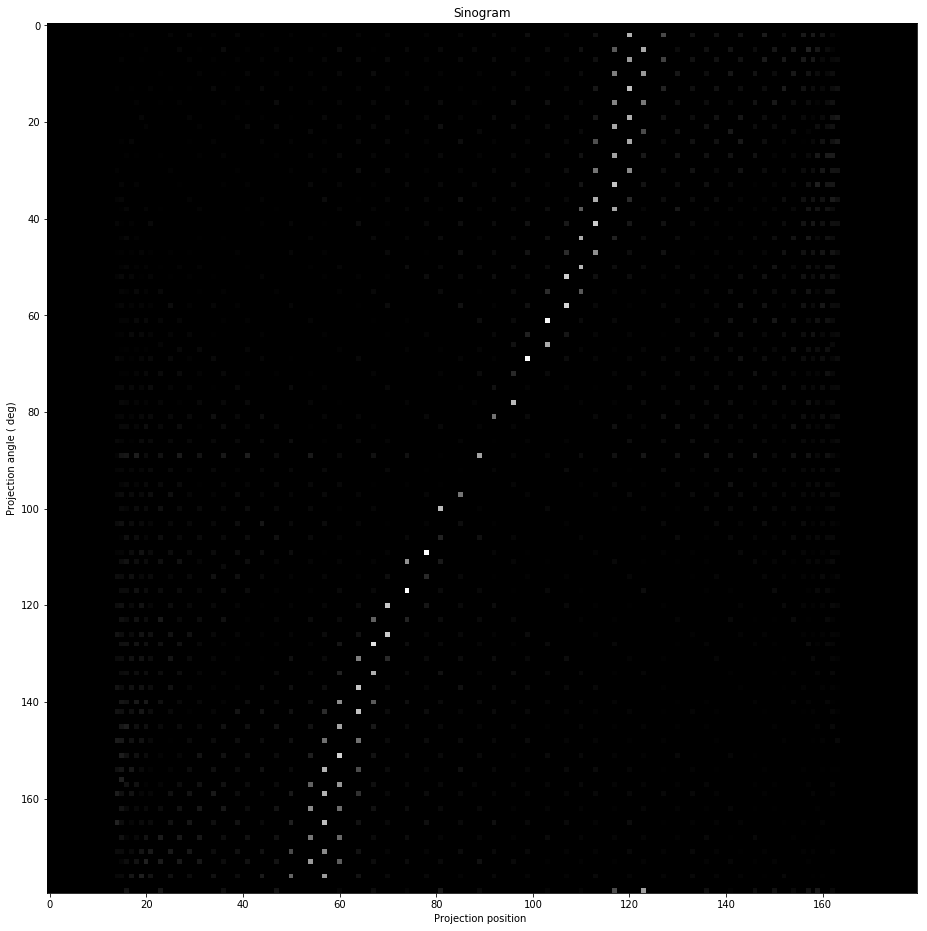

In [36]:
sino1 = drawSinogram(180,180)

0 부터 3 까지의 intensity max값 : 73
3 부터 6 까지의 intensity max값 : 1
6 부터 9 까지의 intensity max값 : 2
9 부터 12 까지의 intensity max값 : 2
12 부터 15 까지의 intensity max값 : 28
15 부터 18 까지의 intensity max값 : 20
18 부터 21 까지의 intensity max값 : 1
21 부터 24 까지의 intensity max값 : 2
24 부터 27 까지의 intensity max값 : 2
27 부터 30 까지의 intensity max값 : 88
30 부터 33 까지의 intensity max값 : 76
33 부터 36 까지의 intensity max값 : 2
36 부터 39 까지의 intensity max값 : 3
39 부터 42 까지의 intensity max값 : 1
42 부터 45 까지의 intensity max값 : 27
45 부터 48 까지의 intensity max값 : 17
48 부터 51 까지의 intensity max값 : 1
51 부터 54 까지의 intensity max값 : 2
54 부터 57 까지의 intensity max값 : 1
57 부터 60 까지의 intensity max값 : 64


ValueError: zero-size array to reduction operation maximum which has no identity

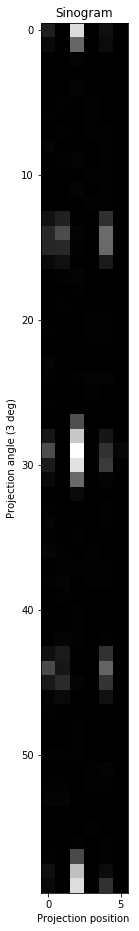

In [53]:
sino5 = drawSinogram(row_step=3,column_step=3)

In [ ]:
sino1.min(), sino1.max()

In [ ]:
sino3.min(), sino3.max()

In [ ]:
sino5.min(), sino5.max()

In [ ]:
plt.figure(figsize=(16, 16))

plt.subplot(1, 3, 1)
plt.imshow(sino1 / sino1.max() , cmap=plt.cm.Greys_r)

plt.subplot(1, 3, 2)
plt.imshow(sino3 / sino3.max(), cmap=plt.cm.Greys_r)

plt.subplot(1, 3, 3)
plt.imshow(sino5 / sino5.max(), cmap=plt.cm.Greys_r)

plt.show()

In [ ]:
np.sum(sino1[-3:, 25])

In [ ]:
sino3[-1, 25]

In [ ]:
sino1[135:, 25:26]

In [ ]:
plt.imshow(sino1[sino1.shape[0] // 2 - 10:sino1.shape[0] // 2 + 10] / sino1.max(), cmap=plt.cm.Greys_r)

In [ ]:
plt.imshow(sino3[sino3.shape[0] // 2 - 3:sino3.shape[0] // 2 + 3] / sino3.max(), cmap=plt.cm.Greys_r)

In [ ]:
plt.imshow(sino5[sino5.shape[0] // 2 - 2:sino5.shape[0] // 2 + 2] / sino5.max(), cmap=plt.cm.Greys_r)

In [ ]:
drawSinogram(7)

In [ ]:
plt.imshow(np.expand_dims(np.sum(sino1[0:3], axis=0), axis=0), cmap=plt.cm.Greys_r)

In [ ]:
plt.imshow(np.expand_dims(np.sum(sino1[180:183], axis=0), axis=0), cmap=plt.cm.Greys_r)

In [ ]:
while True:
    i = 0 
    np.concatenate((np.expand_dims(np.sum(sino1[i:i+1], axis=0), axis=0),np.expand_dims(np.sum(sino1[i+1:i+2], axis=0), axis=0)),axis = 0).shape

In [ ]:
np.sum(sino1[0:7], axis=0)

In [ ]:
sino1 = drawSinogram(1)

In [ ]:
row_step = 3
column_step = 5
r =[]
c = []
for row in range(0, 180, row_step):
    # TODO: concat
    
    sinogram_row_temp = np.sum(sino1[row:row+row_step], axis=0)
    r.append(sinogram_row_temp)

d= np.array(r)
plt.imshow(d, cmap=plt.cm.Greys_r)

In [ ]:
allArrays = np.array([])
for x in range(0, 1000):
    myArray = myFunction(x)
    allArrays = np.concatenate([allArrays, myArray])

In [ ]:
sino1.shape

In [ ]:
row_step = 7
allArrays = np.array([])
for row in range(0, 180, row_step):
    # TODO: concat
    
    sinogram_row_temp = np.expand_dims(np.sum(sino1[row:row+row_step], axis=0), axis=0)
    np.concatenate((np.expand_dims(np.sum(sino1[row:row+row_step], axis=0), axis=0),(np.expand_dims(np.sum(sino1[row+row_step:row+row_step], axis=0), axis=0)),axis = 0)
    print(sinogram_row_temp.shape)

In [ ]:
row_step = 7
for row in range(0, 180):
    # TODO: concat
    
    sinogram_row_temp = np.expand_dims(np.sum(sino1[row:row+1], axis=0), axis=0)



plt.imshow(sinogram_row_temp)

In [ ]:
sinogram_row_temp.max()


In [ ]:
sinogram_row_temp.shape

In [ ]:
allArrays = np.array([])
for x in range(0, 1000):
    myArray = myFunction(x)
    allArrays = np.concatenate([allArrays, myArray])

In [ ]:
column_step = 3
for column in range (0, 90, column_step):
    sinogram_column_temp = np.expand_dims(np.sum(sino1[column : column+column_step],axis = 0),axis = 0)
sinogram_column_temp.shape

In [ ]:
180 / 3

In [ ]:
sino1[179:181, :]

In [ ]:
allArrays = np.array([])
for x in range(0, 1000):
    myArray = myFunction(x)
    allArrays = np.concatenate([allArrays, myArray])

In [ ]:
a= [1,2,3]
b= [1,2,3]
c= []
a.append(b)
a

In [ ]:
sino1 = drawSinogram(1)

In [ ]:
np.sum(sino1[3:10][3:5], axis=0)

In [ ]:
a=1
b= 2
c=3
print("%d 부터 %d 까지의 intensity max값 : %d"%a ,b ,c)